# Stroke Prediction

# Introduction

This project focuses on the [Stroke Prediction Dataset](https://www.kaggle.com/datasets/fedesoriano/stroke-prediction-dataset).\
The objectives are:
- Perform Exploratory Data Analysis to understand the given sample and it's modeling considerations.
- Perform Statistical Inference.
- Model the stroke risk.
- Do a simple deployment of the best model.

Objectives looking through a business-driven lense:
- Create a model for automated alerting within the Electronic Medical Record system.

# Imports

In [1]:
# Standard Library
import warnings
import pickle
import json
from collections import defaultdict
from itertools import combinations
from pprint import pprint
import requests

# Third-Party
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import scipy
import plotly.graph_objects as go
import optuna
from xgboost import XGBClassifier
import xgboost as xgb
from lightgbm import LGBMClassifier
import lightgbm as lgbm

# Scikit-Learn
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import (
    OneHotEncoder, 
    StandardScaler, 
    PolynomialFeatures
)
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.model_selection import (
    GridSearchCV, 
    train_test_split, 
    cross_val_score
)
from sklearn.metrics import (
    classification_report, 
    balanced_accuracy_score, 
    confusion_matrix, 
    make_scorer, 
    average_precision_score
)

# Local
from helpers import plot_custom_scatter
from feature_engineering import MoreThanTwoFeature

warnings.filterwarnings('ignore')

custom_params = {
    "axes.spines.right": False,
    "axes.spines.top": False,
}

sns.set_theme(context="notebook", style="whitegrid", rc=custom_params)

In [2]:
df = pd.read_csv('stroke_data.csv')

In [3]:
df.head(1)

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,9046,Male,67.0,0,1,Yes,Private,Urban,228.69,36.6,formerly smoked,1


In [4]:
df.describe()

,id,age,hypertension,heart_disease,avg_glucose_level,bmi,stroke
count,5110.000000,5110.000000,5110.000000,5110.000000,5110.000000,4909.000000,5110.000000
mean,36517.829354,43.226614,0.097456,0.054012,106.147677,28.893237,0.048728
std,21161.721625,22.612647,0.296607,0.226063,45.283560,7.854067,0.215320
min,67.000000,0.080000,0.000000,0.000000,55.120000,10.300000,0.000000
25%,17741.250000,25.000000,0.000000,0.000000,77.245000,23.500000,0.000000
50%,36932.000000,45.000000,0.000000,0.000000,91.885000,28.100000,0.000000
75%,54682.000000,61.000000,0.000000,0.000000,114.090000,33.100000,0.000000
max,72940.000000,82.000000,1.000000,1.000000,271.740000,97.600000,1.000000


We have a minimum value for age of 0.08. There is definitely something strange going on. However, we will return to this later.

So it seems that we have both numeric and categorical features in our dataset:
Numeric:
- age
- avg_glucose_level
- bmi

Categorical:
- id
- gender
- hypertension
- heart_disease
- ever_married
- work_type
- Residence_type
- smoking_status
- stroke(target)

In [5]:
nums = ['age', 'avg_glucose_level', 'bmi']
cats = [col for col in df.columns if (col not in nums and col != 'id')]

# Data Validation

## Duplicates

In [6]:
df.duplicated().any()

np.False_

In [7]:
df.id.duplicated().any()

np.False_

## Missing Values

In [8]:
pd.DataFrame(df.isna().sum()).T

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
0,0,0,0,0,0,0,0,0,0,201,0,0


'bmi' contains 201 missing values.

## Outliers

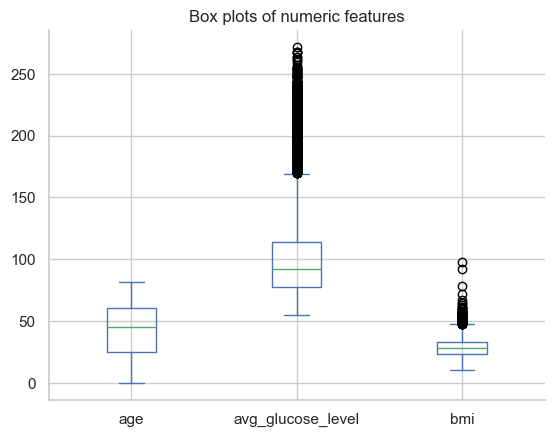

In [9]:
df[nums].plot(kind='box', title='Box plots of numeric features');

We see that average glucose level and bmi contain quite a few outliers.

# EDA

## Basic categorical variable exploration

Unique categories:

In [10]:
for col in df[cats]:
    print('\n')
    print(f'{col}:')
    print(df[col].unique())



gender:
['Male' 'Female' 'Other']


hypertension:
[0 1]


heart_disease:
[1 0]


ever_married:
['Yes' 'No']


work_type:
['Private' 'Self-employed' 'Govt_job' 'children' 'Never_worked']


Residence_type:
['Urban' 'Rural']


smoking_status:
['formerly smoked' 'never smoked' 'smokes' 'Unknown']


stroke:
[1 0]


## Proportions of Categories

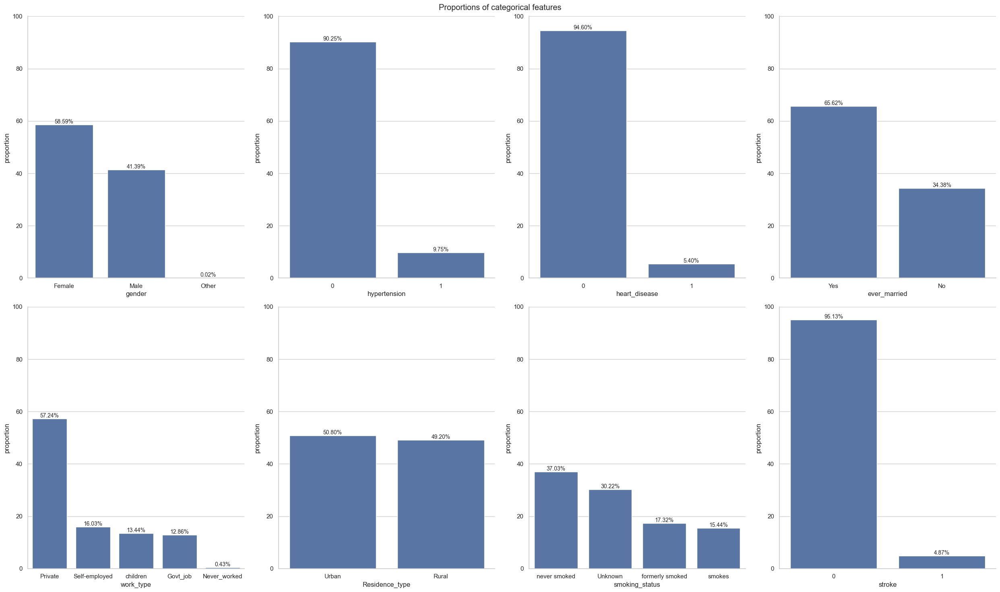

In [11]:
fig, axs = plt.subplots(2, 4, figsize=(25,15))
axs_flat = axs.flatten()

for ax, cat in zip(axs_flat, cats):
    sns.barplot((df[cat]
                 .value_counts(normalize=True)
                 .mul(100)),
                ax=ax)
    ax.set_ylim(0,100)
    ax.bar_label(ax.containers[0], fontsize=10, fmt='%.2f%%');

plt.suptitle('Proportions of categorical features')
plt.tight_layout()

- High class imbalance in the target variable.
- work_type variable contains very few instances of unemployed people if not considering children.
- Relatively few individuals had heart disease.

## Distributions of numerical features

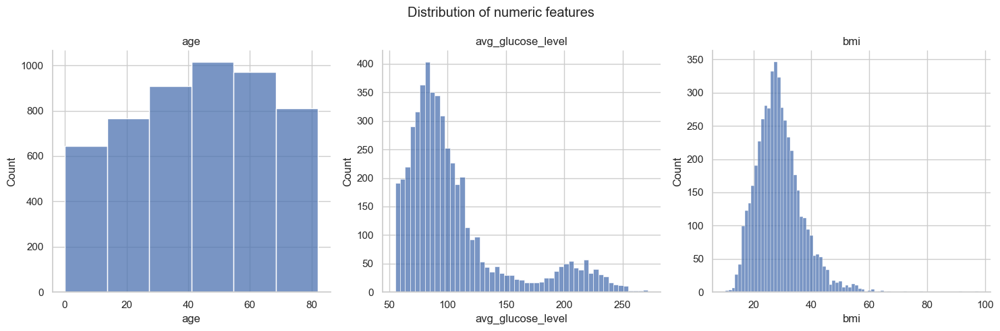

In [12]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))
count = 0
for i, (ax, feat) in enumerate(zip(axs.flatten(), nums)):
    if i == 0:
        sns.histplot(df[feat], ax=ax, bins=6)
    else:
        sns.histplot(df[feat], ax=ax)
    ax.set_title(feat)
        

plt.suptitle('Distribution of numeric features')
plt.tight_layout()

Observations:
- Age: There is a higher saturation of older population in the dataset.
- Avg_glucose_level: Multimodal distibution. There seems to be 2 different populations present in this dimension. 170 to 250 mg/dL range might consist of individuals with pre-diabetes or diabetes. This range might have a higher risk of stroke compared to the other mode.
- BMI: Somewhat bell-shaped, slightly right-skewed distribution with mean BMI of around 28.8, which is very close to the obesity threshold (30).

We saw that the age column has some values with decimal places for low ages. We want to know whether these values are specified correctly or if we should do some additional corrections based on other features.

In [13]:
df[df['age'] % 1 != 0].head(5)

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke
162,69768,Female,1.32,0,0,No,children,Urban,70.37,NaN,Unknown,1
363,7559,Female,0.64,0,0,No,children,Urban,83.82,24.9,Unknown,0
376,22706,Female,0.88,0,0,No,children,Rural,88.11,15.5,Unknown,0
562,45238,Female,1.80,0,0,No,children,Urban,58.26,16.5,Unknown,0
564,61511,Female,0.32,0,0,No,children,Rural,73.71,16.2,Unknown,0


Okay, so we see that the decimal places in the age column could mean the proportion of the year for under 2 year olds. For example we see no hypertension, stroke, heart diseases etc. Therefore, it does seem that the data is correct.

It also seems that work_type = children is reserved for children records. Let's see if there are older people with this work type.

In [14]:
df[(df['work_type'] == 'children') & (df['age'] >= 18)]

,id,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status,stroke


## Correlation of numeric variables

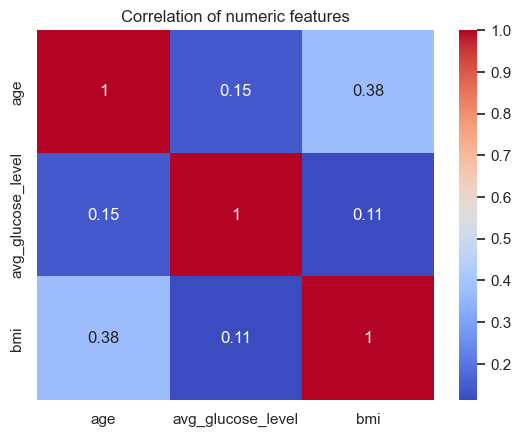

In [15]:
ax = sns.heatmap(df[nums].corr('spearman'), annot=True, cmap='coolwarm')
ax.set_title('Correlation of numeric features');

We see weak correlations between the features.

## Correlation of numeric features and the target variable

We will use point-biserial correlation for linear relationship between binary and continuous variables.

In [16]:
results = defaultdict(list)
df_no_na = df.drop(df[df['bmi'].isna()].index)

for feat in nums:
    r, p = scipy.stats.pointbiserialr(df_no_na['stroke'], df_no_na[feat])
    results['feature'].append(feat)
    results['r'].append(r)
    results['p'].append(p)

results_df = pd.DataFrame(results)
results_df

,feature,r,p
0,age,0.232331,3.655693e-61
1,avg_glucose_level,0.138936,1.379969e-22
2,bmi,0.042374,2.983269e-03


- Weak linear relationship between the target and numeric features.
- There are some considerations when it comes to p-values. The normality assumptions don't hold for age and average_glucose_level features. However, the n is large enough for CLT to take effect.

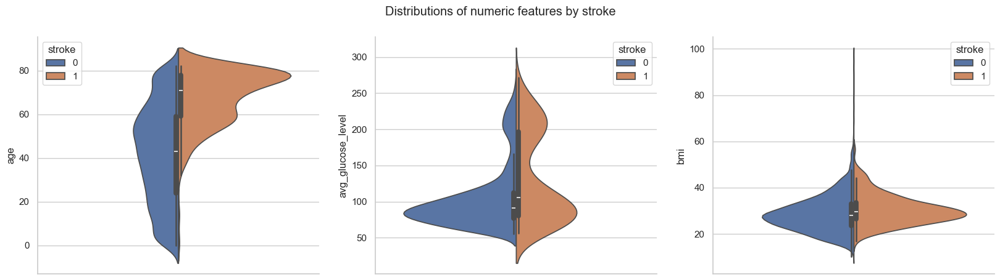

In [17]:
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 5))
sns.violinplot(data=df, hue='stroke', y='age', split=True, ax=ax1, common_norm=True)
sns.violinplot(data=df, hue='stroke', y='avg_glucose_level', split=True, ax=ax2, common_norm=True)
sns.violinplot(data=df, hue='stroke', y='bmi', split=True, ax=ax3, common_norm=True)
plt.suptitle('Distributions of numeric features by stroke');

- We see an evident trend when it comes to age. From the age of around 40, the stroke risks in this sample increase fast.
- BMI only has a very slight influence on average, but there seems to be a bulge around the outliers.
- Glucose levels seem to increase starker in the upper mode, where the level surpasses the pre-diabetes/diabetes threshold. Still, the proportions might not be accurately represented by the plot.

Isolating the upper/right mode of glucose level distribution:

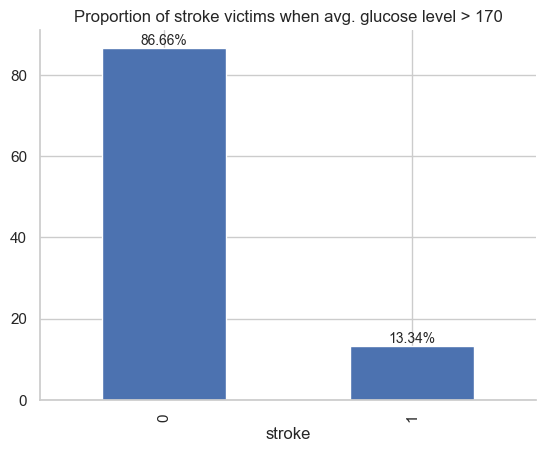

In [18]:
ax = (df[df['avg_glucose_level'] > 170]['stroke']
 .value_counts(normalize=True)
 .mul(100)
 .plot(kind='bar')
)
ax.bar_label(ax.containers[0], fontsize=10, fmt='%.2f%%')
ax.set_title('Proportion of stroke victims when avg. glucose level > 170');

It does seem that the stroke ratio for the second mode is nearly three times higher than the ratio for the whole distribution.

# Categorical variables and the target

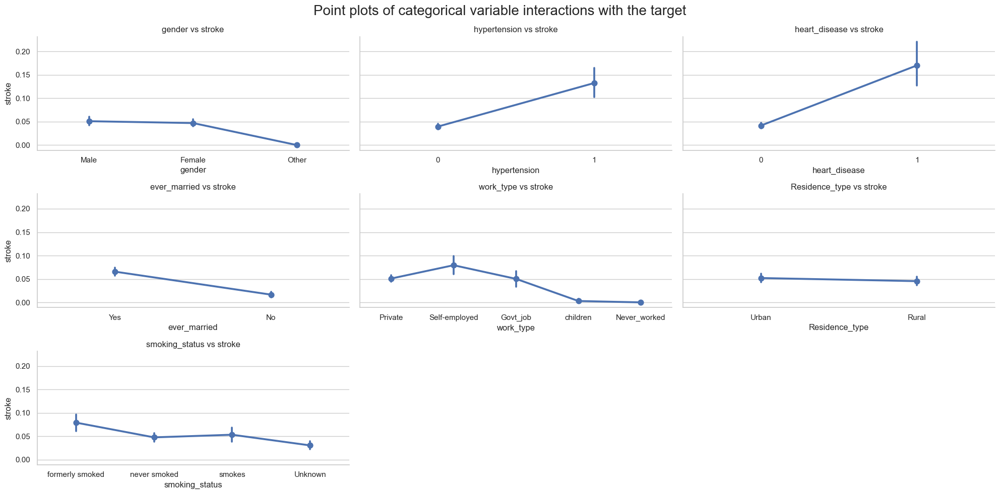

In [19]:
fig, axs = plt.subplots(3, 3, figsize=(20, 10), sharey=True)
axs_flat = axs.flatten()

for ax, col in zip(axs_flat, cats[:-1]):
    sns.pointplot(data=df, x=col, y='stroke', ax=ax)
    ax.set_title(f'{col} vs stroke')
    ax.set_xlabel(col)
    ax.set_ylabel('stroke')

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)

plt.suptitle('Point plots of categorical variable interactions with the target', fontsize=20)
plt.tight_layout()

We observe:
- Men are slightly more likely to be stroke victims compared to women. Though, the confidence intervals for both overlap.
- Hypertension and heart diseases seem to increase the risk of stroke substantially. However, a confounding variable could affect both of these variables.
- Married people seem to be more likely to experience stroke. However, a confounding variable (such as age) could correlate with whether or not a person is married.
- We see that self-employed individuals seem to be more likely to be stroke victims.
- Urban residents seem to be more likely to be stroke victims. However, confidence intervals overlap.
- People who formerly smoked seem to have the most significant risk of stroke, even compared to people who currently smoke.

# Multiple interactions with the target variable

In [72]:
def plot_x_y_vs_stroke(feat1, feat2, ax):
    sns.pointplot(data=df, x=feat1, y='stroke', hue=feat2, ax=ax)
    ax.set_title(f'{feat1} and {feat2} vs. stroke')
    ax.set_ylim(0,1)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=45)

age_labels = ['Very Young', 'Young', 'Early Middle-Aged', 'Middle-Aged', 'Older', 'Senior', 'Very Senior', 'Elderly']
df['age_bin'] = pd.cut(df['age'], bins=8, labels=age_labels, precision=0)

bmi_labels = ['Underweight', 'Normal', 'Overweight', 'Obese', 'Very Obese', 'Extremely Obese']
df['bmi_bin'] = pd.cut(df['bmi'], bins=6, labels=bmi_labels, precision=0)

agl_labels = ['Low', 'Moderate', 'High', 'Very High']
df['agl_bin'] = pd.cut(df['avg_glucose_level'], bins=4, labels=agl_labels, precision=0)

nums_bin = ['age_bin', 'bmi_bin', 'agl_bin']

combs = [i for i in combinations([*nums_bin, *cats[:-1]], 2)]

## Age

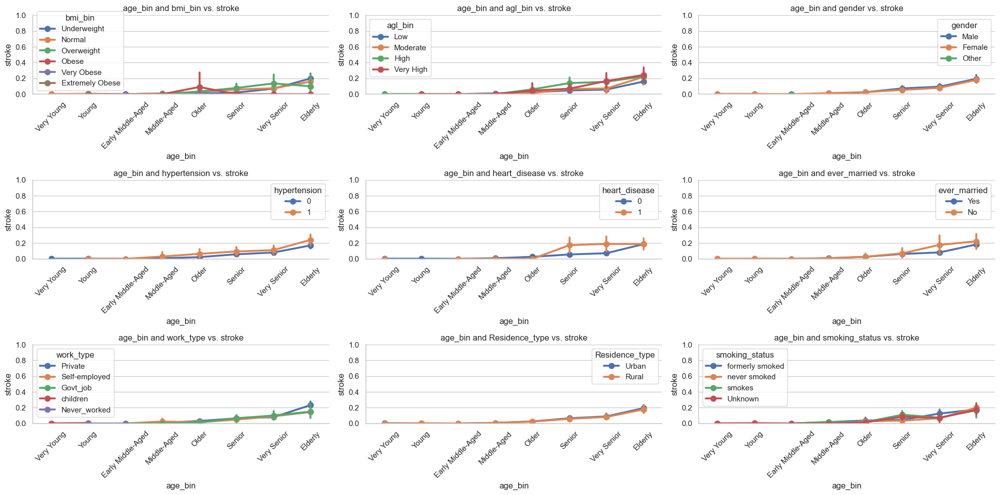

In [73]:
fig, axs = plt.subplots(3, 3, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[:9]):
    plot_x_y_vs_stroke(feature1, feature2, ax)
plt.tight_layout()

- Age and BMI: It does seem that BMI is associated positively with higher risks of stroke across all age groups. We see that, for example, sample within a healthy bmi bound only experiences stark rise in risk in very old ages.
- Age and Average Glucose Levels: Elevated glucose levels seem to be associated with earlier onsets of stroke and stroke risk in general.
- Age and Gender: We see a pretty much identical pattern for both genders across all ages.
- Age and Hypertension: We observe that having hypertension increases risk of stroke starting from the age of around 40.
- Age and Heart Disease: We see that having heart disease seems to be associated with an increased risk of stroke for age groups starting at around 50.
- Age and Marriage Status: We see that in later ages it seems that being married is associated with a lower risk of stroke. On the other hand, we see that confidence interval for no group overlaps with the point estimate of yes group.
- Age and Work Type: We notice that private sector workers seem to exhibit higher rates of stroke for the oldest individuals in the sample.
- Age and Residence Type: The trend seems similar for both residence types across all age groups.
- Age and Smoking Status: We see that both currently smoking and having smoked seems to be associated with earlier risks of stroke. For the currently smoking participants the association is stronger.

## BMI

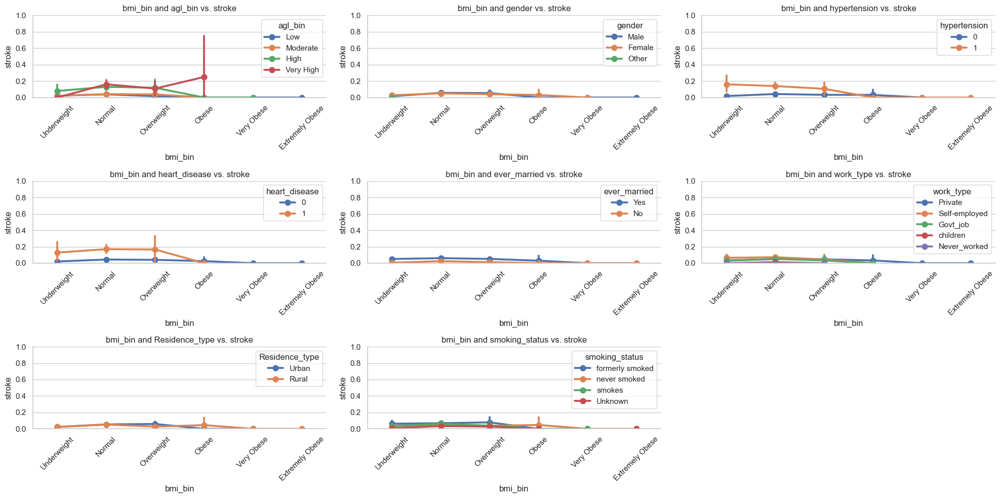

In [74]:
fig, axs = plt.subplots(3, 3, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[9:17]):
    plot_x_y_vs_stroke(feature1, feature2, ax)

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)


plt.tight_layout()

## Average glucose level

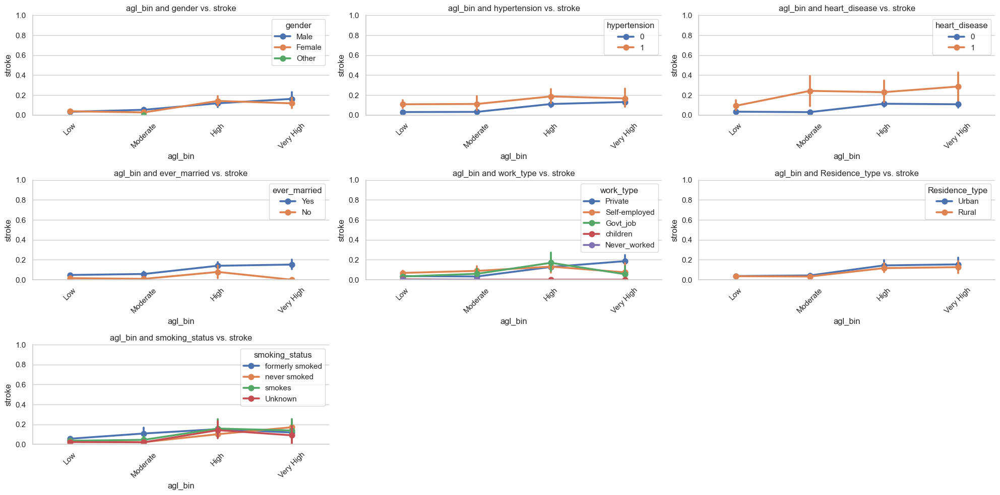

In [75]:
fig, axs = plt.subplots(3, 3, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[17:24]):
    plot_x_y_vs_stroke(feature1, feature2, ax)

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)


plt.tight_layout()

## Gender

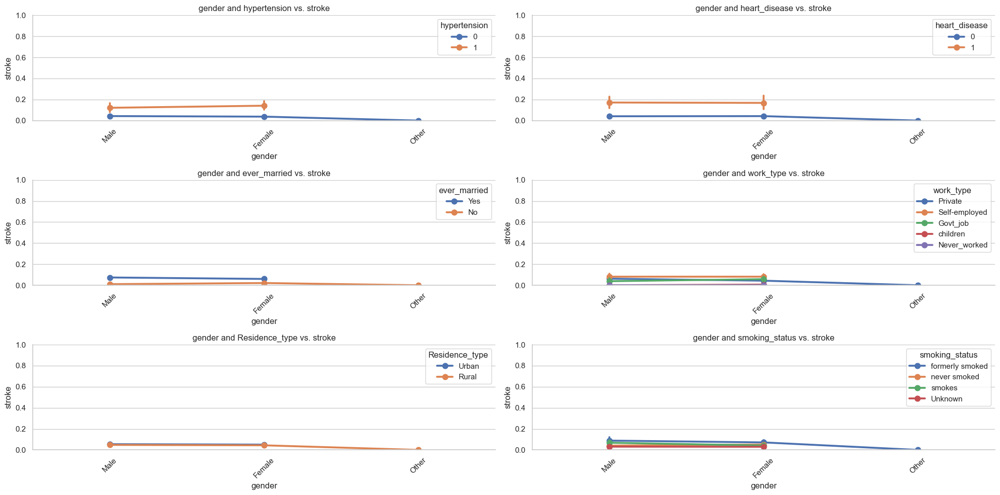

In [76]:
fig, axs = plt.subplots(3, 2, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[24:31]):
    plot_x_y_vs_stroke(feature1, feature2, ax)

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)


plt.tight_layout()

## Hypertension

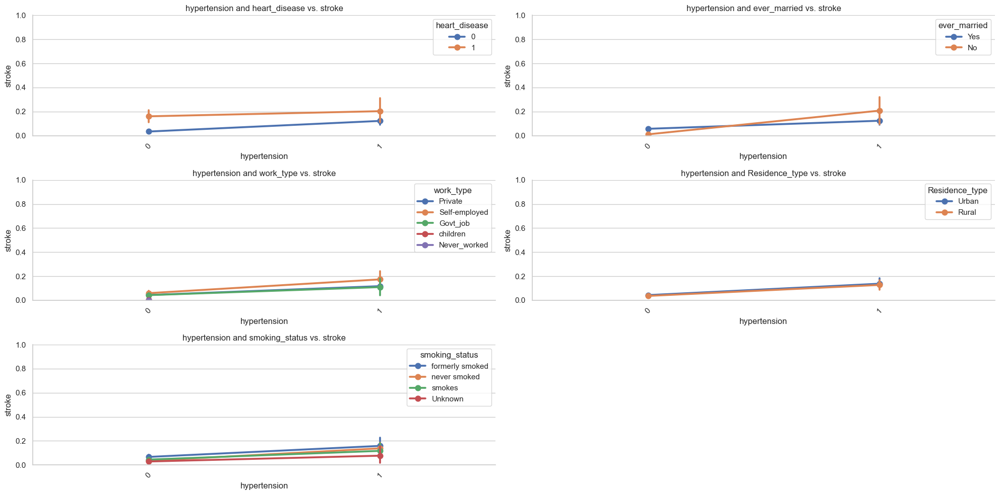

In [77]:
fig, axs = plt.subplots(3, 2, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[30:35]):
    plot_x_y_vs_stroke(feature1, feature2, ax)

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)


plt.tight_layout()

## Heart disease

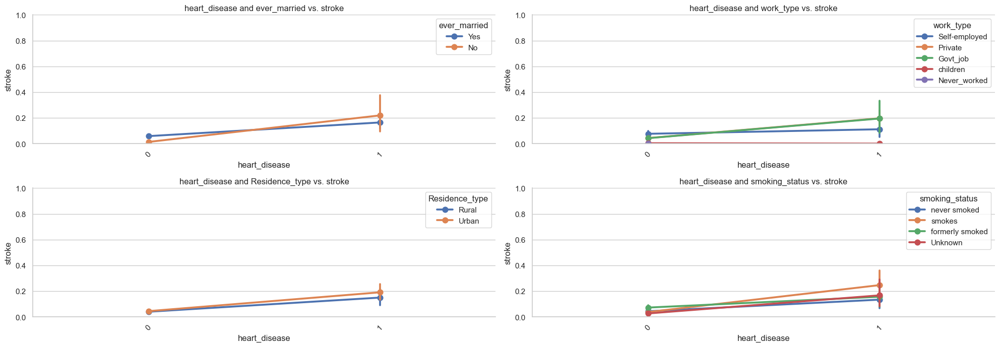

In [78]:
fig, axs = plt.subplots(3, 2, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[35:39]):
    plot_x_y_vs_stroke(feature1, feature2, ax)

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)


plt.tight_layout()

## Marriage status, work type and residence type

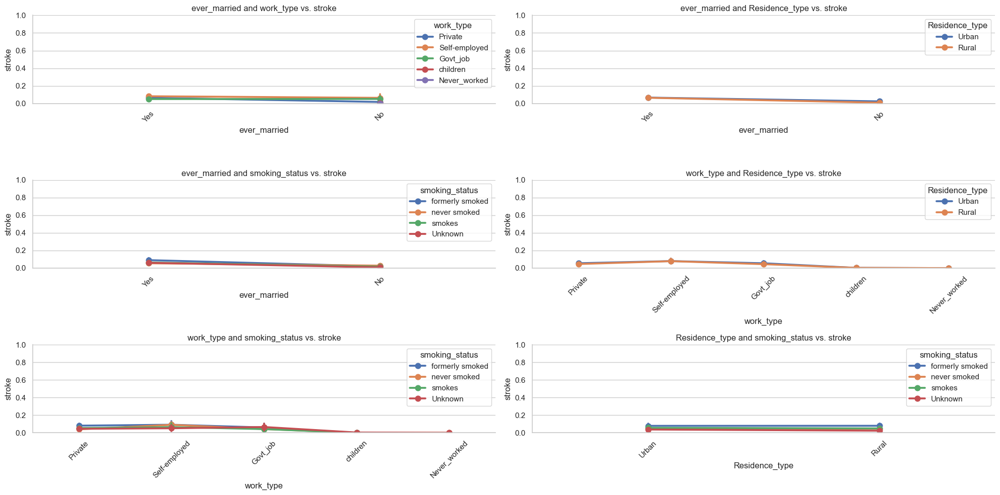

In [79]:
fig, axs = plt.subplots(3, 2, figsize=(20,10))
axs_flat = axs.flatten()
for ax, (feature1, feature2) in zip(axs_flat, combs[39:]):
    plot_x_y_vs_stroke(feature1, feature2, ax)

for ax in axs_flat:
    if not ax.has_data():
        ax.set_visible(False)


plt.tight_layout()

## Granular look into numerical features

We would like a more granular and intuitive understanding of how the points lie.

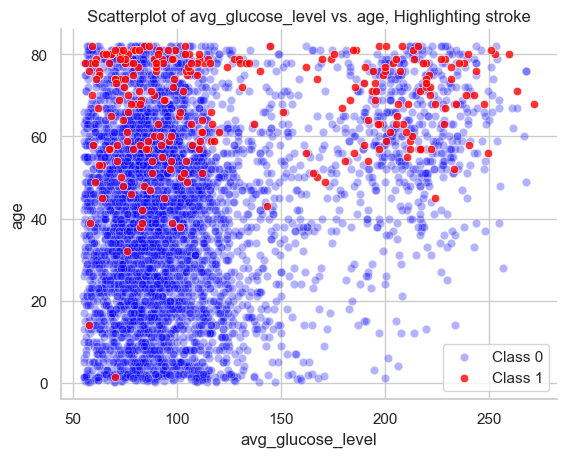

In [28]:
plot_custom_scatter(data=df, x='avg_glucose_level', y='age', hue_column='stroke')

- Age seems to be a standalone better predictor of stroke. However, there does seem to be a higher relative density of stroke for the same age with an increase in glucose levels.

In [29]:
print(df[(df['age'] > 40) & (df['avg_glucose_level'] > 140)]['stroke'].mean())

0.14263803680981596


In [30]:
print(df[(df['age'] > 40) & (df['avg_glucose_level'] < 140)]['stroke'].mean())

0.06684733514001806


So we see that these two variables do seem to interact.

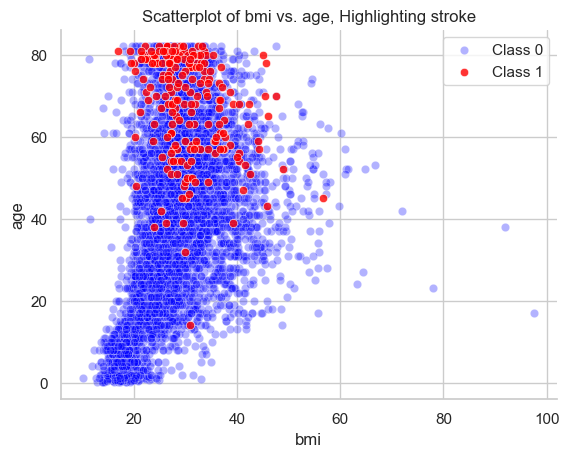

In [31]:
plot_custom_scatter(data=df, x='bmi', y='age', hue_column='stroke')

- Doesn't seem like there is a particularly strong interaction between these two variables. However, stroke instances for 40-60 range seem to have a larger mean bmi compared to 60-80 range.

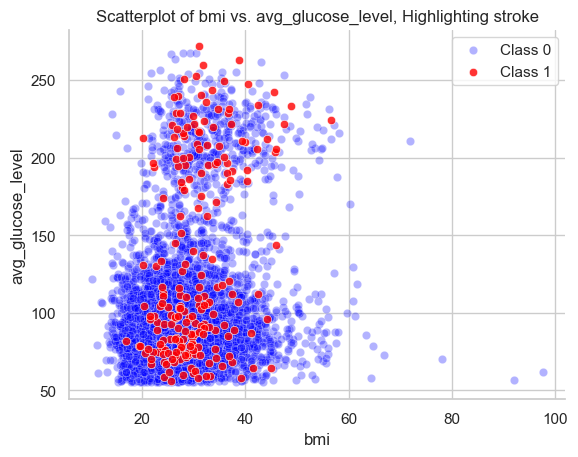

In [32]:
plot_custom_scatter(data=df, x='bmi', y='avg_glucose_level', hue_column='stroke')

In [33]:
df['stroke_cat'] = np.where(df['stroke'] == 1, 'stroke', 'no stroke')

fig = go.Figure()

fig.add_trace(go.Scatter3d(
    x=df[df['stroke_cat'] == 'no stroke']['age'],
    y=df[df['stroke_cat'] == 'no stroke']['bmi'],
    z=df[df['stroke_cat'] == 'no stroke']['avg_glucose_level'],
    mode='markers',
    marker=dict(size=5, color='lightgray', opacity=0.3), 
    name='No Stroke'
))

fig.add_trace(go.Scatter3d(
    x=df[df['stroke_cat'] == 'stroke']['age'],
    y=df[df['stroke_cat'] == 'stroke']['bmi'],
    z=df[df['stroke_cat'] == 'stroke']['avg_glucose_level'],
    mode='markers',
    marker=dict(size=5, color='red', opacity=1.0),
    name='Stroke'
))

fig.update_layout(
    scene=dict(
        xaxis_title='Age',
        yaxis_title='BMI',
        zaxis_title='Avg Glucose Level'
    ),
    title='Interactive 3D Scatter Plot - Stroke vs No Stroke',
    width=1200,
    height=800
)

fig.show()


In [34]:
df.drop('stroke_cat', axis=1, inplace=True)

We can see that just across these 3 dimensions we are already able to segment the data pretty well. It seems like these should be our most promissing features.

# Inference

During the analysis, we closely examined the relationship between various variables and the target. We will continue this examination in a more statistically rigorous manner using hypothesis testing.

# Testing categorical variables

We will first test for categorical variable population association with the target.\
For this we will use the $\chi^2$ test which is specified as:

$$H_0: \text{There is no significant association between categorical variables}$$
$$\alpha = 0.05$$

## Assumptions

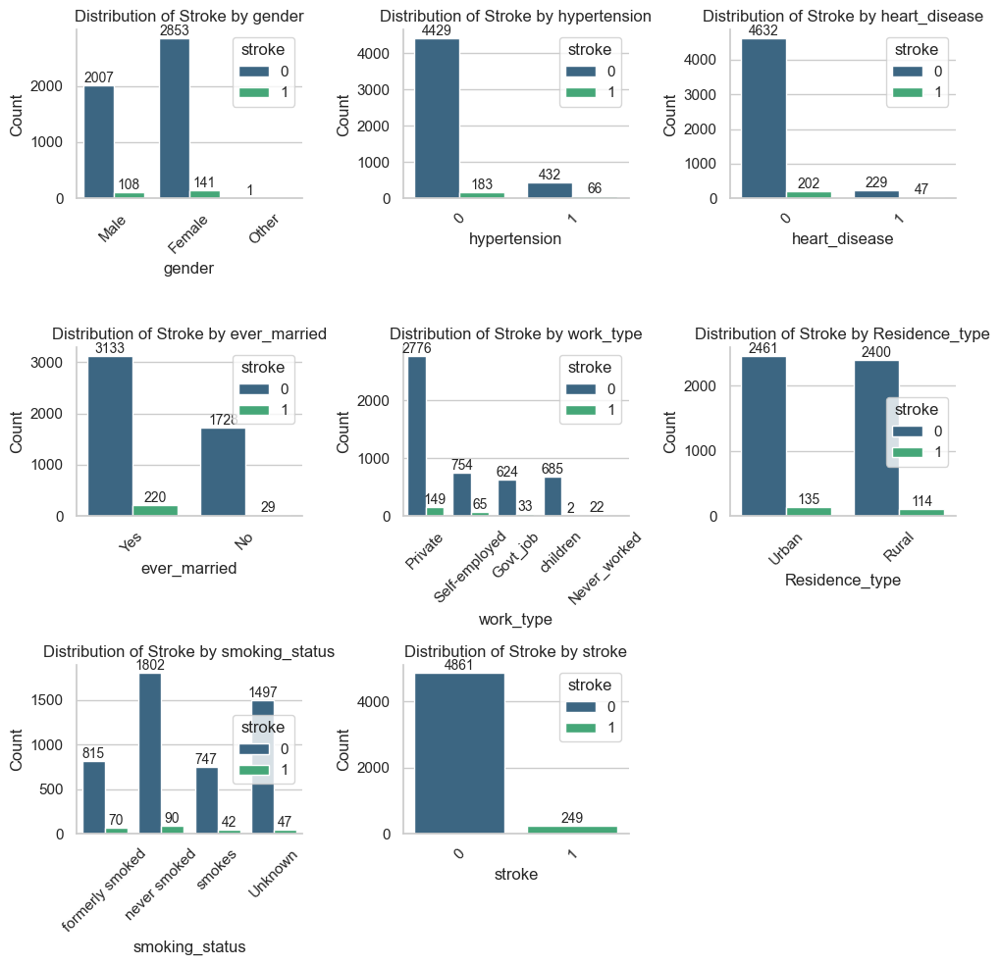

In [35]:
def plot_stroke_against_cat(df):
    fig, axs = plt.subplots(3, 3, figsize=(10, 10))
    axs_flat = axs.flatten()
    
    for ax, feature in zip(axs_flat, cats):
        sns.countplot(x=feature, hue='stroke', data=df, palette='viridis', ax=ax)
        ax.set_title(f'Distribution of Stroke by {feature}')
        ax.set_xlabel(feature)
        ax.set_ylabel('Count')
        ax.legend(title='stroke')
        
        if ax.containers:
            ax.bar_label(ax.containers[0], fontsize=10)
            if len(ax.containers) > 1:
                ax.bar_label(ax.containers[1], fontsize=10)
        
        ax.tick_params(axis='x', rotation=45)
    
    for ax in axs_flat:
        if not ax.has_data():
            ax.set_visible(False)
    
    plt.tight_layout()
    plt.show()
    
plot_stroke_against_cat(df)

- We will drop gender = 'Other' and work_type = 'children' and 'Never_worked' because keeping them would violate sample size assumptions of the test. Therefore, now we are reframing the test with these adjustments in mind.

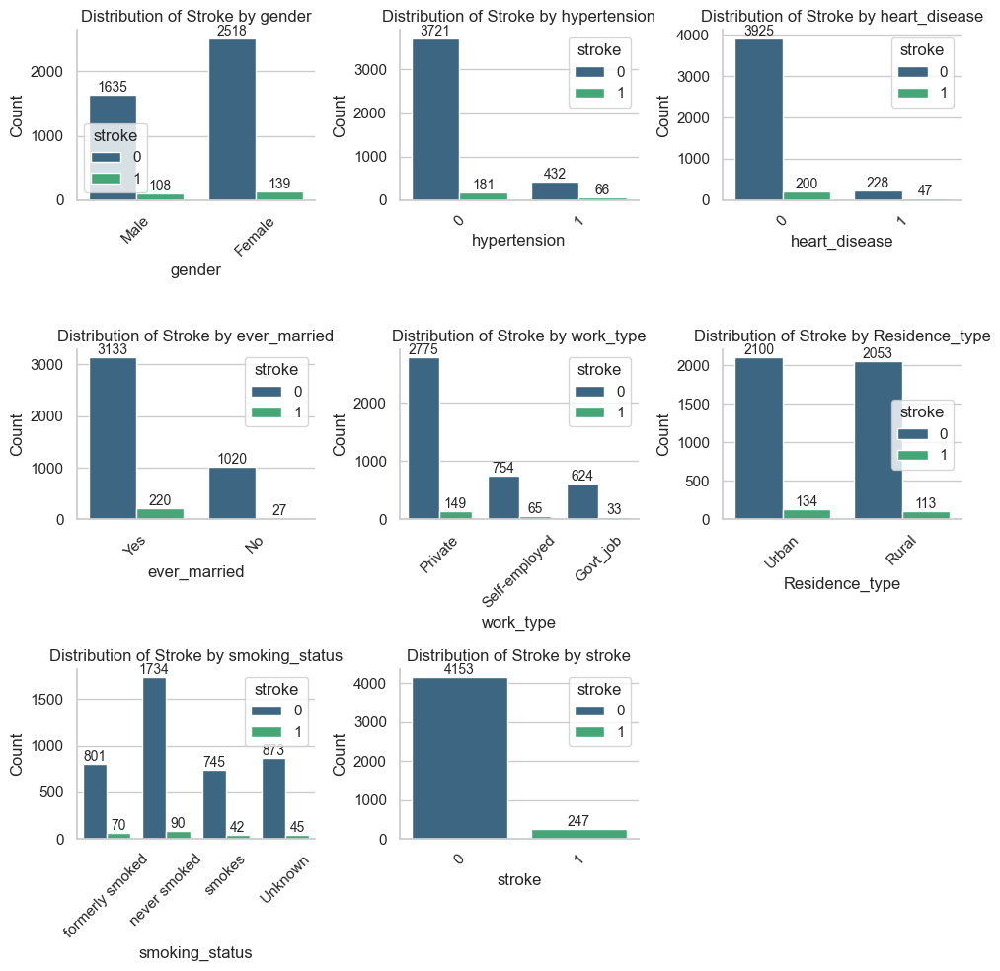

In [36]:
to_dr_idx = (df[(df['gender'] == 'Other') 
             | (df['work_type']
                .isin(['children', 'Never_worked']))]
             .index
            )
test_df = df.drop(to_dr_idx).copy()

plot_stroke_against_cat(test_df)

**Assumption Summary**:

- Random Sample ❓
- Independence of Observations ✅
- Sample Size (at least 5 examples in the contingency table) ✅
- Categorical Data ✅

In [37]:
from scipy.stats import chi2_contingency

thresh_adj = 0.05 / 10 # Bonferroni correction to control for Type 1 errors (p value is divided by the total number of tests performed)

print('\n')
for feature in cats[:-1]:
    chi2, p, dof, expected = chi2_contingency(
        pd.crosstab(test_df['stroke'], test_df[feature]))
    print(f'p_value: {p}')
    if p < thresh_adj:
        print(f'✅ We REJECT the H0 for feature: {feature}')
    else:
        print(f'❌ We DON\'T REJECT the H0 for feature: {feature}')
    print('__________________________________________________________')
    print('\n')



p_value: 0.1960850122997037
❌ We DON'T REJECT the H0 for feature: gender
__________________________________________________________


p_value: 8.408227156510688e-15
✅ We REJECT the H0 for feature: hypertension
__________________________________________________________


p_value: 4.2998782981110575e-17
✅ We REJECT the H0 for feature: heart_disease
__________________________________________________________


p_value: 1.508588833281755e-06
✅ We REJECT the H0 for feature: ever_married
__________________________________________________________


p_value: 0.005936862153890858
❌ We DON'T REJECT the H0 for feature: work_type
__________________________________________________________


p_value: 0.28915057753882667
❌ We DON'T REJECT the H0 for feature: Residence_type
__________________________________________________________


p_value: 0.006628238628310846
❌ We DON'T REJECT the H0 for feature: smoking_status
__________________________________________________________




Given our sample and p value it seems that:

- hypertension, heart_disease and ever_married carry a statistically significant relationship to the target.
- gender and work_type, Residence_type, smoking_status seemingly do not carry a statistically significant relationship to the target.

**NOTE**: We are using a very conservative p-value threshold due to the Bonferroni correction.

## Testing numeric variables

Now we will proceed with numeric variables. Normally we would use the two independent group T test for this purpose, however, in the analysis we saw that the distributions of our numeric samples are not normal. Because of this we opt for a non-parametric test.\
We will use **Mann-Whitney U test** which is specified as:

$$H_0: \text{The distributions of the two groups are equal}$$
$$\alpha = 0.05$$

- Radom Sample ❓
- Independence ✅
- Ordinal or Continuous Data ✅
- Distribution Shape ✅
- Sample Sizes ✅

**NOTE**: We will omit a great deal of missing values for the BMI test.

In [38]:
from scipy.stats import mannwhitneyu
print('\n')
for feature in nums:
    
    group1 = test_df[test_df['stroke'] == 0][feature]
    group2 = test_df[test_df['stroke'] == 1][feature]

    u_stat, p = mannwhitneyu(group1, group2, nan_policy='omit')
    print(f'p-value = {p}')
    if p < thresh_adj:
        print(f'✅ We REJECT the H0 for feature: {feature}')
    else:
        print(f'❌ We DON\'T REJECT the H0 for feature: {feature}')
    print('__________________________________________________________')
    print('\n')



p-value = 9.204769135559366e-62
✅ We REJECT the H0 for feature: age
__________________________________________________________


p-value = 8.986037138499218e-09
✅ We REJECT the H0 for feature: avg_glucose_level
__________________________________________________________


p-value = 0.3247132001931631
❌ We DON'T REJECT the H0 for feature: bmi
__________________________________________________________




Given the sample and the p value we see that:

- age and avg_glucose_level carry a statistically significat relationship to the target.
- bmi does not seem to carry a statistically significat relationship to the target.

# Modeling

**Note**:\
During this project, we will narrow our scope to tree-based ensemble models: Random Forest, LightGBM and XGBoost.

## Choosing the performance metric

So we want a sort of a model that would not miss patients who have stroke risk, yet, that would not raise so many false positives that it would make it impractical to use. For this reason, we will optimize for PR AUC for hyper-parameter search and use F1, balanced accuracy and per class accuracy to evaluate the models.

## Missing values

In [39]:
df.drop(['age_bin', 'bmi_bin', 'agl_bin'], axis=1, inplace=True)

In [40]:
len(df[(df.bmi.isna()) & (df.stroke == 1)]) / len(df[df.stroke == 1])

0.1606425702811245

By dropping the BMI we would drop 16% of the rare class 1 for stroke. Therefore, we need to figure out an imputation strategy

First let's split the data into train and test:

In [41]:
from sklearn.model_selection import train_test_split

In [42]:
y = df['stroke'].copy()
X = df.drop(['stroke', 'id'], axis=1).copy()

In [43]:
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.2, random_state=42,
                                                   stratify=y)

Baseline for PR AUC:

In [44]:
sum(y_train == 1) / len(y_train)

0.04867906066536203

In [45]:
def confusion(model_object, X_train, y_train, grid=True):
    if grid:
        best_model = model_object.best_estimator_
    else:
        best_model = model_object
    y_pred = best_model.predict(X_train)
    
    cm = confusion_matrix(y_train, y_pred)
    
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title('Confusion Matrix')
    plt.show()

def report(model, X, y):
    prediction = model.predict(X)
    print(f'The test accuracy score of the best model is {model.score(X, y):.2f}')
    print(f'The test balanced accuracy score of the best model is {balanced_accuracy_score(y, prediction):.2f}')
    print('\n')
    pprint(classification_report(y, prediction))

In [46]:
def average_precision_scorer(y_true, y_pred):
    return average_precision_score(y_true, y_pred)

In [47]:
def optimize_xgb_with_preprocessor(preprocessor, X_train, y_train, n_trials=300, feature_engineering=None):
    
    def objective(trial):
        n_estimators = trial.suggest_int('n_estimators', 10, 300)
        learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3)
        max_depth = trial.suggest_int('max_depth', 1, 30)
        min_child_weight = trial.suggest_int('min_child_weight', 1, 7)
        subsample = trial.suggest_float('subsample', 0.1, 1.0)
        colsample_bytree = trial.suggest_float('colsample_bytree', 0.2, 1.0)
        gamma = trial.suggest_float('gamma', 0, 1)

        scale_pos_weight = sum(y_train == 0) / sum(y_train == 1)  # XGBoost recommendation for imbalanced classes

        xgboost = XGBClassifier(
            objective='binary:logistic',
            missing=np.nan,
            seed=42,
            eval_metric='aucpr',
            scale_pos_weight=scale_pos_weight,
            n_estimators=n_estimators,
            learning_rate=learning_rate,
            max_depth=max_depth,
            min_child_weight=min_child_weight,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            gamma=gamma
        )
        
        steps = []
        if feature_engineering is not None:
            steps.append(('feature_engineering', feature_engineering))
        
        steps.append(('preprocessor', preprocessor))
        steps.append(('clf', xgboost))
        
        xgb_pipeline = Pipeline(steps)
        
        cv_scores = cross_val_score(xgb_pipeline, X_train, y_train, cv=5, scoring=make_scorer(average_precision_scorer))
        return np.mean(cv_scores)
    
    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials=n_trials, n_jobs=-1)

    return study

def optimize_lgb_with_preprocessor(preprocessor, X_train, y_train, n_trials=300, feature_engineering=None):
    
    def objective(trial):
        boosting_type = trial.suggest_categorical('boosting_type', ['gbdt', 'dart', 'goss'])
        n_estimators = trial.suggest_int('n_estimators', 10, 300)
        learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3)
        max_depth = trial.suggest_int('max_depth', 1, 30)
        num_leaves = trial.suggest_int('num_leaves', 2, 256)
        min_child_samples = trial.suggest_int('min_child_samples', 1, 100)
        subsample = trial.suggest_float('subsample', 0.1, 1.0)
        colsample_bytree = trial.suggest_float('colsample_bytree', 0.2, 1.0)
        reg_alpha = trial.suggest_float('reg_alpha', 0.0, 1.0)
        reg_lambda = trial.suggest_float('reg_lambda', 0.0, 1.0)

        lgb = lgbm.LGBMClassifier(
            boosting_type=boosting_type,
            objective='binary',
            n_estimators=n_estimators,
            learning_rate=learning_rate,
            max_depth=max_depth,
            num_leaves=num_leaves,
            min_child_samples=min_child_samples,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            reg_alpha=reg_alpha,
            reg_lambda=reg_lambda,
            is_unbalance=True,
            random_state=42
        )
        
        steps = []
        if feature_engineering is not None:
            steps.append(('feature_engineering', feature_engineering))
        steps.append(('preprocessor', preprocessor))
        steps.append(('clf', lgb))
        
        lgb_pipeline = Pipeline(steps)
        cv_scores = cross_val_score(lgb_pipeline, X_train, y_train, cv=5, scoring=make_scorer(average_precision_scorer))
        return np.mean(cv_scores)
        
    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials=n_trials, n_jobs=-1)

    return study

def optimize_rf_with_preprocessor(preprocessor, X_train, y_train, n_trials=300):
    
    def objective(trial):
        n_estimators = trial.suggest_int('n_estimators', 10, 300)
        max_depth = trial.suggest_int('max_depth', 1, 30)
        min_samples_split = trial.suggest_int('min_samples_split', 2, 20)
        min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 20)
        max_features = trial.suggest_categorical('max_features', ['sqrt', 'log2', None])
        class_weight = trial.suggest_categorical('class_weight', ['balanced', 'balanced_subsample'])


        rf = RandomForestClassifier(
            n_estimators=n_estimators,
            max_depth=max_depth,
            min_samples_split=min_samples_split,
            min_samples_leaf=min_samples_leaf,
            max_features=max_features,
            random_state=42,
            class_weight=class_weight,
            n_jobs=-1
        )

        rf_pipeline = Pipeline([
            ('preprocessor', preprocessor),
            ('clf', rf)
        ])

        cv_scores = cross_val_score(rf_pipeline, X_train, y_train, cv=5, scoring=make_scorer(average_precision_scorer))
        return np.mean(cv_scores)

    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials=n_trials, n_jobs=-1)

    return study


    
def get_best_params_xgb(study):
    best_params = study.best_params
    best_params['scale_pos_weight'] = sum(y_train == 0) / sum(y_train == 1)
    best_params['objective'] = 'binary:logistic'
    best_params['eval_metric'] = 'aucpr'
    best_params['missing'] = np.nan
    best_params['seed'] = 42
    return best_params
    

def get_best_params_lgb(study):
    best_params = study.best_params
    best_params['objectice'] = 'binary'
    best_params['metric'] = 'aucpr'
    best_params['random_state'] = 42
    best_params['is_unbalance'] = True
    return best_params
    

def get_best_params_rf(study):
    best_params = study.best_params
    best_params['random_state'] = 42
    best_params['n_jobs'] = -1
    return best_params
    

def get_study_reports(study, preprocessor, model, best_params, feature_engineering=None, return_pipeline=False):
    best_model = model(**best_params)
    
    steps = []
    
    if feature_engineering is not None:
        steps.append(('feature_engineering', feature_engineering))
    
    steps.append(('preprocessor', preprocessor))
    steps.append(('clf', best_model))
    pipeline = Pipeline(steps)
    pipeline.fit(X, y)
    if not return_pipeline:
        cv_scores = cross_val_score(pipeline, X_train, y_train, cv=5, scoring=make_scorer(average_precision_score))
        mean_score = np.mean(cv_scores)
        std_dev_score = np.std(cv_scores)
        
        print(f"Cross-validation scores: {cv_scores}")
        print(f"Mean PR AUC score: {mean_score}")
        print(f"Standard deviation of PR AUC scores: {std_dev_score}")
        report(pipeline, X_train, y_train)
        confusion(pipeline, X_train, y_train, grid=False)
    else:
        return pipeline

Fitting the models:

For Random Forest, we are going to impute the missing values for BMI with the KNN algorithm. We will leave the rest missing, as the algorithms can deal with them internally.

In [48]:
rf_prep = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', drop='if_binary'),
         ['gender', 'ever_married',
          'work_type', 'Residence_type',
          'smoking_status']),
        ('bmi', KNNImputer(weights='distance'),
         ['bmi'])
], remainder='passthrough')

study_rf = optimize_rf_with_preprocessor(
           rf_prep, X_train, y_train, n_trials=300)

[I 2024-10-06 18:28:46,193] A new study created in memory with name: no-name-fca9faec-4f06-40f4-8f77-6bc8f6fef403
[I 2024-10-06 18:28:50,958] Trial 3 finished with value: 0.10079545927573937 and parameters: {'n_estimators': 69, 'max_depth': 23, 'min_samples_split': 10, 'min_samples_leaf': 6, 'max_features': 'log2', 'class_weight': 'balanced'}. Best is trial 3 with value: 0.10079545927573937.
[I 2024-10-06 18:28:56,017] Trial 1 finished with value: 0.11268619827554341 and parameters: {'n_estimators': 124, 'max_depth': 7, 'min_samples_split': 13, 'min_samples_leaf': 7, 'max_features': 'log2', 'class_weight': 'balanced_subsample'}. Best is trial 1 with value: 0.11268619827554341.
[I 2024-10-06 18:28:57,245] Trial 4 finished with value: 0.11353672598699657 and parameters: {'n_estimators': 79, 'max_depth': 7, 'min_samples_split': 8, 'min_samples_leaf': 13, 'max_features': 'sqrt', 'class_weight': 'balanced_subsample'}. Best is trial 4 with value: 0.11353672598699657.
[I 2024-10-06 18:28:58,7

Cross-validation scores: [0.11701886 0.11602978 0.1230983  0.13834577 0.13642701]
Mean PR AUC score: 0.12618394507216749
Standard deviation of PR AUC scores: 0.009481110222483366
The test accuracy score of the best model is 0.83
The test balanced accuracy score of the best model is 0.86


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.83      0.90      3889\n'
 '           1       0.21      0.90      0.34       199\n'
 '\n'
 '    accuracy                           0.83      4088\n'
 '   macro avg       0.60      0.86      0.62      4088\n'
 'weighted avg       0.96      0.83      0.88      4088\n')


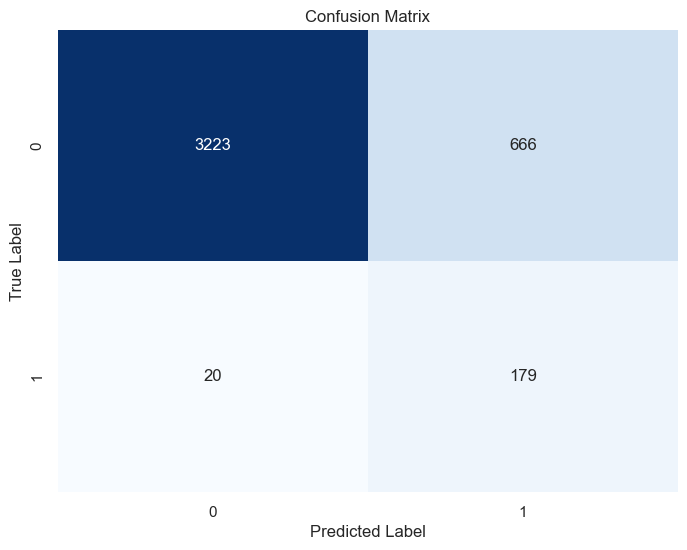

In [49]:
get_study_reports(study_rf, rf_prep, RandomForestClassifier, get_best_params_rf(study_rf))

- Performance on the test set is not bad given the imbalanced problem.
- The model seems to generalize quite well.
- Quite many FP's.

In [50]:
lgb_xgb_prep  = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore', drop='if_binary'), ['gender', 'ever_married',
                                                                           'work_type', 'Residence_type',
                                                                          'smoking_status'])
], remainder='passthrough')

study_lgb = optimize_lgb_with_preprocessor(lgb_xgb_prep, X_train, y_train, n_trials=300)

[I 2024-10-06 19:21:03,774] A new study created in memory with name: no-name-e4028bba-6adc-4767-af47-ff3903bb1ebc


[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001449 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Auto-choosing row-wise mu

[I 2024-10-06 19:21:05,315] Trial 0 finished with value: 0.11818731258098217 and parameters: {'boosting_type': 'goss', 'n_estimators': 260, 'learning_rate': 0.11922430615478581, 'max_depth': 1, 'num_leaves': 224, 'min_child_samples': 94, 'subsample': 0.19697616510422541, 'colsample_bytree': 0.6730138973381978, 'reg_alpha': 0.19003927695578182, 'reg_lambda': 0.91321481987911}. Best is trial 0 with value: 0.11818731258098217.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001048 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048915 -> initscore=-2.967526
[LightGBM] [Info] Start training from score -2.967526
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-10-06 19:21:05,884] Trial 1 finished with value: 0.11826367901859192 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 117, 'learning_rate': 0.08453502026006074, 'max_depth': 20, 'num_leaves': 12, 'min_child_samples': 78, 'subsample': 0.3323410540254724, 'colsample_bytree': 0.5454618161529798, 'reg_alpha': 0.15849808434302948, 'reg_lambda': 0.8428746082047354}. Best is trial 1 with value: 0.11826367901859192.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000431 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:21:10,520] Trial 2 finished with value: 0.13078277562232654 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 212, 'learning_rate': 0.010596849023622599, 'max_depth': 24, 'num_leaves': 116, 'min_child_samples': 55, 'subsample': 0.6463189047238782, 'colsample_bytree': 0.5853058300037404, 'reg_alpha': 0.041786867486559465, 'reg_lambda': 0.9458950902105504}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further split

[I 2024-10-06 19:21:11,400] Trial 4 finished with value: 0.12508960126120977 and parameters: {'boosting_type': 'dart', 'n_estimators': 180, 'learning_rate': 0.161648810045679, 'max_depth': 18, 'num_leaves': 34, 'min_child_samples': 97, 'subsample': 0.9239868825908301, 'colsample_bytree': 0.8030690599183299, 'reg_alpha': 0.7857957022407224, 'reg_lambda': 0.24859896281931393}. Best is trial 2 with value: 0.13078277562232654.
[I 2024-10-06 19:21:11,546] Trial 5 finished with value: 0.11300399437933213 and parameters: {'boosting_type': 'dart', 'n_estimators': 251, 'learning_rate': 0.13470493458056904, 'max_depth': 4, 'num_leaves': 47, 'min_child_samples': 30, 'subsample': 0.42440669267096043, 'colsample_bytree': 0.4056759138816828, 'reg_alpha': 0.33240701321122357, 'reg_lambda': 0.6208663175766884}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:13,504] Trial 3 finished with value: 0.0899421594542808 and parameters: {'boosting_type': 'dart', 'n_estimators': 139, 'learning_rate': 0.27468784100824184, 'max_depth': 27, 'num_leaves': 74, 'min_child_samples': 23, 'subsample': 0.877474900786149, 'colsample_bytree': 0.9383516374956422, 'reg_alpha': 0.8216894999622399, 'reg_lambda': 0.9343632247581375}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:14,102] Trial 6 finished with value: 0.09224460678527899 and parameters: {'boosting_type': 'goss', 'n_estimators': 142, 'learning_rate': 0.12909586192175085, 'max_depth': 21, 'num_leaves': 204, 'min_child_samples': 46, 'subsample': 0.2104758724419759, 'colsample_bytree': 0.9966139720394986, 'reg_alpha': 0.17046005880263904, 'reg_lambda': 0.33008206653965244}. Best is trial 2 with value: 0.13078277562232654.
[I 2024-10-06 19:21:14,152] Trial 8 finished with value: 0.12498503948214779 and parameters: {'boosting_type': 'dart', 'n_estimators': 80, 'learning_rate': 0.07436804274035573, 'max_depth': 14, 'num_leaves': 220, 'min_child_samples': 81, 'subsample': 0.4403417251985269, 'colsample_bytree': 0.624292847175079, 'reg_alpha': 0.23657913902266448, 'reg_lambda': 0.8141384921253508}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:14,482] Trial 10 finished with value: 0.10698302189449879 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 65, 'learning_rate': 0.2512205037217755, 'max_depth': 1, 'num_leaves': 71, 'min_child_samples': 84, 'subsample': 0.2782544894474931, 'colsample_bytree': 0.9484571799921631, 'reg_alpha': 0.9219457018438801, 'reg_lambda': 0.4087954891158847}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 635
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048609 -> initscore=-2.974117
[LightGBM] [Info] Start training from score -2.974117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:21:15,769] Trial 11 finished with value: 0.11935384524537632 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 57, 'learning_rate': 0.1304789814057567, 'max_depth': 6, 'num_leaves': 143, 'min_child_samples': 11, 'subsample': 0.20129515748591503, 'colsample_bytree': 0.596709349416227, 'reg_alpha': 0.5074530938808177, 'reg_lambda': 0.6147658022252714}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:19,033] Trial 7 finished with value: 0.10737722132128502 and parameters: {'boosting_type': 'dart', 'n_estimators': 240, 'learning_rate': 0.24994490400979394, 'max_depth': 6, 'num_leaves': 223, 'min_child_samples': 55, 'subsample': 0.7390472736840823, 'colsample_bytree': 0.6815935003969771, 'reg_alpha': 0.11942497603607805, 'reg_lambda': 0.4245541303013265}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:20,298] Trial 13 finished with value: 0.10546327071265464 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 206, 'learning_rate': 0.011790001558291253, 'max_depth': 28, 'num_leaves': 136, 'min_child_samples': 59, 'subsample': 0.7124349535146463, 'colsample_bytree': 0.2504717384108078, 'reg_alpha': 0.028217082481947875, 'reg_lambda': 0.08893786007835902}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:22,120] Trial 9 finished with value: 0.11646468141562646 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 283, 'learning_rate': 0.038891393746726906, 'max_depth': 29, 'num_leaves': 196, 'min_child_samples': 95, 'subsample': 0.5630151763536492, 'colsample_bytree': 0.9507378599697616, 'reg_alpha': 0.1967714939338907, 'reg_lambda': 0.4236209889431941}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:22,641] Trial 12 finished with value: 0.11596277406197864 and parameters: {'boosting_type': 'dart', 'n_estimators': 213, 'learning_rate': 0.13383772133139804, 'max_depth': 10, 'num_leaves': 209, 'min_child_samples': 61, 'subsample': 0.9257313620030476, 'colsample_bytree': 0.4443808600737466, 'reg_alpha': 0.9235801736346013, 'reg_lambda': 0.5662690181851475}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:25,849] Trial 14 finished with value: 0.1245123131398262 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 197, 'learning_rate': 0.02835045727455415, 'max_depth': 29, 'num_leaves': 133, 'min_child_samples': 58, 'subsample': 0.6926381368530119, 'colsample_bytree': 0.8148929338220673, 'reg_alpha': 0.6643827278373418, 'reg_lambda': 0.059320476638011516}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:26,533] Trial 17 finished with value: 0.09638953281320199 and parameters: {'boosting_type': 'goss', 'n_estimators': 186, 'learning_rate': 0.19230152875849424, 'max_depth': 22, 'num_leaves': 102, 'min_child_samples': 39, 'subsample': 0.7393199850914307, 'colsample_bytree': 0.8180043989638209, 'reg_alpha': 0.6526000946962942, 'reg_lambda': 0.14157065671797087}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-10-06 19:21:26,761] Trial 15 finished with value: 0.12392300588185239 and parameters: {'boosting_type': 'dart', 'n_estimators': 194, 'learning_rate': 0.19301945670965948, 'max_depth': 14, 'num_leaves': 110, 'min_child_samples': 99, 'subsample': 0.9980219207410606, 'colsample_bytree': 0.8137309249778644, 'reg_alpha': 0.6681855541974437, 'reg_lambda': 0.14642964016872084}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624

[I 2024-10-06 19:21:26,979] Trial 19 finished with value: 0.11964701935083186 and parameters: {'boosting_type': 'dart', 'n_estimators': 19, 'learning_rate': 0.17834466171405547, 'max_depth': 16, 'num_leaves': 6, 'min_child_samples': 69, 'subsample': 0.9633433020149587, 'colsample_bytree': 0.7840298952553825, 'reg_alpha': 0.4267855288381682, 'reg_lambda': 0.17854872148461143}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000366 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 635
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 16
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048609 -> initscore=-2.974117
[LightGBM] [Info] Start training from score -2.974117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:21:27,343] Trial 20 finished with value: 0.10318052383009498 and parameters: {'boosting_type': 'dart', 'n_estimators': 13, 'learning_rate': 0.1872058596537142, 'max_depth': 24, 'num_leaves': 173, 'min_child_samples': 69, 'subsample': 0.6157960289817551, 'colsample_bytree': 0.49610179232468465, 'reg_alpha': 0.4101218378418114, 'reg_lambda': 0.22952696202194933}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000619 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] To

[I 2024-10-06 19:21:27,899] Trial 18 finished with value: 0.10870327607868206 and parameters: {'boosting_type': 'goss', 'n_estimators': 170, 'learning_rate': 0.18880371598313023, 'max_depth': 22, 'num_leaves': 8, 'min_child_samples': 44, 'subsample': 0.9840966833825378, 'colsample_bytree': 0.7923651768620563, 'reg_alpha': 0.6453258197029553, 'reg_lambda': 0.19381795294680682}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3112
[LightGBM] [Info] Auto-choosing 

[I 2024-10-06 19:21:29,140] Trial 16 finished with value: 0.11234175416582433 and parameters: {'boosting_type': 'dart', 'n_estimators': 190, 'learning_rate': 0.1945376093394886, 'max_depth': 14, 'num_leaves': 103, 'min_child_samples': 71, 'subsample': 0.9796148658191484, 'colsample_bytree': 0.7891831223273459, 'reg_alpha': 0.6658587947474959, 'reg_lambda': 0.15672979054491482}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:32,526] Trial 24 finished with value: 0.12800440490636517 and parameters: {'boosting_type': 'dart', 'n_estimators': 117, 'learning_rate': 0.08634842212065304, 'max_depth': 17, 'num_leaves': 168, 'min_child_samples': 83, 'subsample': 0.48349585748968044, 'colsample_bytree': 0.6603984900111882, 'reg_alpha': 0.05108207773388922, 'reg_lambda': 0.8033934966459031}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:34,677] Trial 21 finished with value: 0.07042967158442703 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 171, 'learning_rate': 0.22639429503633784, 'max_depth': 24, 'num_leaves': 255, 'min_child_samples': 7, 'subsample': 0.8275513953321997, 'colsample_bytree': 0.47476504973368466, 'reg_alpha': 0.5434876418448845, 'reg_lambda': 0.7341030948253453}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:35,304] Trial 25 finished with value: 0.1236811138193391 and parameters: {'boosting_type': 'dart', 'n_estimators': 108, 'learning_rate': 0.07585891000883685, 'max_depth': 18, 'num_leaves': 164, 'min_child_samples': 88, 'subsample': 0.8500615926896607, 'colsample_bytree': 0.6991420612950089, 'reg_alpha': 0.010671721935005603, 'reg_lambda': 0.7248016866198338}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:35,499] Trial 23 finished with value: 0.09066123041557532 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 298, 'learning_rate': 0.07170472504352382, 'max_depth': 17, 'num_leaves': 40, 'min_child_samples': 3, 'subsample': 0.8489615743465545, 'colsample_bytree': 0.3193169629164289, 'reg_alpha': 0.8197806057106651, 'reg_lambda': 0.7423675365017705}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:38,108] Trial 26 finished with value: 0.12223142014973884 and parameters: {'boosting_type': 'dart', 'n_estimators': 114, 'learning_rate': 0.0935089771187795, 'max_depth': 16, 'num_leaves': 167, 'min_child_samples': 88, 'subsample': 0.4476989975837928, 'colsample_bytree': 0.7128494459756218, 'reg_alpha': 0.0049797943416363885, 'reg_lambda': 0.9813987581025255}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:42,516] Trial 22 finished with value: 0.091105823792932 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 298, 'learning_rate': 0.08049314217170214, 'max_depth': 18, 'num_leaves': 250, 'min_child_samples': 4, 'subsample': 0.8505902025649443, 'colsample_bytree': 0.3558979549195873, 'reg_alpha': 0.783032697007162, 'reg_lambda': 0.2809580705607872}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:44,141] Trial 27 finished with value: 0.11909744839175959 and parameters: {'boosting_type': 'dart', 'n_estimators': 223, 'learning_rate': 0.0603717076088922, 'max_depth': 18, 'num_leaves': 54, 'min_child_samples': 90, 'subsample': 0.45482827645684476, 'colsample_bytree': 0.3849820253552947, 'reg_alpha': 0.7852115328519913, 'reg_lambda': 0.9824678918256944}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:45,023] Trial 28 finished with value: 0.12609382256476626 and parameters: {'boosting_type': 'dart', 'n_estimators': 235, 'learning_rate': 0.09683585861877593, 'max_depth': 10, 'num_leaves': 179, 'min_child_samples': 88, 'subsample': 0.4473971159231556, 'colsample_bytree': 0.5915860450914561, 'reg_alpha': 0.07938328747488851, 'reg_lambda': 0.9696192789089892}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:46,686] Trial 31 finished with value: 0.1300685135704263 and parameters: {'boosting_type': 'goss', 'n_estimators': 145, 'learning_rate': 0.1603614718149744, 'max_depth': 25, 'num_leaves': 83, 'min_child_samples': 75, 'subsample': 0.6251003621726711, 'colsample_bytree': 0.6067329165138166, 'reg_alpha': 0.29808420200371655, 'reg_lambda': 0.837080399237086}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:48,335] Trial 29 finished with value: 0.12270115161002641 and parameters: {'boosting_type': 'dart', 'n_estimators': 226, 'learning_rate': 0.0399802590484051, 'max_depth': 11, 'num_leaves': 66, 'min_child_samples': 78, 'subsample': 0.5196531471639931, 'colsample_bytree': 0.5498630376854503, 'reg_alpha': 0.28479513334518824, 'reg_lambda': 0.8553796311263872}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:49,535] Trial 33 finished with value: 0.11997932008768486 and parameters: {'boosting_type': 'goss', 'n_estimators': 147, 'learning_rate': 0.10596434878031981, 'max_depth': 26, 'num_leaves': 116, 'min_child_samples': 72, 'subsample': 0.6203221976956396, 'colsample_bytree': 0.5484985313197267, 'reg_alpha': 0.2880470670891514, 'reg_lambda': 0.8664604224208892}. Best is trial 2 with value: 0.13078277562232654.
[I 2024-10-06 19:21:49,588] Trial 32 finished with value: 0.11500163396698815 and parameters: {'boosting_type': 'goss', 'n_estimators': 272, 'learning_rate': 0.10413181532264919, 'max_depth': 10, 'num_leaves': 187, 'min_child_samples': 76, 'subsample': 0.5225715122427601, 'colsample_bytree': 0.5583824791170099, 'reg_alpha': 0.09497596096428873, 'reg_lambda': 0.8579994924250715}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:50,588] Trial 34 finished with value: 0.11857778078165486 and parameters: {'boosting_type': 'goss', 'n_estimators': 159, 'learning_rate': 0.10463948891710005, 'max_depth': 25, 'num_leaves': 183, 'min_child_samples': 74, 'subsample': 0.6118451650804069, 'colsample_bytree': 0.6313126802947735, 'reg_alpha': 0.09095552335070367, 'reg_lambda': 0.9234029997393897}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:51,591] Trial 36 finished with value: 0.12022801314996341 and parameters: {'boosting_type': 'goss', 'n_estimators': 127, 'learning_rate': 0.15484449907143927, 'max_depth': 25, 'num_leaves': 85, 'min_child_samples': 64, 'subsample': 0.3207220509162273, 'colsample_bytree': 0.727248366384056, 'reg_alpha': 0.11462942522436337, 'reg_lambda': 0.9221126961134385}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:51,707] Trial 30 finished with value: 0.12494029104820507 and parameters: {'boosting_type': 'dart', 'n_estimators': 227, 'learning_rate': 0.052375226668556416, 'max_depth': 10, 'num_leaves': 79, 'min_child_samples': 76, 'subsample': 0.5164608276144103, 'colsample_bytree': 0.5935966806085304, 'reg_alpha': 0.28648210391659334, 'reg_lambda': 0.8491270636196665}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:52,636] Trial 37 finished with value: 0.12116817550254037 and parameters: {'boosting_type': 'goss', 'n_estimators': 133, 'learning_rate': 0.15213873765594452, 'max_depth': 11, 'num_leaves': 90, 'min_child_samples': 65, 'subsample': 0.6609767491338923, 'colsample_bytree': 0.6469081979954536, 'reg_alpha': 0.07627355787007481, 'reg_lambda': 0.7921098275960845}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:53,080] Trial 38 finished with value: 0.11354877038115418 and parameters: {'boosting_type': 'goss', 'n_estimators': 108, 'learning_rate': 0.15344498541862753, 'max_depth': 12, 'num_leaves': 160, 'min_child_samples': 84, 'subsample': 0.3832564955257513, 'colsample_bytree': 0.6406706705450457, 'reg_alpha': 0.05735715543988401, 'reg_lambda': 0.801319796330219}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:53,457] Trial 39 finished with value: 0.11507650905116092 and parameters: {'boosting_type': 'goss', 'n_estimators': 88, 'learning_rate': 0.15081995498329473, 'max_depth': 20, 'num_leaves': 148, 'min_child_samples': 51, 'subsample': 0.3768413034474872, 'colsample_bytree': 0.6408022695903746, 'reg_alpha': 0.06558075003347694, 'reg_lambda': 0.794352336823935}. Best is trial 2 with value: 0.13078277562232654.
[I 2024-10-06 19:21:53,493] Trial 35 finished with value: 0.10476005693217867 and parameters: {'boosting_type': 'goss', 'n_estimators': 268, 'learning_rate': 0.15574652321657723, 'max_depth': 11, 'num_leaves': 89, 'min_child_samples': 65, 'subsample': 0.38476348511760883, 'colsample_bytree': 0.5982986221286135, 'reg_alpha': 0.09651512898052599, 'reg_lambda': 0.9263196618522653}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:55,417] Trial 40 finished with value: 0.07563532299462003 and parameters: {'boosting_type': 'goss', 'n_estimators': 86, 'learning_rate': 0.010180944076335213, 'max_depth': 20, 'num_leaves': 150, 'min_child_samples': 51, 'subsample': 0.10006804124590007, 'colsample_bytree': 0.493826806312505, 'reg_alpha': 0.17472517479735056, 'reg_lambda': 0.673540183648802}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:58,853] Trial 42 finished with value: 0.09630047803653012 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 251, 'learning_rate': 0.22047256948681415, 'max_depth': 7, 'num_leaves': 127, 'min_child_samples': 93, 'subsample': 0.7774301550206518, 'colsample_bytree': 0.5076955781843995, 'reg_alpha': 0.17250964584040523, 'reg_lambda': 0.6578693893656673}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:21:58,985] Trial 43 finished with value: 0.122894978701658 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 248, 'learning_rate': 0.011190587886735135, 'max_depth': 8, 'num_leaves': 26, 'min_child_samples': 93, 'subsample': 0.12329779722674927, 'colsample_bytree': 0.5121058412232631, 'reg_alpha': 0.1832934350397704, 'reg_lambda': 0.6628078228744279}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:01,065] Trial 41 finished with value: 0.12414653896791213 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 257, 'learning_rate': 0.013402524871372702, 'max_depth': 7, 'num_leaves': 144, 'min_child_samples': 31, 'subsample': 0.38344288051088277, 'colsample_bytree': 0.5051365245379518, 'reg_alpha': 0.19657833545488318, 'reg_lambda': 0.6840699623420059}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:02,498] Trial 46 finished with value: 0.11915690151579905 and parameters: {'boosting_type': 'dart', 'n_estimators': 176, 'learning_rate': 0.12076742773638585, 'max_depth': 3, 'num_leaves': 22, 'min_child_samples': 82, 'subsample': 0.5624598839916509, 'colsample_bytree': 0.8997699100369426, 'reg_alpha': 0.992821365494425, 'reg_lambda': 0.9939553879833471}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:04,396] Trial 44 finished with value: 0.11749823687054559 and parameters: {'boosting_type': 'dart', 'n_estimators': 246, 'learning_rate': 0.17233540141283946, 'max_depth': 7, 'num_leaves': 26, 'min_child_samples': 100, 'subsample': 0.8026215934545281, 'colsample_bytree': 0.7490259539956318, 'reg_alpha': 0.15106289758082092, 'reg_lambda': 0.5302183085451895}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:08,394] Trial 47 finished with value: 0.12020945678625909 and parameters: {'boosting_type': 'dart', 'n_estimators': 175, 'learning_rate': 0.1184722337652876, 'max_depth': 22, 'num_leaves': 25, 'min_child_samples': 98, 'subsample': 0.5629519802585443, 'colsample_bytree': 0.8972050385596908, 'reg_alpha': 0.9912505176153823, 'reg_lambda': 0.9990375107407079}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:09,001] Trial 48 finished with value: 0.12594918010017958 and parameters: {'boosting_type': 'dart', 'n_estimators': 148, 'learning_rate': 0.17236948411339406, 'max_depth': 27, 'num_leaves': 122, 'min_child_samples': 100, 'subsample': 0.4928318729563007, 'colsample_bytree': 0.8815258493000747, 'reg_alpha': 0.3967194155250269, 'reg_lambda': 0.364144485899988}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:10,151] Trial 45 finished with value: 0.12210285120876867 and parameters: {'boosting_type': 'dart', 'n_estimators': 242, 'learning_rate': 0.11983409184573988, 'max_depth': 22, 'num_leaves': 121, 'min_child_samples': 99, 'subsample': 0.47413706533076133, 'colsample_bytree': 0.8773945255181607, 'reg_alpha': 0.22440233914912466, 'reg_lambda': 0.48978579267140526}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:13,803] Trial 49 finished with value: 0.10651002160005194 and parameters: {'boosting_type': 'dart', 'n_estimators': 155, 'learning_rate': 0.29107874480358675, 'max_depth': 27, 'num_leaves': 52, 'min_child_samples': 85, 'subsample': 0.487386966454716, 'colsample_bytree': 0.8727220220522873, 'reg_alpha': 0.24166764883222497, 'reg_lambda': 0.004835760300425013}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:15,621] Trial 51 finished with value: 0.12146331079432109 and parameters: {'boosting_type': 'dart', 'n_estimators': 153, 'learning_rate': 0.21306551203916765, 'max_depth': 27, 'num_leaves': 122, 'min_child_samples': 84, 'subsample': 0.4631627366735387, 'colsample_bytree': 0.4439972692424715, 'reg_alpha': 0.3823754432508304, 'reg_lambda': 0.35940301997135293}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:16,022] Trial 50 finished with value: 0.10410412210792837 and parameters: {'boosting_type': 'dart', 'n_estimators': 155, 'learning_rate': 0.2864016729216571, 'max_depth': 28, 'num_leaves': 120, 'min_child_samples': 84, 'subsample': 0.269469009937374, 'colsample_bytree': 0.6737848581304117, 'reg_alpha': 0.23316656396791746, 'reg_lambda': 0.37903695355827194}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:17,431] Trial 52 finished with value: 0.11921342035803457 and parameters: {'boosting_type': 'dart', 'n_estimators': 161, 'learning_rate': 0.20855283737031996, 'max_depth': 30, 'num_leaves': 105, 'min_child_samples': 86, 'subsample': 0.4881997647778271, 'colsample_bytree': 0.6646091714747451, 'reg_alpha': 0.3299205314814857, 'reg_lambda': 0.3571438413895853}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:18,868] Trial 53 finished with value: 0.11540652448212796 and parameters: {'boosting_type': 'dart', 'n_estimators': 124, 'learning_rate': 0.2144335983394231, 'max_depth': 28, 'num_leaves': 101, 'min_child_samples': 80, 'subsample': 0.661330114362653, 'colsample_bytree': 0.6720074479219864, 'reg_alpha': 0.3862575004211859, 'reg_lambda': 0.8907438060516375}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:25,092] Trial 54 finished with value: 0.10748486613298017 and parameters: {'boosting_type': 'dart', 'n_estimators': 215, 'learning_rate': 0.16805031477415555, 'max_depth': 29, 'num_leaves': 100, 'min_child_samples': 95, 'subsample': 0.2607420590088454, 'colsample_bytree': 0.9918845058434206, 'reg_alpha': 0.48262629897847875, 'reg_lambda': 0.3240159925037204}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:25,270] Trial 55 finished with value: 0.12950905221212486 and parameters: {'boosting_type': 'dart', 'n_estimators': 208, 'learning_rate': 0.1670388700514634, 'max_depth': 30, 'num_leaves': 103, 'min_child_samples': 95, 'subsample': 0.9198967509893298, 'colsample_bytree': 0.9705831897128095, 'reg_alpha': 0.36924048507287266, 'reg_lambda': 0.29144260887369733}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:26,252] Trial 56 finished with value: 0.12419620875015543 and parameters: {'boosting_type': 'dart', 'n_estimators': 207, 'learning_rate': 0.16842188636680794, 'max_depth': 24, 'num_leaves': 201, 'min_child_samples': 95, 'subsample': 0.6550162779071683, 'colsample_bytree': 0.58138286358267, 'reg_alpha': 0.485083209835972, 'reg_lambda': 0.2786514636641533}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:27,826] Trial 57 finished with value: 0.12026999977745542 and parameters: {'boosting_type': 'dart', 'n_estimators': 207, 'learning_rate': 0.1654534476973681, 'max_depth': 13, 'num_leaves': 207, 'min_child_samples': 95, 'subsample': 0.9135709679366667, 'colsample_bytree': 0.9743535568042319, 'reg_alpha': 0.48830217728479103, 'reg_lambda': 0.30160258052646727}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:30,946] Trial 60 finished with value: 0.08330363454102398 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 140, 'learning_rate': 0.1416363958939923, 'max_depth': 30, 'num_leaves': 136, 'min_child_samples': 91, 'subsample': 0.41455651374662794, 'colsample_bytree': 0.9771919840332984, 'reg_alpha': 0.5397130201686945, 'reg_lambda': 0.4774572389026652}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:32,570] Trial 61 finished with value: 0.09649427153245553 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 139, 'learning_rate': 0.13946816313757382, 'max_depth': 30, 'num_leaves': 62, 'min_child_samples': 91, 'subsample': 0.5878268208865304, 'colsample_bytree': 0.7586498882520356, 'reg_alpha': 0.13680739344039483, 'reg_lambda': 0.4540947339031102}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:32,823] Trial 59 finished with value: 0.122074680023296 and parameters: {'boosting_type': 'dart', 'n_estimators': 199, 'learning_rate': 0.1372509223471801, 'max_depth': 24, 'num_leaves': 207, 'min_child_samples': 91, 'subsample': 0.9150458801851868, 'colsample_bytree': 0.9742894048202522, 'reg_alpha': 0.4742059503675379, 'reg_lambda': 0.45993164098651124}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:32,989] Trial 58 finished with value: 0.12489391932559757 and parameters: {'boosting_type': 'dart', 'n_estimators': 204, 'learning_rate': 0.14117150814637489, 'max_depth': 24, 'num_leaves': 136, 'min_child_samples': 92, 'subsample': 0.9090025728071776, 'colsample_bytree': 0.8418878724240175, 'reg_alpha': 0.529673402956429, 'reg_lambda': 0.25904965315801237}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000517 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:22:45,312] Trial 64 finished with value: 0.09333372430244376 and parameters: {'boosting_type': 'dart', 'n_estimators': 185, 'learning_rate': 0.18170430744710062, 'max_depth': 15, 'num_leaves': 232, 'min_child_samples': 39, 'subsample': 0.9500032880451963, 'colsample_bytree': 0.9274131089150897, 'reg_alpha': 0.5972967008106104, 'reg_lambda': 0.23374725871282476}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:46,034] Trial 63 finished with value: 0.08574427690184315 and parameters: {'boosting_type': 'dart', 'n_estimators': 197, 'learning_rate': 0.23810157422936656, 'max_depth': 26, 'num_leaves': 156, 'min_child_samples': 45, 'subsample': 0.7589980121867513, 'colsample_bytree': 0.9216674624527403, 'reg_alpha': 0.4486388944595849, 'reg_lambda': 0.9458828490076859}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:46,973] Trial 62 finished with value: 0.09965323752237071 and parameters: {'boosting_type': 'dart', 'n_estimators': 233, 'learning_rate': 0.1427064812394565, 'max_depth': 26, 'num_leaves': 65, 'min_child_samples': 44, 'subsample': 0.7256633045253763, 'colsample_bytree': 0.8408465193198194, 'reg_alpha': 0.13787036343086223, 'reg_lambda': 0.4485629500317027}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:50,983] Trial 65 finished with value: 0.08430869492207993 and parameters: {'boosting_type': 'dart', 'n_estimators': 185, 'learning_rate': 0.19984739168012458, 'max_depth': 19, 'num_leaves': 77, 'min_child_samples': 23, 'subsample': 0.9513332421792942, 'colsample_bytree': 0.9328461268930384, 'reg_alpha': 0.038040203520319664, 'reg_lambda': 0.21021261699298285}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:52,972] Trial 67 finished with value: 0.0929304479291481 and parameters: {'boosting_type': 'dart', 'n_estimators': 99, 'learning_rate': 0.19849768115010238, 'max_depth': 19, 'num_leaves': 40, 'min_child_samples': 18, 'subsample': 0.7224313300775841, 'colsample_bytree': 0.84545626902651, 'reg_alpha': 0.3339721174762623, 'reg_lambda': 0.8888874266374377}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:54,883] Trial 69 finished with value: 0.1306569791386466 and parameters: {'boosting_type': 'dart', 'n_estimators': 94, 'learning_rate': 0.032161852384906695, 'max_depth': 21, 'num_leaves': 110, 'min_child_samples': 97, 'subsample': 0.4258595512267421, 'colsample_bytree': 0.5749746165518458, 'reg_alpha': 0.34065282777865147, 'reg_lambda': 0.8967528594833823}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:57,251] Trial 66 finished with value: 0.11408258532629438 and parameters: {'boosting_type': 'dart', 'n_estimators': 231, 'learning_rate': 0.20102190975949347, 'max_depth': 19, 'num_leaves': 110, 'min_child_samples': 97, 'subsample': 0.7426395363313216, 'colsample_bytree': 0.8343652988373784, 'reg_alpha': 0.03447846497246533, 'reg_lambda': 0.9547183499191569}. Best is trial 2 with value: 0.13078277562232654.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3112
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.002569 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 635
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048609 -> initscore=-2.974117
[LightGBM] [Info] Start training from score -2.974117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-10-06 19:22:57,813] Trial 71 finished with value: 0.13261110972337448 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 73, 'learning_rate': 0.028145685366254503, 'max_depth': 21, 'num_leaves': 177, 'min_child_samples': 87, 'subsample': 0.322504442760585, 'colsample_bytree': 0.5681859935709324, 'reg_alpha': 0.33588290082514904, 'reg_lambda': 0.7629229801155545}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:59,239] Trial 72 finished with value: 0.12676627050832576 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 48, 'learning_rate': 0.026074082409642194, 'max_depth': 23, 'num_leaves': 173, 'min_child_samples': 88, 'subsample': 0.3344763240919345, 'colsample_bytree': 0.5778983958496826, 'reg_alpha': 0.33521893841286793, 'reg_lambda': 0.8169198246670186}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:22:59,666] Trial 73 finished with value: 0.11984004447358118 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 49, 'learning_rate': 0.023502500917108426, 'max_depth': 21, 'num_leaves': 172, 'min_child_samples': 88, 'subsample': 0.4196752311528239, 'colsample_bytree': 0.5651303970960634, 'reg_alpha': 0.33001025890603186, 'reg_lambda': 0.8933941481151862}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:00,722] Trial 74 finished with value: 0.12128554161665883 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 43, 'learning_rate': 0.03270250808759025, 'max_depth': 21, 'num_leaves': 189, 'min_child_samples': 80, 'subsample': 0.3402440237505487, 'colsample_bytree': 0.5718747989532097, 'reg_alpha': 0.3181380993459176, 'reg_lambda': 0.7677187746926333}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:02,243] Trial 75 finished with value: 0.1277374402187839 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 70, 'learning_rate': 0.03954805724044425, 'max_depth': 22, 'num_leaves': 187, 'min_child_samples': 79, 'subsample': 0.3373863415392313, 'colsample_bytree': 0.5285665810237742, 'reg_alpha': 0.266351353809691, 'reg_lambda': 0.7650223427001127}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:02,823] Trial 70 finished with value: 0.10263160191488367 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 217, 'learning_rate': 0.0935692587156477, 'max_depth': 23, 'num_leaves': 176, 'min_child_samples': 87, 'subsample': 0.42983292011809066, 'colsample_bytree': 0.6139844191415238, 'reg_alpha': 0.3776633839778877, 'reg_lambda': 0.9578842960223277}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:03,550] Trial 76 finished with value: 0.12944182052390843 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 77, 'learning_rate': 0.04311809210872823, 'max_depth': 23, 'num_leaves': 182, 'min_child_samples': 89, 'subsample': 0.3190603875154103, 'colsample_bytree': 0.5393023140067223, 'reg_alpha': 0.3611314581332818, 'reg_lambda': 0.8190170775153477}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000735 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 63

[I 2024-10-06 19:23:04,275] Trial 68 finished with value: 0.11726906599875928 and parameters: {'boosting_type': 'dart', 'n_estimators': 181, 'learning_rate': 0.09142545239218453, 'max_depth': 19, 'num_leaves': 179, 'min_child_samples': 21, 'subsample': 0.8742760793542057, 'colsample_bytree': 0.5736706088183707, 'reg_alpha': 0.7369437739552792, 'reg_lambda': 0.9641372333402117}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:05,029] Trial 77 finished with value: 0.12744981333079458 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 68, 'learning_rate': 0.049315493593390464, 'max_depth': 23, 'num_leaves': 191, 'min_child_samples': 75, 'subsample': 0.3215834664891081, 'colsample_bytree': 0.5314952160991616, 'reg_alpha': 0.2592490353264265, 'reg_lambda': 0.8229018353658607}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:07,109] Trial 79 finished with value: 0.12828460055801663 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 69, 'learning_rate': 0.048493758885370816, 'max_depth': 17, 'num_leaves': 192, 'min_child_samples': 75, 'subsample': 0.29939236742415604, 'colsample_bytree': 0.5320769376916483, 'reg_alpha': 0.26402861818466833, 'reg_lambda': 0.8217774994421618}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:07,378] Trial 78 finished with value: 0.12225071912582013 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 73, 'learning_rate': 0.041983094071312343, 'max_depth': 23, 'num_leaves': 216, 'min_child_samples': 55, 'subsample': 0.3108978822805003, 'colsample_bytree': 0.5274721933515907, 'reg_alpha': 0.26275677804575337, 'reg_lambda': 0.8317964929594199}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:08,515] Trial 81 finished with value: 0.1180826329484352 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 72, 'learning_rate': 0.06629787527825075, 'max_depth': 17, 'num_leaves': 94, 'min_child_samples': 78, 'subsample': 0.24261314409044737, 'colsample_bytree': 0.47246555855761907, 'reg_alpha': 0.35893200027185534, 'reg_lambda': 0.7644646770081891}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:08,770] Trial 80 finished with value: 0.1287917234166038 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 99, 'learning_rate': 0.0465804473380074, 'max_depth': 23, 'num_leaves': 218, 'min_child_samples': 77, 'subsample': 0.3027613787100428, 'colsample_bytree': 0.5305350171850709, 'reg_alpha': 0.25830212437919475, 'reg_lambda': 0.7111474773882733}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001807 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-10-06 19:23:09,727] Trial 82 finished with value: 0.12599066183238325 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 75, 'learning_rate': 0.05863852327831645, 'max_depth': 17, 'num_leaves': 217, 'min_child_samples': 69, 'subsample': 0.2940763894358804, 'colsample_bytree': 0.46296685870824705, 'reg_alpha': 0.30572062025836133, 'reg_lambda': 0.8359865128227073}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:10,794] Trial 83 finished with value: 0.12181069296722251 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 96, 'learning_rate': 0.0636467286677227, 'max_depth': 17, 'num_leaves': 197, 'min_child_samples': 72, 'subsample': 0.17906524844367785, 'colsample_bytree': 0.4663857875923751, 'reg_alpha': 0.4390795320306931, 'reg_lambda': 0.5997293560816727}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:11,378] Trial 84 finished with value: 0.12181550946682333 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 94, 'learning_rate': 0.054734063429051495, 'max_depth': 17, 'num_leaves': 198, 'min_child_samples': 82, 'subsample': 0.29491374475384613, 'colsample_bytree': 0.43994781201339955, 'reg_alpha': 0.30212119527530673, 'reg_lambda': 0.7115848053944035}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:12,577] Trial 85 finished with value: 0.12638722832898283 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 98, 'learning_rate': 0.05839270825925628, 'max_depth': 17, 'num_leaves': 234, 'min_child_samples': 68, 'subsample': 0.18248285199989675, 'colsample_bytree': 0.6119195548095304, 'reg_alpha': 0.2983645913027218, 'reg_lambda': 0.6155910547263076}. Best is trial 71 with value: 0.13261110972337448.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:13,019] Trial 87 finished with value: 0.12340665888883544 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 60, 'learning_rate': 0.0481884738968017, 'max_depth': 21, 'num_leaves': 111, 'min_child_samples': 62, 'subsample': 0.3523547539763747, 'colsample_bytree': 0.6144147453805552, 'reg_alpha': 0.36138828271005535, 'reg_lambda': 0.7166874571136708}. Best is trial 71 with value: 0.13261110972337448.
[I 2024-10-06 19:23:13,098] Trial 86 finished with value: 0.13380070689542659 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 97, 'learning_rate': 0.018010490417704746, 'max_depth': 25, 'num_leaves': 242, 'min_child_samples': 73, 'subsample': 0.17483392451472762, 'colsample_bytree': 0.6057055504055934, 'reg_alpha': 0.36317377484007185, 'reg_lambda': 0.6978913867460503}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000219 seconds.
You

[I 2024-10-06 19:23:13,383] Trial 88 finished with value: 0.12153690121262466 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 59, 'learning_rate': 0.019972646340940696, 'max_depth': 25, 'num_leaves': 231, 'min_child_samples': 67, 'subsample': 0.22316724096330864, 'colsample_bytree': 0.6192495623497748, 'reg_alpha': 0.3562800100800542, 'reg_lambda': 0.8702129784212526}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:13,520] Trial 89 finished with value: 0.0486788985883712 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 32, 'learning_rate': 0.02103665520240232, 'max_depth': 21, 'num_leaves': 128, 'min_child_samples': 62, 'subsample': 0.35386220966176496, 'colsample_bytree': 0.2603019014144513, 'reg_alpha': 0.3543944702668815, 'reg_lambda': 0.8780473019824696}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:14,004] Trial 91 finished with value: 0.0486788985883712 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 32, 'learning_rate': 0.016833594069141228, 'max_depth': 25, 'num_leaves': 247, 'min_child_samples': 73, 'subsample': 0.22367459755856114, 'colsample_bytree': 0.25978141769810575, 'reg_alpha': 0.3555924756952526, 'reg_lambda': 0.8669157633755269}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000698 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of data points in the train set: 3270

[I 2024-10-06 19:23:14,904] Trial 92 finished with value: 0.10262733176008905 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 81, 'learning_rate': 0.01871082548355707, 'max_depth': 25, 'num_leaves': 245, 'min_child_samples': 72, 'subsample': 0.20691119414923262, 'colsample_bytree': 0.2591622698933227, 'reg_alpha': 0.4232127899202689, 'reg_lambda': 0.6431912742699436}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:15,025] Trial 90 finished with value: 0.11865279070169257 and parameters: {'boosting_type': 'goss', 'n_estimators': 108, 'learning_rate': 0.03183483361601304, 'max_depth': 25, 'num_leaves': 83, 'min_child_samples': 73, 'subsample': 0.36175787500335665, 'colsample_bytree': 0.4166632480608863, 'reg_alpha': 0.3605013825686847, 'reg_lambda': 0.8749866925112956}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:15,837] Trial 93 finished with value: 0.12092276495798618 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 84, 'learning_rate': 0.033133478582905156, 'max_depth': 25, 'num_leaves': 226, 'min_child_samples': 73, 'subsample': 0.13259947995971919, 'colsample_bytree': 0.6985960374563738, 'reg_alpha': 0.39991102019825936, 'reg_lambda': 0.7479608188926127}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:15,896] Trial 94 finished with value: 0.12189140563659433 and parameters: {'boosting_type': 'goss', 'n_estimators': 111, 'learning_rate': 0.03264145768608362, 'max_depth': 20, 'num_leaves': 242, 'min_child_samples': 82, 'subsample': 0.1400677198094491, 'colsample_bytree': 0.5531059512859472, 'reg_alpha': 0.4165957118202155, 'reg_lambda': 0.7872435247724608}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:16,842] Trial 95 finished with value: 0.12625275432804986 and parameters: {'boosting_type': 'goss', 'n_estimators': 107, 'learning_rate': 0.0291738035446514, 'max_depth': 26, 'num_leaves': 225, 'min_child_samples': 77, 'subsample': 0.5424731603066872, 'colsample_bytree': 0.5429249593534253, 'reg_alpha': 0.22316847922524358, 'reg_lambda': 0.6954554030549591}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:17,948] Trial 96 finished with value: 0.12491431376370095 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 117, 'learning_rate': 0.03128921873048189, 'max_depth': 20, 'num_leaves': 94, 'min_child_samples': 81, 'subsample': 0.39735123583566506, 'colsample_bytree': 0.5404264631453726, 'reg_alpha': 0.2215652395179523, 'reg_lambda': 0.7003955633551998}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:18,064] Trial 97 finished with value: 0.12354618173281713 and parameters: {'boosting_type': 'goss', 'n_estimators': 129, 'learning_rate': 0.044901278377623366, 'max_depth': 15, 'num_leaves': 158, 'min_child_samples': 76, 'subsample': 0.5406795956620096, 'colsample_bytree': 0.5461707231550516, 'reg_alpha': 0.21478009138727344, 'reg_lambda': 0.7010480494630779}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:19,280] Trial 98 finished with value: 0.1269065236052117 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 125, 'learning_rate': 0.04454814977183377, 'max_depth': 26, 'num_leaves': 213, 'min_child_samples': 76, 'subsample': 0.5438437040831566, 'colsample_bytree': 0.543200391530375, 'reg_alpha': 0.20461070140768223, 'reg_lambda': 0.9109132940330796}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:20,101] Trial 100 finished with value: 0.11953731073190506 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 90, 'learning_rate': 0.0459943934901406, 'max_depth': 15, 'num_leaves': 164, 'min_child_samples': 89, 'subsample': 0.6818803829326001, 'colsample_bytree': 0.4943199079458737, 'reg_alpha': 0.27734348749588617, 'reg_lambda': 0.7841414720734974}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:20,466] Trial 99 finished with value: 0.1212922696549447 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 119, 'learning_rate': 0.0458375299520543, 'max_depth': 15, 'num_leaves': 163, 'min_child_samples': 58, 'subsample': 0.39779936972882507, 'colsample_bytree': 0.652515911639179, 'reg_alpha': 0.20334500248080434, 'reg_lambda': 0.9198896326445257}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:21,583] Trial 101 finished with value: 0.1172007031865567 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 90, 'learning_rate': 0.08020596298002569, 'max_depth': 22, 'num_leaves': 71, 'min_child_samples': 58, 'subsample': 0.24839804229919568, 'colsample_bytree': 0.65798980630667, 'reg_alpha': 0.25581338006703647, 'reg_lambda': 0.805004402151609}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 160, number of negative: 3111
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000240 seconds.
You

[I 2024-10-06 19:23:22,633] Trial 103 finished with value: 0.12513292027256387 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 79, 'learning_rate': 0.0738035428687579, 'max_depth': 22, 'num_leaves': 194, 'min_child_samples': 85, 'subsample': 0.6271662183522531, 'colsample_bytree': 0.593968425208952, 'reg_alpha': 0.4635432399447148, 'reg_lambda': 0.7384942287511819}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:22,680] Trial 102 finished with value: 0.1106151545716656 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 88, 'learning_rate': 0.0778946275787825, 'max_depth': 22, 'num_leaves': 72, 'min_child_samples': 57, 'subsample': 0.6872251362220483, 'colsample_bytree': 0.4978152777021477, 'reg_alpha': 0.2738077937599672, 'reg_lambda': 0.8032237893804274}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:22,746] Trial 104 finished with value: 0.12476182164055685 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 78, 'l

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:23,523] Trial 105 finished with value: 0.12876574965133367 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 65, 'learning_rate': 0.07033867551756282, 'max_depth': 22, 'num_leaves': 185, 'min_child_samples': 79, 'subsample': 0.29716842054757947, 'colsample_bytree': 0.5185783924854412, 'reg_alpha': 0.2715951524216307, 'reg_lambda': 0.740991714217251}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Warning] No further 

[I 2024-10-06 19:23:25,122] Trial 108 finished with value: 0.12534416911722204 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 66, 'learning_rate': 0.03841167499059943, 'max_depth': 24, 'num_leaves': 185, 'min_child_samples': 80, 'subsample': 0.5929837050633372, 'colsample_bytree': 0.6288401080347459, 'reg_alpha': 0.31360995570041617, 'reg_lambda': 0.8488188184387866}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:25,765] Trial 106 finished with value: 0.1222663602302267 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 104, 'learning_rate': 0.037992787945245146, 'max_depth': 23, 'num_leaves': 253, 'min_child_samples': 94, 'subsample': 0.2879184478126112, 'colsample_bytree': 0.5123167784104098, 'reg_alpha': 0.27650051779393164, 'reg_lambda': 0.76975870932946}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:25,772] Trial 107 finished with value: 0.12243844534317412 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 65, 'learning_rate': 0.0371456399725724, 'max_depth': 24, 'num_leaves': 184, 'min_child_samples': 49, 'subsample': 0.28732775254468157, 'colsample_bytree': 0.6338440695159977, 'reg_alpha': 0.11734828347709067, 'reg_lambda': 0.7601079108360456}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 160, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000801 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048915 -> initscore=-2.967526
[LightGBM] [Info] Start training from score -2.967526
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:23:26,918] Trial 109 finished with value: 0.13244558654266056 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 100, 'learning_rate': 0.05296365363779235, 'max_depth': 24, 'num_leaves': 182, 'min_child_samples': 70, 'subsample': 0.5908682788697189, 'colsample_bytree': 0.629218402609525, 'reg_alpha': 0.0053174347275336264, 'reg_lambda': 0.8489283852814715}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Info] Number of positive: 159, number of negative: 3112
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000769 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 635
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048609 -> initscore=-2.974117
[LightGBM] [Info] Start training from score -2.974117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, be

[I 2024-10-06 19:23:27,072] Trial 110 finished with value: 0.12680777686516123 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 61, 'learning_rate': 0.06842123594366868, 'max_depth': 29, 'num_leaves': 181, 'min_child_samples': 70, 'subsample': 0.28294925505119023, 'colsample_bytree': 0.5838481856184234, 'reg_alpha': 0.10765483737896706, 'reg_lambda': 0.5275982325643901}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:28,607] Trial 113 finished with value: 0.06177678590510437 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 57, 'learning_rate': 0.014848462627425202, 'max_depth': 29, 'num_leaves': 180, 'min_child_samples': 71, 'subsample': 0.16447093155041748, 'colsample_bytree': 0.5972122238170621, 'reg_alpha': 1.1609055427642609e-05, 'reg_lambda': 0.9062186385744998}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:28,996] Trial 112 finished with value: 0.12428737171478015 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 101, 'learning_rate': 0.06677958449996528, 'max_depth': 18, 'num_leaves': 168, 'min_child_samples': 83, 'subsample': 0.5141574391676796, 'colsample_bytree': 0.584751635238628, 'reg_alpha': 0.011986846146697452, 'reg_lambda': 0.09470739464932051}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:30,523] Trial 114 finished with value: 0.10702075335536096 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 101, 'learning_rate': 0.15863786109353092, 'max_depth': 16, 'num_leaves': 169, 'min_child_samples': 83, 'subsample': 0.5921719557268367, 'colsample_bytree': 0.6035606443669602, 'reg_alpha': 0.0040630849488488205, 'reg_lambda': 0.8488529612219791}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:31,472] Trial 111 finished with value: 0.11774924560505493 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 165, 'learning_rate': 0.06646956102846746, 'max_depth': 18, 'num_leaves': 169, 'min_child_samples': 70, 'subsample': 0.3052893833417434, 'colsample_bytree': 0.5867170981333183, 'reg_alpha': 0.37994251226609305, 'reg_lambda': 0.5317024537026056}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:32,004] Trial 117 finished with value: 0.10877942079300432 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 49, 'learning_rate': 0.024180471861241323, 'max_depth': 21, 'num_leaves': 203, 'min_child_samples': 90, 'subsample': 0.30652703066912645, 'colsample_bytree': 0.49140728955022894, 'reg_alpha': 0.05556682304168824, 'reg_lambda': 0.9363349891267837}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:32,214] Trial 115 finished with value: 0.0927885653489295 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 101, 'learning_rate': 0.1600352988267085, 'max_depth': 18, 'num_leaves': 202, 'min_child_samples': 83, 'subsample': 0.5073791392970199, 'colsample_bytree': 0.6856457755634674, 'reg_alpha': 0.026289817975175597, 'reg_lambda': 0.10998162458960795}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:32,530] Trial 116 finished with value: 0.12277995076699495 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 93, 'learning_rate': 0.08604821854277689, 'max_depth': 20, 'num_leaves': 201, 'min_child_samples': 66, 'subsample': 0.5879996321544344, 'colsample_bytree': 0.6886001860361866, 'reg_alpha': 0.06653591574408035, 'reg_lambda': 0.8086577253882139}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:34,191] Trial 118 finished with value: 0.11370264635328017 and parameters: {'boosting_type': 'goss', 'n_estimators': 131, 'learning_rate': 0.0542338749391323, 'max_depth': 21, 'num_leaves': 106, 'min_child_samples': 66, 'subsample': 0.6283536330929691, 'colsample_bytree': 0.4816719880454309, 'reg_alpha': 0.07382388544443386, 'reg_lambda': 0.9359533384743886}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-10-06 19:23:34,360] Trial 119 finished with value: 0.12533989521659147 and parameters: {'boosting_type': 'goss', 'n_estimators': 119, 'learning_rate': 0.054313358936231966, 'max_depth': 27, 'num_leaves': 108, 'min_child_samples': 78, 'subsample': 0.46997318254702275, 'colsample_bytree': 0.565572511066443, 'reg_alpha': 0.1532323803621615, 'reg_lambda': 0.8303198022004082}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000323 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of data points in the train set: 3270, number of

[I 2024-10-06 19:23:34,595] Trial 120 finished with value: 0.12604743483907793 and parameters: {'boosting_type': 'goss', 'n_estimators': 132, 'learning_rate': 0.056931449636798116, 'max_depth': 27, 'num_leaves': 143, 'min_child_samples': 86, 'subsample': 0.6436221988703854, 'colsample_bytree': 0.5647301060806026, 'reg_alpha': 0.15320248752988186, 'reg_lambda': 0.8222882267344589}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:34,797] Trial 121 finished with value: 0.12542355014734413 and parameters: {'boosting_type': 'goss', 'n_estimators': 135, 'learning_rate': 0.05495933824822778, 'max_depth': 27, 'num_leaves': 150, 'min_child_samples': 86, 'subsample': 0.4726120639856955, 'colsample_bytree': 0.5643857850032954, 'reg_alpha': 0.24365755364577668, 'reg_lambda': 0.7846668058503865}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000396 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Warning] No further splits with positive gai

[I 2024-10-06 19:23:36,779] Trial 123 finished with value: 0.12667378042745497 and parameters: {'boosting_type': 'dart', 'n_estimators': 81, 'learning_rate': 0.1836977078533785, 'max_depth': 24, 'num_leaves': 114, 'min_child_samples': 86, 'subsample': 0.3679593883594562, 'colsample_bytree': 0.5592324806398749, 'reg_alpha': 0.24345049578111555, 'reg_lambda': 0.7362955418768647}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:36,846] Trial 124 finished with value: 0.12759649474035525 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 83, 'learning_rate': 0.028052695171491802, 'max_depth': 23, 'num_leaves': 195, 'min_child_samples': 79, 'subsample': 0.3707081212693113, 'colsample_bytree': 0.5197401755828115, 'reg_alpha': 0.2415687437330259, 'reg_lambda': 0.7785646511609154}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:36,910] Trial 125 finished with value: 0.12872495299453274 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 

[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:38,279] Trial 122 finished with value: 0.12250011916329133 and parameters: {'boosting_type': 'dart', 'n_estimators': 122, 'learning_rate': 0.1782208088430827, 'max_depth': 24, 'num_leaves': 150, 'min_child_samples': 79, 'subsample': 0.4395800780567867, 'colsample_bytree': 0.5663249702649692, 'reg_alpha': 0.16630062692165265, 'reg_lambda': 0.8263880863190632}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:38,846] Trial 127 finished with value: 0.059473511421129735 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 70, 'learning_rate': 0.01099274164148516, 'max_depth': 22, 'num_leaves': 210, 'min_child_samples': 78, 'subsample': 0.3307183418062473, 'colsample_bytree': 0.5258298420126858, 'reg_alpha': 0.323842001265935, 'reg_lambda': 0.7180946794160121}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001271 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 635
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 16
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048609 -> initscore=-2.974117
[LightGBM] [Info] Start training from score -2.974117
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

[I 2024-10-06 19:23:39,110] Trial 126 finished with value: 0.1233469933248977 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 74, 'learning_rate': 0.027841897090205233, 'max_depth': 23, 'num_leaves': 174, 'min_child_samples': 80, 'subsample': 0.3373679437839606, 'colsample_bytree': 0.5169159702694194, 'reg_alpha': 0.3050633711658838, 'reg_lambda': 0.6703199947953076}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:40,618] Trial 129 finished with value: 0.12914533963968225 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 76, 'learning_rate': 0.023825703948853007, 'max_depth': 23, 'num_leaves': 133, 'min_child_samples': 75, 'subsample': 0.32901277229341686, 'colsample_bytree': 0.724636516729202, 'reg_alpha': 0.3338859296273239, 'reg_lambda': 0.6499604236386272}. Best is trial 86 with value: 0.13380070689542659.
[I 2024-10-06 19:23:40,778] Trial 128 finished with value: 0.1037087187797463 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 114, 'learning_rate': 0.14737849616772283, 'max_depth': 24, 'num_leaves': 117, 'min_child_samples': 74, 'subsample': 0.43939784559816764, 'colsample_bytree': 0.45078990719255596, 'reg_alpha': 0.3331911956901582, 'reg_lambda': 0.7198242310416512}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:41,815] Trial 130 finished with value: 0.10070613936451882 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 76, 'learning_rate': 0.14936446216554822, 'max_depth': 23, 'num_leaves': 99, 'min_child_samples': 75, 'subsample': 0.24067825801890447, 'colsample_bytree': 0.7348997206128177, 'reg_alpha': 0.3016898842315287, 'reg_lambda': 0.68596407709276}. Best is trial 86 with value: 0.13380070689542659.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:41,888] Trial 131 finished with value: 0.13687983207326634 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 88, 'learning_rate': 0.020130910109655245, 'max_depth': 24, 'num_leaves': 116, 'min_child_samples': 74, 'subsample': 0.27630943003143094, 'colsample_bytree': 0.7235124151276322, 'reg_alpha': 0.3410719223962286, 'reg_lambda': 0.8946300546495349}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:42,295] Trial 133 finished with value: 0.08955059857235827 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 40, 'learning_rate': 0.021684336841659692, 'max_depth': 26, 'num_leaves': 97, 'min_child_samples': 76, 'subsample': 0.23026228027896495, 'colsample_bytree': 0.6420599310022173, 'reg_alpha': 0.4003676733510057, 'reg_lambda': 0.6634841146504583}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:42,978] Trial 132 finished with value: 0.12708944747408696 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 84, 'learning_rate': 0.02106502185054554, 'max_depth': 24, 'num_leaves': 118, 'min_child_samples': 97, 'subsample': 0.23052918680138595, 'colsample_bytree': 0.7181379050113523, 'reg_alpha': 0.3425998884670721, 'reg_lambda': 0.641979118716178}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:43,759] Trial 136 finished with value: 0.08935960032359738 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 55, 'learning_rate': 0.016027712843256374, 'max_depth': 24, 'num_leaves': 130, 'min_child_samples': 93, 'subsample': 0.27320828162256483, 'colsample_bytree': 0.537867361079472, 'reg_alpha': 0.3435314069078833, 'reg_lambda': 0.6280489386655863}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:44,354] Trial 134 finished with value: 0.1291899054970504 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 86, 'learning_rate': 0.021522243184277635, 'max_depth': 22, 'num_leaves': 132, 'min_child_samples': 75, 'subsample': 0.34999378278041604, 'colsample_bytree': 0.6436469058294905, 'reg_alpha': 0.3451763574552151, 'reg_lambda': 0.8565596150007795}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:44,553] Trial 135 finished with value: 0.12764125826332812 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 84, 'learning_rate': 0.02017473160290568, 'max_depth': 26, 'num_leaves': 125, 'min_child_samples': 64, 'subsample': 0.2722932449391169, 'colsample_bytree': 0.6353739905690642, 'reg_alpha': 0.4003016674222006, 'reg_lambda': 0.639962423064968}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:45,369] Trial 137 finished with value: 0.13150985798338272 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 94, 'learning_rate': 0.015559606860548789, 'max_depth': 25, 'num_leaves': 134, 'min_child_samples': 68, 'subsample': 0.27638130018725116, 'colsample_bytree': 0.8085083845740196, 'reg_alpha': 0.372146480195741, 'reg_lambda': 0.8904091858054983}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:46,517] Trial 139 finished with value: 0.11671497135956699 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 94, 'learning_rate': 0.010710316137432535, 'max_depth': 22, 'num_leaves': 125, 'min_child_samples': 69, 'subsample': 0.40229150671452735, 'colsample_bytree': 0.7761782406466577, 'reg_alpha': 0.3757988865297217, 'reg_lambda': 0.5936791181794151}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:47,521] Trial 141 finished with value: 0.12147473748058706 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 94, 'learning_rate': 0.011146330439891092, 'max_depth': 25, 'num_leaves': 138, 'min_child_samples': 69, 'subsample': 0.3172246537612296, 'colsample_bytree': 0.7853185021128669, 'reg_alpha': 0.3744942781700572, 'reg_lambda': 0.8983308181620555}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:48,657] Trial 138 finished with value: 0.13296237897464847 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 221, 'learning_rate': 0.010725660571016322, 'max_depth': 25, 'num_leaves': 88, 'min_child_samples': 74, 'subsample': 0.31579302019987165, 'colsample_bytree': 0.6068658252749475, 'reg_alpha': 0.3781286282430438, 'reg_lambda': 0.8546516727834241}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:49,146] Trial 142 finished with value: 0.12739774990366964 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 91, 'learning_rate': 0.03473958798844782, 'max_depth': 25, 'num_leaves': 137, 'min_child_samples': 61, 'subsample': 0.31563226091222785, 'colsample_bytree': 0.758516498298748, 'reg_alpha': 0.4488258599372589, 'reg_lambda': 0.8874819707720757}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:49,711] Trial 140 finished with value: 0.13163081952180594 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 221, 'learning_rate': 0.010396504071259721, 'max_depth': 22, 'num_leaves': 141, 'min_child_samples': 69, 'subsample': 0.3126376626231984, 'colsample_bytree': 0.6216921758662013, 'reg_alpha': 0.44474425372070137, 'reg_lambda': 0.8951687580642191}. Best is trial 131 with value: 0.13687983207326634.
[I 2024-10-06 19:23:49,779] Trial 143 finished with value: 0.12668428764343756 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 89, 'learning_rate': 0.03476916361680167, 'max_depth': 25, 'num_leaves': 133, 'min_child_samples': 74, 'subsample': 0.3524896349204634, 'colsample_bytree': 0.8555155126018203, 'reg_alpha': 0.43533994996843844, 'reg_lambda': 0.8607288775015903}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:54,598] Trial 144 finished with value: 0.1276260804325385 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 220, 'learning_rate': 0.015936104394561907, 'max_depth': 25, 'num_leaves': 90, 'min_child_samples': 72, 'subsample': 0.26577230314601896, 'colsample_bytree': 0.808037772169214, 'reg_alpha': 0.31550380630364305, 'reg_lambda': 0.8615945168238207}. Best is trial 131 with value: 0.13687983207326634.
[I 2024-10-06 19:23:54,735] Trial 145 finished with value: 0.1323068044726438 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 218, 'learning_rate': 0.01593488045990775, 'max_depth': 25, 'num_leaves': 84, 'min_child_samples': 74, 'subsample': 0.35044666708164834, 'colsample_bytree': 0.6092782272237991, 'reg_alpha': 0.42366291207329965, 'reg_lambda': 0.8556999485148811}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:55,429] Trial 146 finished with value: 0.1317162538359829 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 211, 'learning_rate': 0.017199290848970386, 'max_depth': 26, 'num_leaves': 85, 'min_child_samples': 71, 'subsample': 0.35449894717524166, 'colsample_bytree': 0.61168343942657, 'reg_alpha': 0.43370692629546975, 'reg_lambda': 0.8532043076289507}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:23:55,785] Trial 147 finished with value: 0.12763376179193717 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 215, 'learning_rate': 0.01610889063233911, 'max_depth': 28, 'num_leaves': 105, 'min_child_samples': 67, 'subsample': 0.25966348786836363, 'colsample_bytree': 0.6123238174122856, 'reg_alpha': 0.5182881593567591, 'reg_lambda': 0.9706647385948409}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:00,085] Trial 148 finished with value: 0.12963446005412407 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 209, 'learning_rate': 0.025254451806210266, 'max_depth': 23, 'num_leaves': 81, 'min_child_samples': 67, 'subsample': 0.794620363266174, 'colsample_bytree': 0.6156716807349881, 'reg_alpha': 0.39431868498244144, 'reg_lambda': 0.9818879611336255}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:00,278] Trial 149 finished with value: 0.12457920079599198 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 212, 'learning_rate': 0.02423524720310266, 'max_depth': 26, 'num_leaves': 81, 'min_child_samples': 67, 'subsample': 0.3503716581710661, 'colsample_bytree': 0.6200393076704799, 'reg_alpha': 0.5183136927393399, 'reg_lambda': 0.9789633732101625}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:01,493] Trial 150 finished with value: 0.12867463260203102 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 226, 'learning_rate': 0.01711625012161807, 'max_depth': 28, 'num_leaves': 76, 'min_child_samples': 67, 'subsample': 0.7931110465697301, 'colsample_bytree': 0.6121829883942527, 'reg_alpha': 0.4199870185440623, 'reg_lambda': 0.8440903294686919}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:01,953] Trial 151 finished with value: 0.12489700540525976 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 227, 'learning_rate': 0.02270203408020608, 'max_depth': 26, 'num_leaves': 82, 'min_child_samples': 71, 'subsample': 0.3459802676564733, 'colsample_bytree': 0.6642306272565158, 'reg_alpha': 0.45499295728058337, 'reg_lambda': 0.9154624581916646}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:07,796] Trial 153 finished with value: 0.12807144783626864 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 224, 'learning_rate': 0.010043222101024978, 'max_depth': 28, 'num_leaves': 85, 'min_child_samples': 64, 'subsample': 0.8038827720601931, 'colsample_bytree': 0.6722968061182791, 'reg_alpha': 0.41903696468017765, 'reg_lambda': 0.9129226954356997}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:08,228] Trial 152 finished with value: 0.12361135790698319 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 225, 'learning_rate': 0.027888504043701794, 'max_depth': 26, 'num_leaves': 86, 'min_child_samples': 64, 'subsample': 0.5679696157641981, 'colsample_bytree': 0.6193049389093493, 'reg_alpha': 0.4163204436232095, 'reg_lambda': 0.9169968263746161}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:08,416] Trial 155 finished with value: 0.12975629995640117 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 202, 'learning_rate': 0.011200011122102956, 'max_depth': 24, 'num_leaves': 87, 'min_child_samples': 64, 'subsample': 0.608381243725746, 'colsample_bytree': 0.6488148954951327, 'reg_alpha': 0.412437487611332, 'reg_lambda': 0.8791394035881913}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:10,403] Trial 154 finished with value: 0.12551476210574103 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 238, 'learning_rate': 0.027895757288814715, 'max_depth': 24, 'num_leaves': 88, 'min_child_samples': 63, 'subsample': 0.8336853457334377, 'colsample_bytree': 0.6658066533479409, 'reg_alpha': 0.46894108316010186, 'reg_lambda': 0.9504831948959728}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:13,730] Trial 156 finished with value: 0.12621021493387047 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 193, 'learning_rate': 0.02981961780634307, 'max_depth': 24, 'num_leaves': 89, 'min_child_samples': 71, 'subsample': 0.8860938303241406, 'colsample_bytree': 0.5973767187276958, 'reg_alpha': 0.38974973275818786, 'reg_lambda': 0.9438449858040563}. Best is trial 131 with value: 0.13687983207326634.
[I 2024-10-06 19:24:13,854] Trial 157 finished with value: 0.12979175504276638 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 191, 'learning_rate': 0.018433297928524564, 'max_depth': 24, 'num_leaves': 94, 'min_child_samples': 71, 'subsample': 0.8602741420816868, 'colsample_bytree': 0.5973590856074251, 'reg_alpha': 0.3886585914482067, 'reg_lambda': 0.9484976023428977}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:15,107] Trial 158 finished with value: 0.132691863430814 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 237, 'learning_rate': 0.016444160454586805, 'max_depth': 24, 'num_leaves': 93, 'min_child_samples': 71, 'subsample': 0.8386818534040861, 'colsample_bytree': 0.5851486492588528, 'reg_alpha': 0.3871926566980576, 'reg_lambda': 0.8812321894832273}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:15,389] Trial 159 finished with value: 0.12863189649348894 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 191, 'learning_rate': 0.01555349220564315, 'max_depth': 24, 'num_leaves': 60, 'min_child_samples': 70, 'subsample': 0.8733757786420342, 'colsample_bytree': 0.583282320953785, 'reg_alpha': 0.5663109918354774, 'reg_lambda': 0.8910522519760143}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:19,977] Trial 160 finished with value: 0.12937378900832883 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 207, 'learning_rate': 0.016154335252367372, 'max_depth': 25, 'num_leaves': 68, 'min_child_samples': 60, 'subsample': 0.38484390406874114, 'colsample_bytree': 0.6040578471647542, 'reg_alpha': 0.3720498244989489, 'reg_lambda': 0.8776023616589474}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:20,204] Trial 161 finished with value: 0.12831790226238943 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 202, 'learning_rate': 0.01005808558347299, 'max_depth': 25, 'num_leaves': 95, 'min_child_samples': 53, 'subsample': 0.6103424619586255, 'colsample_bytree': 0.6011066143695284, 'reg_alpha': 0.4370516980516688, 'reg_lambda': 0.8726221599520396}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:21,449] Trial 163 finished with value: 0.13006505091414117 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 200, 'learning_rate': 0.010131502856466539, 'max_depth': 25, 'num_leaves': 95, 'min_child_samples': 60, 'subsample': 0.8509703684129353, 'colsample_bytree': 0.6255609976179132, 'reg_alpha': 0.441620047659179, 'reg_lambda': 0.8820219845962713}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:21,649] Trial 162 finished with value: 0.1316232144927199 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 203, 'learning_rate': 0.010297976925774752, 'max_depth': 25, 'num_leaves': 94, 'min_child_samples': 54, 'subsample': 0.8580017390273065, 'colsample_bytree': 0.6005089788138108, 'reg_alpha': 0.3946732923575373, 'reg_lambda': 0.885171696447079}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:25,331] Trial 164 finished with value: 0.13426795650371473 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 199, 'learning_rate': 0.010121546839401406, 'max_depth': 25, 'num_leaves': 95, 'min_child_samples': 68, 'subsample': 0.8972240453495508, 'colsample_bytree': 0.628071023608813, 'reg_alpha': 0.4998496342983251, 'reg_lambda': 0.999903946418036}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3112
[LightGBM] [Info] Auto-choosing 

[I 2024-10-06 19:24:26,361] Trial 165 finished with value: 0.12520743167396584 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 210, 'learning_rate': 0.018955429424866655, 'max_depth': 27, 'num_leaves': 92, 'min_child_samples': 68, 'subsample': 0.9328371897143725, 'colsample_bytree': 0.6269826732242537, 'reg_alpha': 0.39329490725753175, 'reg_lambda': 0.9917193616131931}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:27,688] Trial 166 finished with value: 0.12745076052083232 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 212, 'learning_rate': 0.017873831014057984, 'max_depth': 25, 'num_leaves': 94, 'min_child_samples': 68, 'subsample': 0.8266295170586165, 'colsample_bytree': 0.6495401748058525, 'reg_alpha': 0.49054176791674137, 'reg_lambda': 0.9266295439746871}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:28,376] Trial 167 finished with value: 0.12692832241740498 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 199, 'learning_rate': 0.010111229112082896, 'max_depth': 26, 'num_leaves': 93, 'min_child_samples': 52, 'subsample': 0.8602333195465464, 'colsample_bytree': 0.6351520061435533, 'reg_alpha': 0.4865427963931634, 'reg_lambda': 0.9004567546213483}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:32,715] Trial 170 finished with value: 0.13157558822776858 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 196, 'learning_rate': 0.010332892886113191, 'max_depth': 26, 'num_leaves': 102, 'min_child_samples': 73, 'subsample': 0.8967153733384957, 'colsample_bytree': 0.5805198002170812, 'reg_alpha': 0.5046781050748245, 'reg_lambda': 0.9585411934595404}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:33,253] Trial 168 finished with value: 0.13111920325493392 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 218, 'learning_rate': 0.018212551047071996, 'max_depth': 26, 'num_leaves': 100, 'min_child_samples': 50, 'subsample': 0.8626973463992118, 'colsample_bytree': 0.6363134621699517, 'reg_alpha': 0.4856042547998019, 'reg_lambda': 0.9327636260200116}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:33,769] Trial 169 finished with value: 0.12924672678463206 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 217, 'learning_rate': 0.015747067934577308, 'max_depth': 26, 'num_leaves': 101, 'min_child_samples': 55, 'subsample': 0.8950492236252381, 'colsample_bytree': 0.5784231956006162, 'reg_alpha': 0.5029946739993488, 'reg_lambda': 0.9021012975381173}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:35,733] Trial 171 finished with value: 0.12820248798548728 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 219, 'learning_rate': 0.017346162466428727, 'max_depth': 26, 'num_leaves': 103, 'min_child_samples': 54, 'subsample': 0.8945125692820082, 'colsample_bytree': 0.5777734157547265, 'reg_alpha': 0.46072354283629413, 'reg_lambda': 0.9461370470568846}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with po

[I 2024-10-06 19:24:40,767] Trial 172 finished with value: 0.12471150813610894 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 233, 'learning_rate': 0.015277574925315882, 'max_depth': 26, 'num_leaves': 102, 'min_child_samples': 55, 'subsample': 0.8934320058652403, 'colsample_bytree': 0.5801529188083258, 'reg_alpha': 0.5598238009525345, 'reg_lambda': 0.8451305863096017}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:41,189] Trial 173 finished with value: 0.07978727120377098 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 231, 'learning_rate': 0.25608708686301684, 'max_depth': 27, 'num_leaves': 101, 'min_child_samples': 55, 'subsample': 0.8950609337624155, 'colsample_bytree': 0.575503494716971, 'reg_alpha': 0.5571068441202082, 'reg_lambda': 0.9658967493826198}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:42,417] Trial 174 finished with value: 0.11633497096286234 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 233, 'learning_rate': 0.023809979517944467, 'max_depth': 27, 'num_leaves': 110, 'min_child_samples': 49, 'subsample': 0.8929390536117386, 'colsample_bytree': 0.6272022215462562, 'reg_alpha': 0.5821966623336958, 'reg_lambda': 0.9617103802895226}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:44,679] Trial 175 finished with value: 0.12094789035956562 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 239, 'learning_rate': 0.02382895559632541, 'max_depth': 27, 'num_leaves': 111, 'min_child_samples': 49, 'subsample': 0.8355813454972075, 'colsample_bytree': 0.5933341468807922, 'reg_alpha': 0.5529387077793073, 'reg_lambda': 0.8429058706989976}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:48,450] Trial 178 finished with value: 0.12862566764561897 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 244, 'learning_rate': 0.010400511769361957, 'max_depth': 25, 'num_leaves': 77, 'min_child_samples': 72, 'subsample': 0.8297815697556403, 'colsample_bytree': 0.6028759865913976, 'reg_alpha': 0.44079658813218675, 'reg_lambda': 0.9306324983969777}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:48,944] Trial 176 finished with value: 0.11709683685176506 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 242, 'learning_rate': 0.025004128359476376, 'max_depth': 25, 'num_leaves': 99, 'min_child_samples': 49, 'subsample': 0.8435980914457246, 'colsample_bytree': 0.628583705708443, 'reg_alpha': 0.43445450309581646, 'reg_lambda': 0.9609697915049117}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:49,590] Trial 177 finished with value: 0.11681766286144098 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 253, 'learning_rate': 0.024400421768803415, 'max_depth': 25, 'num_leaves': 109, 'min_child_samples': 51, 'subsample': 0.8250396530704455, 'colsample_bytree': 0.6235696093290939, 'reg_alpha': 0.4346279393824305, 'reg_lambda': 0.9287048603890835}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:51,299] Trial 179 finished with value: 0.1188774744404733 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 247, 'learning_rate': 0.03246695070389674, 'max_depth': 25, 'num_leaves': 76, 'min_child_samples': 73, 'subsample': 0.8506708614688472, 'colsample_bytree': 0.6054962170293855, 'reg_alpha': 0.4383000861189956, 'reg_lambda': 0.8903983427327719}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:52,583] Trial 182 finished with value: 0.12015856287630067 and parameters: {'boosting_type': 'goss', 'n_estimators': 184, 'learning_rate': 0.03361608686799987, 'max_depth': 25, 'num_leaves': 114, 'min_child_samples': 74, 'subsample': 0.9444487986098369, 'colsample_bytree': 0.6857276398329055, 'reg_alpha': 0.505447603389713, 'reg_lambda': 0.8895871431678921}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-10-06 19:24:55,032] Trial 181 finished with value: 0.1272020280626166 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 178, 'learning_rate': 0.03513721634361347, 'max_depth': 25, 'num_leaves': 111, 'min_child_samples': 57, 'subsample': 0.9358082203170821, 'colsample_bytree': 0.700794992997509, 'reg_alpha': 0.46823609173392605, 'reg_lambda': 0.9993979709567141}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:56,105] Trial 180 finished with value: 0.11369065393288728 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 197, 'learning_rate': 0.03276915127146932, 'max_depth': 25, 'num_leaves': 121, 'min_child_samples': 43, 'subsample': 0.9434175752355023, 'colsample_bytree': 0.5546315965375014, 'reg_alpha': 0.47586955453662133, 'reg_lambda': 0.8843056556289923}. Best is trial 131 with value: 0.13687983207326634.
[I 2024-10-06 19:24:56,247] Trial 183 finished with value: 0.13177961000429345 and parameters: {'boosting_type': 'goss', 'n_estimators': 185, 'learning_rate': 0.010278868335558765, 'max_depth': 26, 'num_leaves': 121, 'min_child_samples': 42, 'subsample': 0.9353129975863096, 'colsample_bytree': 0.5519443485055713, 'reg_alpha': 0.529258146156354, 'reg_lambda': 0.8653254194041767}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:24:59,128] Trial 184 finished with value: 0.12835422908381353 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 193, 'learning_rate': 0.019450141794404158, 'max_depth': 24, 'num_leaves': 96, 'min_child_samples': 57, 'subsample': 0.9717954467797014, 'colsample_bytree': 0.5536767634244376, 'reg_alpha': 0.47061490160569247, 'reg_lambda': 0.861246540570116}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:00,985] Trial 187 finished with value: 0.1261194553336046 and parameters: {'boosting_type': 'goss', 'n_estimators': 200, 'learning_rate': 0.015740064740101846, 'max_depth': 26, 'num_leaves': 142, 'min_child_samples': 46, 'subsample': 0.8710894302707771, 'colsample_bytree': 0.5870850491953474, 'reg_alpha': 0.5295927277715651, 'reg_lambda': 0.8598988210284546}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:01,354] Trial 186 finished with value: 0.13293423892581555 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 189, 'learning_rate': 0.02032647641614132, 'max_depth': 24, 'num_leaves': 97, 'min_child_samples': 70, 'subsample': 0.9957646610961606, 'colsample_bytree': 0.5937230586560177, 'reg_alpha': 0.37307159371617504, 'reg_lambda': 0.9099089034337665}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:01,869] Trial 185 finished with value: 0.1284432774876316 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 197, 'learning_rate': 0.01854627960215932, 'max_depth': 24, 'num_leaves': 91, 'min_child_samples': 47, 'subsample': 0.8647006434392495, 'colsample_bytree': 0.5530358402108307, 'reg_alpha': 0.3826519065630308, 'reg_lambda': 0.871511896551338}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:03,407] Trial 188 finished with value: 0.13111224650200412 and parameters: {'boosting_type': 'goss', 'n_estimators': 204, 'learning_rate': 0.010235705360950965, 'max_depth': 26, 'num_leaves': 143, 'min_child_samples': 47, 'subsample': 0.9948326596900082, 'colsample_bytree': 0.5896397701622029, 'reg_alpha': 0.3673276535612271, 'reg_lambda': 0.866327659923113}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:05,407] Trial 189 finished with value: 0.1288346529783498 and parameters: {'boosting_type': 'goss', 'n_estimators': 172, 'learning_rate': 0.012161042262043498, 'max_depth': 27, 'num_leaves': 119, 'min_child_samples': 36, 'subsample': 0.9103835035809421, 'colsample_bytree': 0.6504865246394567, 'reg_alpha': 0.5253431845563228, 'reg_lambda': 0.9060303181673769}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:05,664] Trial 191 finished with value: 0.12345302610186563 and parameters: {'boosting_type': 'goss', 'n_estimators': 169, 'learning_rate': 0.021430323917025602, 'max_depth': 26, 'num_leaves': 83, 'min_child_samples': 38, 'subsample': 0.9851802183347709, 'colsample_bytree': 0.5684280999666035, 'reg_alpha': 0.3580785946790636, 'reg_lambda': 0.9041110946265328}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:06,156] Trial 190 finished with value: 0.12736225088901162 and parameters: {'boosting_type': 'goss', 'n_estimators': 222, 'learning_rate': 0.020852123969975947, 'max_depth': 26, 'num_leaves': 120, 'min_child_samples': 37, 'subsample': 0.994767438508095, 'colsample_bytree': 0.5645182615646175, 'reg_alpha': 0.36175469314485104, 'reg_lambda': 0.9080126426555701}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:07,185] Trial 192 finished with value: 0.12643469559487414 and parameters: {'boosting_type': 'goss', 'n_estimators': 170, 'learning_rate': 0.021342983862461435, 'max_depth': 26, 'num_leaves': 125, 'min_child_samples': 38, 'subsample': 0.9865462643386269, 'colsample_bytree': 0.5694373028867626, 'reg_alpha': 0.8509837365459971, 'reg_lambda': 0.9103790317872187}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:09,615] Trial 194 finished with value: 0.1244132025003621 and parameters: {'boosting_type': 'goss', 'n_estimators': 219, 'learning_rate': 0.014516868464582593, 'max_depth': 26, 'num_leaves': 154, 'min_child_samples': 69, 'subsample': 0.9858412481776692, 'colsample_bytree': 0.5889903710540002, 'reg_alpha': 0.6059770063043504, 'reg_lambda': 0.8371694045453153}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:10,483] Trial 195 finished with value: 0.12459748700965605 and parameters: {'boosting_type': 'goss', 'n_estimators': 216, 'learning_rate': 0.015200713724657752, 'max_depth': 24, 'num_leaves': 103, 'min_child_samples': 70, 'subsample': 0.98563465100042, 'colsample_bytree': 0.6060057272054185, 'reg_alpha': 0.40395849047428467, 'reg_lambda': 0.8457188144856655}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:10,826] Trial 193 finished with value: 0.12536356823453262 and parameters: {'boosting_type': 'goss', 'n_estimators': 206, 'learning_rate': 0.02198967898774971, 'max_depth': 26, 'num_leaves': 127, 'min_child_samples': 38, 'subsample': 0.9953573022357729, 'colsample_bytree': 0.5950628244152455, 'reg_alpha': 0.6103473513627407, 'reg_lambda': 0.9181790061882553}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:12,786] Trial 196 finished with value: 0.13468900801581557 and parameters: {'boosting_type': 'goss', 'n_estimators': 186, 'learning_rate': 0.014633245902974129, 'max_depth': 24, 'num_leaves': 145, 'min_child_samples': 44, 'subsample': 0.9555368692821319, 'colsample_bytree': 0.5929681220036743, 'reg_alpha': 0.4113730622761413, 'reg_lambda': 0.8363710926760047}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:14,493] Trial 200 finished with value: 0.11437737923542472 and parameters: {'boosting_type': 'goss', 'n_estimators': 188, 'learning_rate': 0.027596773385747786, 'max_depth': 2, 'num_leaves': 107, 'min_child_samples': 41, 'subsample': 0.9549750279332792, 'colsample_bytree': 0.615796521908074, 'reg_alpha': 0.4182135260562621, 'reg_lambda': 0.8206522202219839}. Best is trial 131 with value: 0.13687983207326634.
[I 2024-10-06 19:25:14,547] Trial 198 finished with value: 0.13117753539182408 and parameters: {'boosting_type': 'goss', 'n_estimators': 207, 'learning_rate': 0.028341447663172897, 'max_depth': 24, 'num_leaves': 146, 'min_child_samples': 72, 'subsample': 0.9292152584564368, 'colsample_bytree': 0.5917509525500462, 'reg_alpha': 0.3409243395610473, 'reg_lambda': 0.8154405756683676}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:14,647] Trial 197 finished with value: 0.1299721966422044 and parameters: {'boosting_type': 'goss', 'n_estimators': 205, 'learning_rate': 0.010149401320616232, 'max_depth': 24, 'num_leaves': 104, 'min_child_samples': 73, 'subsample': 0.9128575407317067, 'colsample_bytree': 0.6136388340314418, 'reg_alpha': 0.40160219960787885, 'reg_lambda': 0.932948839805627}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-10-06 19:25:15,863] Trial 199 finished with value: 0.11954920732113421 and parameters: {'boosting_type': 'goss', 'n_estimators': 186, 'learning_rate': 0.028629015901237866, 'max_depth': 24, 'num_leaves': 86, 'min_child_samples': 42, 'subsample': 0.9520840825939263, 'colsample_bytree': 0.6094695562386733, 'reg_alpha': 0.33487361696355705, 'reg_lambda': 0.8023660421323461}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002145 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive ga

[I 2024-10-06 19:25:19,733] Trial 203 finished with value: 0.12653144341082534 and parameters: {'boosting_type': 'goss', 'n_estimators': 182, 'learning_rate': 0.028683687139050514, 'max_depth': 23, 'num_leaves': 147, 'min_child_samples': 41, 'subsample': 0.9616633259081643, 'colsample_bytree': 0.5903053014115519, 'reg_alpha': 0.4972513501834919, 'reg_lambda': 0.8299700860751621}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:20,752] Trial 202 finished with value: 0.12748745101040776 and parameters: {'boosting_type': 'goss', 'n_estimators': 180, 'learning_rate': 0.010002310963088491, 'max_depth': 24, 'num_leaves': 152, 'min_child_samples': 41, 'subsample': 0.9606056986059381, 'colsample_bytree': 0.5911474640642825, 'reg_alpha': 0.40608141134054504, 'reg_lambda': 0.8052974374999734}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:21,540] Trial 204 finished with value: 0.12628150775457914 and parameters: {'boosting_type': 'goss', 'n_estimators': 210, 'learning_rate': 0.01503660704509127, 'max_depth': 23, 'num_leaves': 143, 'min_child_samples': 47, 'subsample': 0.9289864396677973, 'colsample_bytree': 0.5864004654123792, 'reg_alpha': 0.3769591035569766, 'reg_lambda': 0.8651081190227824}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:23,354] Trial 201 finished with value: 0.130943391074207 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 205, 'learning_rate': 0.010734114998775883, 'max_depth': 23, 'num_leaves': 99, 'min_child_samples': 43, 'subsample': 0.9639513260259893, 'colsample_bytree': 0.5905677833906243, 'reg_alpha': 0.501860587095524, 'reg_lambda': 0.9354099668516002}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:25,246] Trial 205 finished with value: 0.1232946187757322 and parameters: {'boosting_type': 'goss', 'n_estimators': 215, 'learning_rate': 0.015026889322266809, 'max_depth': 23, 'num_leaves': 143, 'min_child_samples': 44, 'subsample': 0.9657127155902576, 'colsample_bytree': 0.5792147873269751, 'reg_alpha': 0.3791487890727838, 'reg_lambda': 0.8617830179397657}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further split

[I 2024-10-06 19:25:28,001] Trial 206 finished with value: 0.12829460840472 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 210, 'learning_rate': 0.015617522666541026, 'max_depth': 23, 'num_leaves': 140, 'min_child_samples': 47, 'subsample': 0.9275402548926853, 'colsample_bytree': 0.636384242046939, 'reg_alpha': 0.37014851608028165, 'reg_lambda': 0.8683134689082762}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:29,320] Trial 207 finished with value: 0.1210132944917592 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 213, 'learning_rate': 0.018787604973878706, 'max_depth': 25, 'num_leaves': 141, 'min_child_samples': 46, 'subsample': 0.9671625692375336, 'colsample_bytree': 0.6366260960285681, 'reg_alpha': 0.6903625279934428, 'reg_lambda': 0.865097529093405}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:31,071] Trial 208 finished with value: 0.12143129350759163 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 212, 'learning_rate': 0.01779161751658545, 'max_depth': 23, 'num_leaves': 142, 'min_child_samples': 44, 'subsample': 0.9235564590146099, 'colsample_bytree': 0.6366523077215482, 'reg_alpha': 0.5368634578810936, 'reg_lambda': 0.9801490684241384}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:32,982] Trial 209 finished with value: 0.12004104063776104 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 203, 'learning_rate': 0.019541867002241402, 'max_depth': 25, 'num_leaves': 132, 'min_child_samples': 45, 'subsample': 0.9261004635302873, 'colsample_bytree': 0.6370693301469262, 'reg_alpha': 0.5098347408531334, 'reg_lambda': 0.8835495495563792}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:36,337] Trial 211 finished with value: 0.1309872932682119 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 204, 'learning_rate': 0.010031072341844971, 'max_depth': 25, 'num_leaves': 136, 'min_child_samples': 44, 'subsample': 0.9996816409278196, 'colsample_bytree': 0.6037793108549672, 'reg_alpha': 0.49360142609660634, 'reg_lambda': 0.9740305835798942}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 160, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000436 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3271, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048915 -> initscore=-2.967526
[LightGBM] [Info] Start training from score -2.9675

[I 2024-10-06 19:25:36,903] Trial 210 finished with value: 0.13212221584654835 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 189, 'learning_rate': 0.020330315343416953, 'max_depth': 25, 'num_leaves': 136, 'min_child_samples': 33, 'subsample': 0.9191747452279303, 'colsample_bytree': 0.6401055098858043, 'reg_alpha': 0.5101180937435489, 'reg_lambda': 0.9797463792988638}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:37,926] Trial 213 finished with value: 0.13125702912977402 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 195, 'learning_rate': 0.010715904797630772, 'max_depth': 24, 'num_leaves': 160, 'min_child_samples': 71, 'subsample': 0.10996252101517445, 'colsample_bytree': 0.5510434304455143, 'reg_alpha': 0.025238237882605236, 'reg_lambda': 0.952756281806136}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:40,084] Trial 212 finished with value: 0.12694701544546613 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 203, 'learning_rate': 0.02379860807808193, 'max_depth': 24, 'num_leaves': 159, 'min_child_samples': 35, 'subsample': 0.9067311494632523, 'colsample_bytree': 0.5517829497395779, 'reg_alpha': 0.45538951457956856, 'reg_lambda': 0.9459913541649729}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:41,803] Trial 214 finished with value: 0.13299188980838988 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 194, 'learning_rate': 0.011106972147851092, 'max_depth': 24, 'num_leaves': 158, 'min_child_samples': 70, 'subsample': 0.9437961715792251, 'colsample_bytree': 0.6046743039479328, 'reg_alpha': 0.49425371649734046, 'reg_lambda': 0.9452894480462322}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:45,356] Trial 215 finished with value: 0.1269462106279264 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 189, 'learning_rate': 0.010011998754169797, 'max_depth': 24, 'num_leaves': 133, 'min_child_samples': 34, 'subsample': 0.9771061225235326, 'colsample_bytree': 0.6086438395745248, 'reg_alpha': 0.48586758925932216, 'reg_lambda': 0.9817708995782375}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:47,551] Trial 216 finished with value: 0.11914075750806159 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 195, 'learning_rate': 0.02517406168876974, 'max_depth': 25, 'num_leaves': 159, 'min_child_samples': 34, 'subsample': 0.11800718500032908, 'colsample_bytree': 0.608222162585601, 'reg_alpha': 0.48374560575520864, 'reg_lambda': 0.9702978927972874}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:50,748] Trial 217 finished with value: 0.11407891245063087 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 194, 'learning_rate': 0.025559541629633576, 'max_depth': 25, 'num_leaves': 156, 'min_child_samples': 26, 'subsample': 0.10817919556895611, 'colsample_bytree': 0.6109888572914405, 'reg_alpha': 0.48199245416801717, 'reg_lambda': 0.9783970627761228}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:51,304] Trial 218 finished with value: 0.11772879617071257 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 193, 'learning_rate': 0.025933334277550547, 'max_depth': 25, 'num_leaves': 156, 'min_child_samples': 32, 'subsample': 0.11077587508687475, 'colsample_bytree': 0.6214617965414477, 'reg_alpha': 0.3518453533948838, 'reg_lambda': 0.9943379482616289}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:55,348] Trial 219 finished with value: 0.11387940864823949 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 196, 'learning_rate': 0.027212167595145855, 'max_depth': 25, 'num_leaves': 149, 'min_child_samples': 29, 'subsample': 0.1447783521453809, 'colsample_bytree': 0.6602747987854711, 'reg_alpha': 0.45543981585521437, 'reg_lambda': 0.8400479276051102}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:55,744] Trial 221 finished with value: 0.12884168962062342 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 188, 'learning_rate': 0.01640963599496848, 'max_depth': 27, 'num_leaves': 147, 'min_child_samples': 71, 'subsample': 0.8779935075766271, 'colsample_bytree': 0.6491020708980999, 'reg_alpha': 0.5269402756693365, 'reg_lambda': 0.8411585622866706}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:56,265] Trial 222 finished with value: 0.12961210794456418 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 187, 'learning_rate': 0.01604677509950361, 'max_depth': 27, 'num_leaves': 149, 'min_child_samples': 71, 'subsample': 0.17217352372480535, 'colsample_bytree': 0.6511823720801372, 'reg_alpha': 0.523701291153043, 'reg_lambda': 0.8354207385855584}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:25:57,374] Trial 220 finished with value: 0.11402853782511699 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 194, 'learning_rate': 0.02074899741259871, 'max_depth': 27, 'num_leaves': 153, 'min_child_samples': 26, 'subsample': 0.9403654277404802, 'colsample_bytree': 0.6582247601204206, 'reg_alpha': 0.3480873717011291, 'reg_lambda': 0.9516563656607983}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000398 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:25:59,576] Trial 223 finished with value: 0.13091866251925713 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 188, 'learning_rate': 0.0164664318724886, 'max_depth': 27, 'num_leaves': 149, 'min_child_samples': 71, 'subsample': 0.8821499689730442, 'colsample_bytree': 0.6581468814818764, 'reg_alpha': 0.5306844328176208, 'reg_lambda': 0.929932032558248}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:00,121] Trial 224 finished with value: 0.13600804752336831 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 199, 'learning_rate': 0.010482437113069704, 'max_depth': 24, 'num_leaves': 135, 'min_child_samples': 69, 'subsample': 0.9998312610349323, 'colsample_bytree': 0.5656809018363005, 'reg_alpha': 0.5086779819171185, 'reg_lambda': 0.938433121565543}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:00,813] Trial 225 finished with value: 0.1336060352165561 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 201, 'learning_rate': 0.010101624964051223, 'max_depth': 24, 'num_leaves': 136, 'min_child_samples': 69, 'subsample': 0.946208879588643, 'colsample_bytree': 0.5645156338447456, 'reg_alpha': 0.0299659567610806, 'reg_lambda': 0.9409813086567044}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:01,210] Trial 226 finished with value: 0.1327911154543613 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 176, 'learning_rate': 0.010368061266674401, 'max_depth': 24, 'num_leaves': 137, 'min_child_samples': 69, 'subsample': 0.9990960038714115, 'colsample_bytree': 0.5709186404154482, 'reg_alpha': 0.5074638604885678, 'reg_lambda': 0.9267880456981493}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:03,522] Trial 227 finished with value: 0.13563923262425331 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 180, 'learning_rate': 0.010098344164212337, 'max_depth': 24, 'num_leaves': 164, 'min_child_samples': 73, 'subsample': 0.9028721135300124, 'colsample_bytree': 0.5705625003067847, 'reg_alpha': 0.021423968227912767, 'reg_lambda': 0.957135529463299}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:04,218] Trial 228 finished with value: 0.13372107767420482 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 175, 'learning_rate': 0.01451787637264551, 'max_depth': 24, 'num_leaves': 128, 'min_child_samples': 66, 'subsample': 0.9127045763508259, 'colsample_bytree': 0.5645572162239421, 'reg_alpha': 0.422267859555138, 'reg_lambda': 0.8896642429106031}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:05,819] Trial 229 finished with value: 0.12599194348542253 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 177, 'learning_rate': 0.020736305141126718, 'max_depth': 24, 'num_leaves': 138, 'min_child_samples': 66, 'subsample': 0.9107438704680109, 'colsample_bytree': 0.5455837056297949, 'reg_alpha': 0.0225839657365183, 'reg_lambda': 0.9576736500067992}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:06,719] Trial 230 finished with value: 0.13098601525314107 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 197, 'learning_rate': 0.014576530020652977, 'max_depth': 24, 'num_leaves': 129, 'min_child_samples': 66, 'subsample': 0.15348245896392165, 'colsample_bytree': 0.5437054453488096, 'reg_alpha': 0.0461200033028495, 'reg_lambda': 0.9144418448079498}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:10,173] Trial 232 finished with value: 0.1301143884693487 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 177, 'learning_rate': 0.015197244803896524, 'max_depth': 24, 'num_leaves': 128, 'min_child_samples': 66, 'subsample': 0.9012265233692924, 'colsample_bytree': 0.5765483737111423, 'reg_alpha': 0.4187894141827182, 'reg_lambda': 0.9184131080954347}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:11,670] Trial 233 finished with value: 0.1331255447957418 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 175, 'learning_rate': 0.014716218102044295, 'max_depth': 24, 'num_leaves': 129, 'min_child_samples': 68, 'subsample': 0.9459121355322521, 'colsample_bytree': 0.5672376467403623, 'reg_alpha': 0.41401950464264875, 'reg_lambda': 0.9141640604028046}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000908 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 636
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:26:12,122] Trial 231 finished with value: 0.13161164365631864 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 262, 'learning_rate': 0.010287347051254118, 'max_depth': 24, 'num_leaves': 164, 'min_child_samples': 66, 'subsample': 0.9455035307024028, 'colsample_bytree': 0.5442495458618274, 'reg_alpha': 0.0028848319222559257, 'reg_lambda': 0.954162710391167}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:12,631] Trial 234 finished with value: 0.13052323680041483 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 181, 'learning_rate': 0.010641135646463112, 'max_depth': 24, 'num_leaves': 162, 'min_child_samples': 69, 'subsample': 0.18923400156527603, 'colsample_bytree': 0.5632274482734898, 'reg_alpha': 0.020361791273717872, 'reg_lambda': 0.9471962287817814}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:15,408] Trial 235 finished with value: 0.13037147740555502 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 181, 'learning_rate': 0.010115690598255936, 'max_depth': 24, 'num_leaves': 162, 'min_child_samples': 69, 'subsample': 0.2093725163787834, 'colsample_bytree': 0.5627867338175765, 'reg_alpha': 0.030522674997028595, 'reg_lambda': 0.9419973835653073}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:16,436] Trial 236 finished with value: 0.13477174075736742 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 162, 'learning_rate': 0.02053340242680271, 'max_depth': 24, 'num_leaves': 135, 'min_child_samples': 68, 'subsample': 0.9493470353326345, 'colsample_bytree': 0.5642136232215421, 'reg_alpha': 0.5437122927174626, 'reg_lambda': 0.8921436779561894}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:16,641] Trial 237 finished with value: 0.13169340360119045 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 166, 'learning_rate': 0.01053554254822079, 'max_depth': 24, 'num_leaves': 168, 'min_child_samples': 69, 'subsample': 0.9476170306264668, 'colsample_bytree': 0.5641311041945828, 'reg_alpha': 0.031838524744326274, 'reg_lambda': 0.9578367377298926}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:17,418] Trial 238 finished with value: 0.1332744326083625 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 161, 'learning_rate': 0.020560767133659306, 'max_depth': 23, 'num_leaves': 165, 'min_child_samples': 69, 'subsample': 0.9491497688001223, 'colsample_bytree': 0.5689953139205169, 'reg_alpha': 0.05394853263361983, 'reg_lambda': 0.997316972117384}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:20,892] Trial 241 finished with value: 0.13300555678527404 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 166, 'learning_rate': 0.021207359074102032, 'max_depth': 23, 'num_leaves': 170, 'min_child_samples': 69, 'subsample': 0.9730126477020689, 'colsample_bytree': 0.5624615308144569, 'reg_alpha': 0.050784459227645073, 'reg_lambda': 0.8985344096425159}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:21,541] Trial 242 finished with value: 0.13071571235595028 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 163, 'learning_rate': 0.021151038805436437, 'max_depth': 22, 'num_leaves': 166, 'min_child_samples': 68, 'subsample': 0.97330537262829, 'colsample_bytree': 0.5673547516097422, 'reg_alpha': 0.056658783547949086, 'reg_lambda': 0.9916657176752894}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:23,095] Trial 239 finished with value: 0.12912523817581065 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 291, 'learning_rate': 0.020997532679542366, 'max_depth': 23, 'num_leaves': 169, 'min_child_samples': 74, 'subsample': 0.9537103454527988, 'colsample_bytree': 0.568924991327033, 'reg_alpha': 0.003934164346174256, 'reg_lambda': 0.9011318162107284}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:24,453] Trial 240 finished with value: 0.13076150923096944 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 283, 'learning_rate': 0.020493732830802067, 'max_depth': 23, 'num_leaves': 167, 'min_child_samples': 65, 'subsample': 0.9437752354769294, 'colsample_bytree': 0.531936049734553, 'reg_alpha': 0.001170233694507197, 'reg_lambda': 0.8936646691905208}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:25,500] Trial 243 finished with value: 0.12994253947652828 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 165, 'learning_rate': 0.021461222581181064, 'max_depth': 23, 'num_leaves': 123, 'min_child_samples': 68, 'subsample': 0.968788718679338, 'colsample_bytree': 0.5645228936143746, 'reg_alpha': 0.05387239810903366, 'reg_lambda': 0.9848900939672952}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:25,864] Trial 244 finished with value: 0.1292907983853314 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 156, 'learning_rate': 0.02052467509189888, 'max_depth': 23, 'num_leaves': 176, 'min_child_samples': 69, 'subsample': 0.9496768565670499, 'colsample_bytree': 0.5324508230081193, 'reg_alpha': 0.027328392823790248, 'reg_lambda': 0.901420814234725}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:27,674] Trial 245 finished with value: 0.12676495780139957 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 161, 'learning_rate': 0.019137207275750655, 'max_depth': 23, 'num_leaves': 170, 'min_child_samples': 68, 'subsample': 0.972005398661068, 'colsample_bytree': 0.5327455016254047, 'reg_alpha': 0.07542284700758531, 'reg_lambda': 0.9190372851147799}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:28,778] Trial 246 finished with value: 0.1317342017123293 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 159, 'learning_rate': 0.01703270019165817, 'max_depth': 23, 'num_leaves': 175, 'min_child_samples': 69, 'subsample': 0.9729846240649722, 'colsample_bytree': 0.5603722453867446, 'reg_alpha': 0.052736861127841234, 'reg_lambda': 0.9985466058016438}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:29,600] Trial 247 finished with value: 0.1303707759863624 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 151, 'learning_rate': 0.01646102505870523, 'max_depth': 22, 'num_leaves': 130, 'min_child_samples': 69, 'subsample': 0.9759628053629589, 'colsample_bytree': 0.5542341384900307, 'reg_alpha': 0.07547117295084642, 'reg_lambda': 0.9225396873871264}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:30,042] Trial 248 finished with value: 0.12814279772504364 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 160, 'learning_rate': 0.016253157104709797, 'max_depth': 22, 'num_leaves': 135, 'min_child_samples': 70, 'subsample': 0.9758581233784065, 'colsample_bytree': 0.553117345244595, 'reg_alpha': 0.5543772146873409, 'reg_lambda': 0.9247603747315898}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:31,352] Trial 249 finished with value: 0.13194337994647157 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 150, 'learning_rate': 0.015092696047942469, 'max_depth': 22, 'num_leaves': 175, 'min_child_samples': 70, 'subsample': 0.9247422362992667, 'colsample_bytree': 0.5741257625339028, 'reg_alpha': 0.5680447664052958, 'reg_lambda': 0.9996289523986022}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:33,812] Trial 250 finished with value: 0.10023418884261534 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 169, 'learning_rate': 0.1104157742745881, 'max_depth': 24, 'num_leaves': 176, 'min_child_samples': 73, 'subsample': 0.9811690577693759, 'colsample_bytree': 0.5564748656186699, 'reg_alpha': 0.07794645748286266, 'reg_lambda': 0.9649091392540389}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:34,360] Trial 252 finished with value: 0.12933946428653278 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 169, 'learning_rate': 0.029015067598794693, 'max_depth': 24, 'num_leaves': 177, 'min_child_samples': 73, 'subsample': 0.9221799932304398, 'colsample_bytree': 0.5661224510181401, 'reg_alpha': 0.097675925229747, 'reg_lambda': 0.9667062930491658}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:34,741] Trial 251 finished with value: 0.09805923687474408 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 169, 'learning_rate': 0.12842367373406519, 'max_depth': 24, 'num_leaves': 176, 'min_child_samples': 76, 'subsample': 0.9330831527725311, 'colsample_bytree': 0.5702264283323728, 'reg_alpha': 0.09177039731340353, 'reg_lambda': 0.9924535802560323}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:35,657] Trial 253 finished with value: 0.12873988228594124 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 173, 'learning_rate': 0.029871866796658895, 'max_depth': 23, 'num_leaves': 180, 'min_child_samples': 73, 'subsample': 0.9991384837616634, 'colsample_bytree': 0.5758546895761335, 'reg_alpha': 0.5752338640166578, 'reg_lambda': 0.9897638049526325}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:37,693] Trial 255 finished with value: 0.13022444941441097 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 146, 'learning_rate': 0.024708719600246568, 'max_depth': 23, 'num_leaves': 180, 'min_child_samples': 77, 'subsample': 0.9304031421526966, 'colsample_bytree': 0.5781600570864074, 'reg_alpha': 0.542133215961085, 'reg_lambda': 0.9943367913393278}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:38,034] Trial 254 finished with value: 0.12449846182064121 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 172, 'learning_rate': 0.03048018160031326, 'max_depth': 23, 'num_leaves': 174, 'min_child_samples': 76, 'subsample': 0.9221476982649502, 'colsample_bytree': 0.57699928561262, 'reg_alpha': 0.09503872628108079, 'reg_lambda': 0.9870499436509855}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:39,253] Trial 256 finished with value: 0.12447521735038358 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 176, 'learning_rate': 0.02578622415415635, 'max_depth': 23, 'num_leaves': 173, 'min_child_samples': 72, 'subsample': 0.9572984641926172, 'colsample_bytree': 0.5812527533443398, 'reg_alpha': 0.5455783524900524, 'reg_lambda': 0.9979827140631194}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:41,983] Trial 259 finished with value: 0.13011935893643076 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 154, 'learning_rate': 0.023951727060778943, 'max_depth': 25, 'num_leaves': 125, 'min_child_samples': 71, 'subsample': 0.9610770237653083, 'colsample_bytree': 0.5937665056676859, 'reg_alpha': 0.5707380404321497, 'reg_lambda': 0.8797841370792344}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:42,248] Trial 258 finished with value: 0.12854527082742037 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 175, 'learning_rate': 0.023860170978855604, 'max_depth': 23, 'num_leaves': 126, 'min_child_samples': 71, 'subsample': 0.9550798305826499, 'colsample_bytree': 0.586203620260351, 'reg_alpha': 0.04694264162313067, 'reg_lambda': 0.9763660720732286}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:43,661] Trial 260 finished with value: 0.13405237841349502 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 158, 'learning_rate': 0.03977123873019453, 'max_depth': 25, 'num_leaves': 125, 'min_child_samples': 65, 'subsample': 0.9582374589467817, 'colsample_bytree': 0.593800297037999, 'reg_alpha': 0.04421039210026674, 'reg_lambda': 0.9707871048535851}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:43,898] Trial 257 finished with value: 0.11149009030287974 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 144, 'learning_rate': 0.02386197679303991, 'max_depth': 23, 'num_leaves': 125, 'min_child_samples': 13, 'subsample': 0.9146814650385305, 'colsample_bytree': 0.5785025800168997, 'reg_alpha': 0.5797758187028835, 'reg_lambda': 0.9978119382920145}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Info] Number of positive: 159, number of negative: 3111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000391 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 638
[LightGBM] [Info] Number of data points in the train set: 3270, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048624 -> initscore=-2.973795
[LightGBM] [Info] Start training from score -2.973795
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

[I 2024-10-06 19:26:46,318] Trial 261 finished with value: 0.13135990190446883 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 158, 'learning_rate': 0.016134313958213516, 'max_depth': 24, 'num_leaves': 136, 'min_child_samples': 65, 'subsample': 0.943256546171176, 'colsample_bytree': 0.5422737647348238, 'reg_alpha': 0.053620718999299544, 'reg_lambda': 0.9730776196534202}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:47,519] Trial 262 finished with value: 0.12829646374107023 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 182, 'learning_rate': 0.038741745257208776, 'max_depth': 24, 'num_leaves': 135, 'min_child_samples': 66, 'subsample': 0.9133836879108055, 'colsample_bytree': 0.5476168191307654, 'reg_alpha': 0.042372079126198635, 'reg_lambda': 0.9991712898568496}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:48,575] Trial 263 finished with value: 0.11907867148293523 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 162, 'learning_rate': 0.04033887385016184, 'max_depth': 24, 'num_leaves': 132, 'min_child_samples': 63, 'subsample': 0.9998598247746704, 'colsample_bytree': 0.5412977652764791, 'reg_alpha': 0.5903638925267908, 'reg_lambda': 0.9382039072243211}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:48,951] Trial 264 finished with value: 0.12539883176645916 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 156, 'learning_rate': 0.04032288953550349, 'max_depth': 24, 'num_leaves': 137, 'min_child_samples': 62, 'subsample': 0.9993016787020281, 'colsample_bytree': 0.5522536484383421, 'reg_alpha': 0.0454658567800261, 'reg_lambda': 0.9375924863551699}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:51,810] Trial 265 finished with value: 0.12306469097385124 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 183, 'learning_rate': 0.034928057489427705, 'max_depth': 25, 'num_leaves': 130, 'min_child_samples': 63, 'subsample': 0.9786434021185041, 'colsample_bytree': 0.5545628538708166, 'reg_alpha': 0.04069849191283076, 'reg_lambda': 0.9439806651266315}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:52,347] Trial 266 finished with value: 0.12779431196207383 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 163, 'learning_rate': 0.03343382254065866, 'max_depth': 25, 'num_leaves': 118, 'min_child_samples': 67, 'subsample': 0.9783001072765766, 'colsample_bytree': 0.5985973488961646, 'reg_alpha': 0.030190837702157598, 'reg_lambda': 0.9368236794684555}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:52,913] Trial 267 finished with value: 0.1284075574299089 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 154, 'learning_rate': 0.03566213918872598, 'max_depth': 25, 'num_leaves': 120, 'min_child_samples': 67, 'subsample': 0.9374010968371611, 'colsample_bytree': 0.5956728451788702, 'reg_alpha': 0.5128868148337329, 'reg_lambda': 0.9418962398741136}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:53,940] Trial 268 finished with value: 0.12914417256533658 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 183, 'learning_rate': 0.0343329285155245, 'max_depth': 25, 'num_leaves': 172, 'min_child_samples': 67, 'subsample': 0.9799871882104944, 'colsample_bytree': 0.6006306957894149, 'reg_alpha': 0.6126907990040966, 'reg_lambda': 0.968327748102037}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:55,390] Trial 269 finished with value: 0.12820488429679305 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 152, 'learning_rate': 0.01583920478419408, 'max_depth': 22, 'num_leaves': 117, 'min_child_samples': 67, 'subsample': 0.9456782440429077, 'colsample_bytree': 0.5958411451936805, 'reg_alpha': 0.5219629561068124, 'reg_lambda': 0.9683370362843672}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:56,520] Trial 270 finished with value: 0.1272026088886921 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 178, 'learning_rate': 0.016080205116532683, 'max_depth': 22, 'num_leaves': 241, 'min_child_samples': 67, 'subsample': 0.9352679152383957, 'colsample_bytree': 0.5980939598586039, 'reg_alpha': 0.5348035392934253, 'reg_lambda': 0.9738597792570297}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:57,054] Trial 271 finished with value: 0.1290241616475282 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 178, 'learning_rate': 0.01595107147873201, 'max_depth': 22, 'num_leaves': 138, 'min_child_samples': 70, 'subsample': 0.9588556954601282, 'colsample_bytree': 0.5669937755434101, 'reg_alpha': 0.6325958902203224, 'reg_lambda': 0.9707352415839239}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:57,901] Trial 272 finished with value: 0.13087261455524438 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 176, 'learning_rate': 0.015222608731706767, 'max_depth': 22, 'num_leaves': 237, 'min_child_samples': 74, 'subsample': 0.9591785987623389, 'colsample_bytree': 0.5718043673681064, 'reg_alpha': 0.6412930220230475, 'reg_lambda': 0.9030902360115468}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:26:59,409] Trial 273 finished with value: 0.1328840115951852 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 176, 'learning_rate': 0.01667564666447879, 'max_depth': 22, 'num_leaves': 138, 'min_child_samples': 74, 'subsample': 0.9584440647702186, 'colsample_bytree': 0.5712973539421735, 'reg_alpha': 0.12731666015900622, 'reg_lambda': 0.8991368904319681}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:00,649] Trial 274 finished with value: 0.12834520991971352 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 174, 'learning_rate': 0.015726520410000385, 'max_depth': 24, 'num_leaves': 131, 'min_child_samples': 70, 'subsample': 0.9637864911224321, 'colsample_bytree': 0.5091393320344306, 'reg_alpha': 0.06989743980580204, 'reg_lambda': 0.9171523208426314}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:01,616] Trial 275 finished with value: 0.13043292019628905 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 165, 'learning_rate': 0.019725697107966067, 'max_depth': 24, 'num_leaves': 183, 'min_child_samples': 70, 'subsample': 0.9057275029172568, 'colsample_bytree': 0.5069373272377177, 'reg_alpha': 0.12196234165599486, 'reg_lambda': 0.9055099881088553}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:03,600] Trial 276 finished with value: 0.12763079652789228 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 188, 'learning_rate': 0.021484884577144203, 'max_depth': 24, 'num_leaves': 185, 'min_child_samples': 70, 'subsample': 0.9055358375066656, 'colsample_bytree': 0.5233712172799438, 'reg_alpha': 0.12464294499021959, 'reg_lambda': 0.41211357673309723}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:04,793] Trial 277 finished with value: 0.12694597514699185 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 188, 'learning_rate': 0.0223634540350063, 'max_depth': 21, 'num_leaves': 129, 'min_child_samples': 75, 'subsample': 0.916954205858512, 'colsample_bytree': 0.6181590543375654, 'reg_alpha': 0.5446909261543941, 'reg_lambda': 0.8781259527112514}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:05,385] Trial 278 finished with value: 0.12424902282547065 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 167, 'learning_rate': 0.02225655276270037, 'max_depth': 25, 'num_leaves': 130, 'min_child_samples': 75, 'subsample': 0.9152509756815728, 'colsample_bytree': 0.6211496273076267, 'reg_alpha': 0.551716721031132, 'reg_lambda': 0.8837886263155125}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:06,484] Trial 279 finished with value: 0.1306582647589652 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 188, 'learning_rate': 0.02341095718282564, 'max_depth': 21, 'num_leaves': 140, 'min_child_samples': 75, 'subsample': 0.9212529552534255, 'colsample_bytree': 0.5827510317403831, 'reg_alpha': 0.5514703072883922, 'reg_lambda': 0.8758759536655469}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:08,575] Trial 280 finished with value: 0.12796681714232522 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 188, 'learning_rate': 0.026470771948626976, 'max_depth': 21, 'num_leaves': 139, 'min_child_samples': 75, 'subsample': 0.924837493429527, 'colsample_bytree': 0.5835212119687323, 'reg_alpha': 0.405500883352233, 'reg_lambda': 0.8671603598267669}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:09,945] Trial 281 finished with value: 0.12687894534665733 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 184, 'learning_rate': 0.0275305704085664, 'max_depth': 21, 'num_leaves': 140, 'min_child_samples': 73, 'subsample': 0.9373799740789331, 'colsample_bytree': 0.5827051880619901, 'reg_alpha': 0.017074877512450126, 'reg_lambda': 0.8885629349471457}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:10,496] Trial 282 finished with value: 0.12765682560950953 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 182, 'learning_rate': 0.028926103120954796, 'max_depth': 25, 'num_leaves': 140, 'min_child_samples': 73, 'subsample': 0.93737974674233, 'colsample_bytree': 0.5823687151636924, 'reg_alpha': 0.40980748782367254, 'reg_lambda': 0.85606490764627}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:12,119] Trial 283 finished with value: 0.1242562414837953 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 182, 'learning_rate': 0.028037469711370284, 'max_depth': 25, 'num_leaves': 123, 'min_child_samples': 72, 'subsample': 0.9391422982495085, 'colsample_bytree': 0.5835469716526303, 'reg_alpha': 0.01436664423104203, 'reg_lambda': 0.9177460431038236}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:13,846] Trial 284 finished with value: 0.13004817132773638 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 182, 'learning_rate': 0.029407587995502023, 'max_depth': 25, 'num_leaves': 134, 'min_child_samples': 72, 'subsample': 0.7060771600316281, 'colsample_bytree': 0.5369398555159576, 'reg_alpha': 0.019761220386699675, 'reg_lambda': 0.9217129675898079}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:14,641] Trial 285 finished with value: 0.12799498155889558 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 172, 'learning_rate': 0.010387760461848477, 'max_depth': 25, 'num_leaves': 123, 'min_child_samples': 65, 'subsample': 0.9487301808247938, 'colsample_bytree': 0.5362125466342096, 'reg_alpha': 0.3851459029179748, 'reg_lambda': 0.9223643178876602}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:15,097] Trial 286 finished with value: 0.1297360412690364 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 173, 'learning_rate': 0.010021140064193178, 'max_depth': 25, 'num_leaves': 123, 'min_child_samples': 65, 'subsample': 0.9527298934069123, 'colsample_bytree': 0.5607965800850611, 'reg_alpha': 0.4230081169123571, 'reg_lambda': 0.9085435970752775}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:16,073] Trial 289 finished with value: 0.10961076905382702 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 174, 'learning_rate': 0.015112304892755403, 'max_depth': 23, 'num_leaves': 2, 'min_child_samples': 77, 'subsample': 0.8883810690051743, 'colsample_bytree': 0.5587222018794448, 'reg_alpha': 0.5105023245246102, 'reg_lambda': 0.8976137686131306}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:17,326] Trial 287 finished with value: 0.13048406643724858 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 173, 'learning_rate': 0.01386768775038233, 'max_depth': 23, 'num_leaves': 157, 'min_child_samples': 64, 'subsample': 0.8864027142636625, 'colsample_bytree': 0.5592477249393423, 'reg_alpha': 0.5122394978793283, 'reg_lambda': 0.9240594514576252}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:18,252] Trial 290 finished with value: 0.12919526694343544 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 106, 'learning_rate': 0.015341474656248584, 'max_depth': 23, 'num_leaves': 145, 'min_child_samples': 77, 'subsample': 0.8835314854475569, 'colsample_bytree': 0.6064750169627504, 'reg_alpha': 0.5159289503951277, 'reg_lambda': 0.896987972639904}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:19,107] Trial 288 finished with value: 0.13189146599986765 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 173, 'learning_rate': 0.014398169749899086, 'max_depth': 24, 'num_leaves': 146, 'min_child_samples': 65, 'subsample': 0.9588011863524539, 'colsample_bytree': 0.559515507819907, 'reg_alpha': 0.5006762352548624, 'reg_lambda': 0.9000665353803008}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:19,984] Trial 291 finished with value: 0.11420501549120594 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 192, 'learning_rate': 0.015489621792145136, 'max_depth': 24, 'num_leaves': 163, 'min_child_samples': 68, 'subsample': 0.9818152041073194, 'colsample_bytree': 0.3087474530333145, 'reg_alpha': 0.5032031607911254, 'reg_lambda': 0.8546656659430836}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:22,026] Trial 292 finished with value: 0.11469601047940732 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 166, 'learning_rate': 0.019644698397296455, 'max_depth': 24, 'num_leaves': 147, 'min_child_samples': 68, 'subsample': 0.9796446626921782, 'colsample_bytree': 0.371943447213468, 'reg_alpha': 0.31843880229418264, 'reg_lambda': 0.9534633694876666}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:23,977] Trial 293 finished with value: 0.12547992006211794 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 192, 'learning_rate': 0.01997578982600017, 'max_depth': 24, 'num_leaves': 163, 'min_child_samples': 68, 'subsample': 0.9838988901600353, 'colsample_bytree': 0.7401210337441216, 'reg_alpha': 0.46634794696257553, 'reg_lambda': 0.8493643349291963}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:24,606] Trial 294 finished with value: 0.1271621858750952 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 164, 'learning_rate': 0.021023016723451922, 'max_depth': 24, 'num_leaves': 151, 'min_child_samples': 61, 'subsample': 0.9811551070588298, 'colsample_bytree': 0.620339976050697, 'reg_alpha': 0.45753166218473573, 'reg_lambda': 0.9402208048258056}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:25,532] Trial 295 finished with value: 0.12283956820269279 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 166, 'learning_rate': 0.020842644478072388, 'max_depth': 24, 'num_leaves': 152, 'min_child_samples': 61, 'subsample': 0.7519664391926162, 'colsample_bytree': 0.6208496936261806, 'reg_alpha': 0.4689908904631241, 'reg_lambda': 0.9502670995103117}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:27,027] Trial 296 finished with value: 0.12730124665366543 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 162, 'learning_rate': 0.021242583781856294, 'max_depth': 13, 'num_leaves': 152, 'min_child_samples': 60, 'subsample': 0.9656209955045668, 'colsample_bytree': 0.6128779437239228, 'reg_alpha': 0.4818674614617014, 'reg_lambda': 0.9529415856696988}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:27,745] Trial 297 finished with value: 0.13211398651991774 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 148, 'learning_rate': 0.021244246665354214, 'max_depth': 24, 'num_leaves': 155, 'min_child_samples': 61, 'subsample': 0.96775058362027, 'colsample_bytree': 0.6220983140780455, 'reg_alpha': 0.4701921877093803, 'reg_lambda': 0.9387270359904627}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:27,919] Trial 299 finished with value: 0.12962933369310595 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 148, 'learning_rate': 0.010257764388804488, 'max_depth': 12, 'num_leaves': 146, 'min_child_samples': 72, 'subsample': 0.9575412870481919, 'colsample_bytree': 0.599557737215441, 'reg_alpha': 0.38723706491403426, 'reg_lambda': 0.8877872534165995}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[I 2024-10-06 19:27:28,254] Trial 298 finished with value: 0.08565819573798614 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 167, 'learning_rate': 0.26722065176724547, 'max_depth': 23, 'num_leaves': 90, 'min_child_samples': 1, 'subsample': 0.9602227571293948, 'colsample_bytree': 0.5923798710022008, 'reg_alpha': 0.39210325532107426, 'reg_lambda': 0.956702776241903}. Best is trial 131 with value: 0.13687983207326634.


[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No f

[LightGBM] [Info] Number of positive: 249, number of negative: 4861
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000264 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 641
[LightGBM] [Info] Number of data points in the train set: 5110, number of used features: 17
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.048728 -> initscore=-2.971547
[LightGBM] [Info] Start training from score -2.971547
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -i

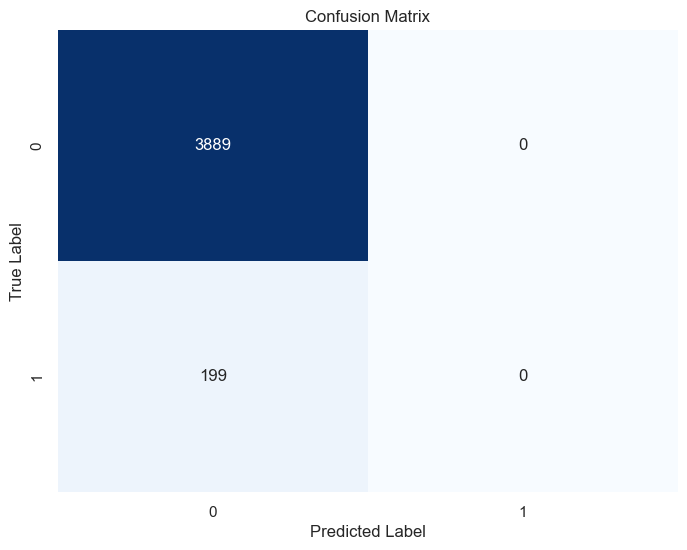

In [51]:
get_study_reports(study_lgb, lgb_xgb_prep, LGBMClassifier, get_best_params_rf(study_lgb))

Okay, so the model seems to either completely overfit the training data or ignore the minority class. We will try the same balancing approach as we will later do with XGBoost. We will also change some hyperparameter ranges. Let's define another function:

In [52]:
def optimize_lgb_with_preprocessor_v2(preprocessor, X_train, y_train, n_trials=300, feature_engineering=None):
    
    def objective(trial):
        boosting_type = trial.suggest_categorical('boosting_type', ['gbdt', 'dart', 'goss'])

        n_estimators = trial.suggest_int('n_estimators', 10, 300)
        learning_rate = trial.suggest_float('learning_rate', 0.01, 0.3)
        max_depth = trial.suggest_int('max_depth', 1, 20)
        num_leaves = trial.suggest_int('num_leaves', 2, 150)
        min_child_samples = trial.suggest_int('min_child_samples', 1, 100)
        subsample = trial.suggest_float('subsample', 0.1, 1.0)
        colsample_bytree = trial.suggest_float('colsample_bytree', 0.2, 1.0)
        reg_alpha = trial.suggest_float('reg_alpha', 0.0, 0.5)
        reg_lambda = trial.suggest_float('reg_lambda', 0.0, 0.5)

        lgb = lgbm.LGBMClassifier(
            boosting_type=boosting_type,
            objective='binary',
            n_estimators=n_estimators,
            learning_rate=learning_rate,
            max_depth=max_depth,
            num_leaves=num_leaves,
            min_child_samples=min_child_samples,
            subsample=subsample,
            colsample_bytree=colsample_bytree,
            reg_alpha=reg_alpha,
            reg_lambda=reg_lambda,
            scale_pos_weight = sum(y_train == 0) / sum(y_train == 1),
            random_state=42,
            verbosity=-1
        )

        steps = []
        if feature_engineering is not None:
            steps.append(('feature_engineering', feature_engineering))

        steps.append(('preprocessor', preprocessor))
        steps.append(('clf', lgb))

        lgb_pipeline = Pipeline(steps)

        cv_scores = cross_val_score(lgb_pipeline, X_train, y_train, cv=5, scoring=make_scorer(average_precision_scorer))
        return np.mean(cv_scores)

    study = optuna.create_study(direction='maximize')
    study.optimize(objective, n_trials=n_trials, n_jobs=-1)

    return study

def get_best_params_lgb_2(study):
    best_params = study.best_params
    best_params['objectice'] = 'binary'
    best_params['metric'] = 'aucpr'
    best_params['random_state'] = 42
    best_params['scale_pos_weight'] = sum(y_train == 0) / sum(y_train == 1)
    best_params['verbosity'] = -1
    return best_params

In [53]:
study_lgb_2 = optimize_lgb_with_preprocessor_v2(lgb_xgb_prep, X_train, y_train, n_trials=300)

[I 2024-10-06 19:27:29,045] A new study created in memory with name: no-name-444044c7-7599-4b2c-afa1-48d225a98b88
[I 2024-10-06 19:27:29,764] Trial 2 finished with value: 0.0486788985883712 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 20, 'learning_rate': 0.022911434987197103, 'max_depth': 14, 'num_leaves': 129, 'min_child_samples': 58, 'subsample': 0.6656947886705149, 'colsample_bytree': 0.8535921538587914, 'reg_alpha': 0.3312782208324001, 'reg_lambda': 0.18233182395316022}. Best is trial 2 with value: 0.0486788985883712.
[I 2024-10-06 19:27:30,210] Trial 3 finished with value: 0.10453538733215859 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 127, 'learning_rate': 0.2516628451506482, 'max_depth': 3, 'num_leaves': 55, 'min_child_samples': 44, 'subsample': 0.6049069505380018, 'colsample_bytree': 0.30183062345790534, 'reg_alpha': 0.41902551181103037, 'reg_lambda': 0.21358408495764852}. Best is trial 3 with value: 0.10453538733215859.
[I 2024-10-06 19:27:31,370] T

Cross-validation scores: [0.09013666 0.16203835 0.12908454 0.172393   0.15610418]
Mean PR AUC score: 0.14195134355454275
Standard deviation of PR AUC scores: 0.029600004030077086
The test accuracy score of the best model is 0.88
The test balanced accuracy score of the best model is 0.93


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       1.00      0.87      0.93      3889\n'
 '           1       0.28      0.98      0.44       199\n'
 '\n'
 '    accuracy                           0.88      4088\n'
 '   macro avg       0.64      0.93      0.68      4088\n'
 'weighted avg       0.96      0.88      0.91      4088\n')


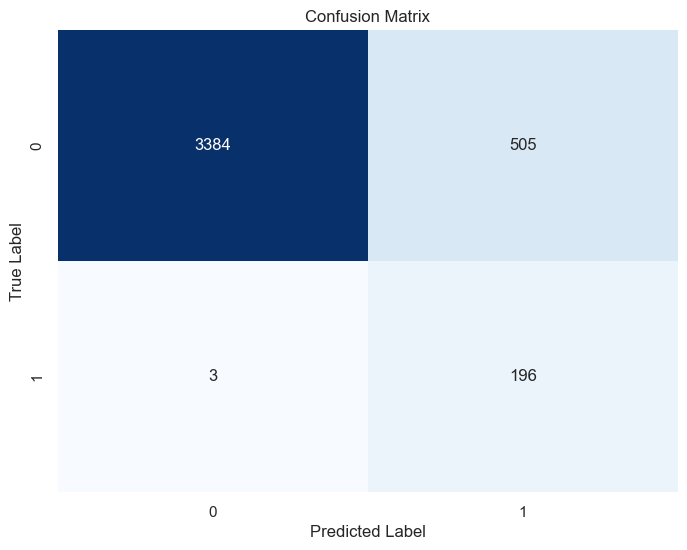

In [54]:
get_study_reports(study_lgb_2, lgb_xgb_prep, LGBMClassifier, get_best_params_lgb_2(study_lgb_2))

- Both models produce similar results for TP class.
- LightGBM produces less false positives.

XGBoost:

In [55]:
study_xbg = optimize_xgb_with_preprocessor(lgb_xgb_prep, X_train, y_train, n_trials=300)

[I 2024-10-06 19:32:22,248] A new study created in memory with name: no-name-5fba0d37-5e3b-4930-92af-f6810a403e9f
[I 2024-10-06 19:32:24,142] Trial 1 finished with value: 0.11626741764611323 and parameters: {'n_estimators': 22, 'learning_rate': 0.11070359064236443, 'max_depth': 13, 'min_child_weight': 7, 'subsample': 0.16094474989644764, 'colsample_bytree': 0.8463641445782795, 'gamma': 0.4549741133488652}. Best is trial 1 with value: 0.11626741764611323.
[I 2024-10-06 19:32:25,264] Trial 0 finished with value: 0.10029466785717485 and parameters: {'n_estimators': 25, 'learning_rate': 0.032029014364133496, 'max_depth': 15, 'min_child_weight': 2, 'subsample': 0.880486247172373, 'colsample_bytree': 0.7265738774821422, 'gamma': 0.910933136776312}. Best is trial 1 with value: 0.11626741764611323.
[I 2024-10-06 19:32:26,927] Trial 3 finished with value: 0.0839727048936369 and parameters: {'n_estimators': 69, 'learning_rate': 0.24981108969336857, 'max_depth': 14, 'min_child_weight': 4, 'subsam

Cross-validation scores: [0.10215542 0.14180687 0.10789487 0.1693042  0.16940334]
Mean PR AUC score: 0.13811294008573005
Standard deviation of PR AUC scores: 0.028884958657461133
The test accuracy score of the best model is 0.89
The test balanced accuracy score of the best model is 0.87


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.90      0.94      3889\n'
 '           1       0.29      0.83      0.44       199\n'
 '\n'
 '    accuracy                           0.89      4088\n'
 '   macro avg       0.64      0.87      0.69      4088\n'
 'weighted avg       0.96      0.89      0.92      4088\n')


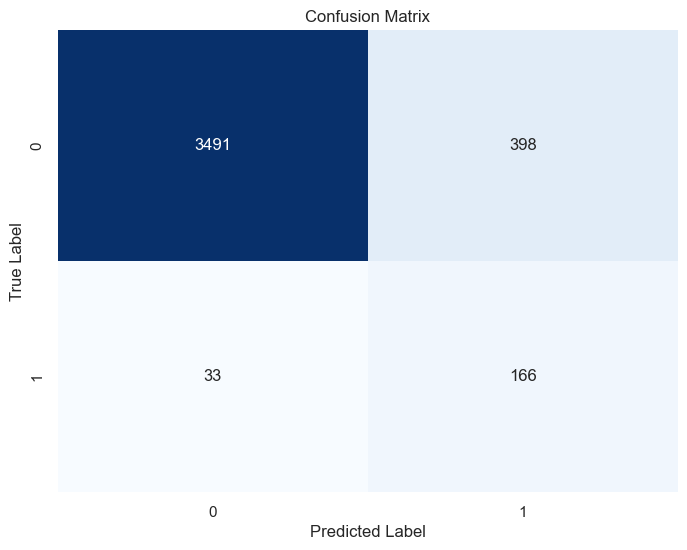

In [56]:
get_study_reports(study_xbg, lgb_xgb_prep, XGBClassifier, get_best_params_xgb(study_xbg))

- XGBoost produces a slightly worse classification.
- However, we also have a few more false negatives.

We can try to engineer some features to potentially improve the performance of our model. First thing that comes to mind is introducing a feature which is a count of how many symptoms which predict stroke are present in a patient. This approach directly corresponds to how patients are diagnosed by medical professionals.

In [57]:
X_train.head(0)

,gender,age,hypertension,heart_disease,ever_married,work_type,Residence_type,avg_glucose_level,bmi,smoking_status


So we could engineer a feature:
- age > 40
- hypertension = 1
- heart_disease = 1
- avg_gluose level > 126 (theshold for diabetes)
- Formerly smoked (since stroke correlated with age and smoking negatively correlates with age, it seems that using former smokers makes more sense)
We can add +1 to the feature making it ordinal or make it binary. For now let's try to make it binary so that if there are 2/5 symptoms the feature is 1.

Let's try it on XGBoost which gave more overall balanced results:

In [58]:
study_xbg_2 = optimize_xgb_with_preprocessor(lgb_xgb_prep, X_train, y_train, n_trials=300, feature_engineering=MoreThanTwoFeature())

[I 2024-10-06 19:38:54,441] A new study created in memory with name: no-name-ada833f4-1705-4172-b403-07a2867001fc
[I 2024-10-06 19:38:55,697] Trial 2 finished with value: 0.09218527825606822 and parameters: {'n_estimators': 30, 'learning_rate': 0.0216104680477906, 'max_depth': 22, 'min_child_weight': 2, 'subsample': 0.8520840955687428, 'colsample_bytree': 0.2874948521244326, 'gamma': 0.8148202514739988}. Best is trial 2 with value: 0.09218527825606822.
[I 2024-10-06 19:38:56,046] Trial 3 finished with value: 0.07456280900976893 and parameters: {'n_estimators': 47, 'learning_rate': 0.1493173533873958, 'max_depth': 11, 'min_child_weight': 2, 'subsample': 0.7309855074598326, 'colsample_bytree': 0.7621293409360399, 'gamma': 0.8347329886592424}. Best is trial 2 with value: 0.09218527825606822.
[I 2024-10-06 19:38:56,733] Trial 5 finished with value: 0.11119533164082593 and parameters: {'n_estimators': 15, 'learning_rate': 0.15027069287680814, 'max_depth': 12, 'min_child_weight': 4, 'subsamp

Cross-validation scores: [0.11704247 0.12971304 0.12108091 0.16022194 0.15936693]
Mean PR AUC score: 0.1374850573179258
Standard deviation of PR AUC scores: 0.01867180652635444
The test accuracy score of the best model is 0.90
The test balanced accuracy score of the best model is 0.87


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.90      0.94      3889\n'
 '           1       0.30      0.84      0.44       199\n'
 '\n'
 '    accuracy                           0.90      4088\n'
 '   macro avg       0.64      0.87      0.69      4088\n'
 'weighted avg       0.96      0.90      0.92      4088\n')


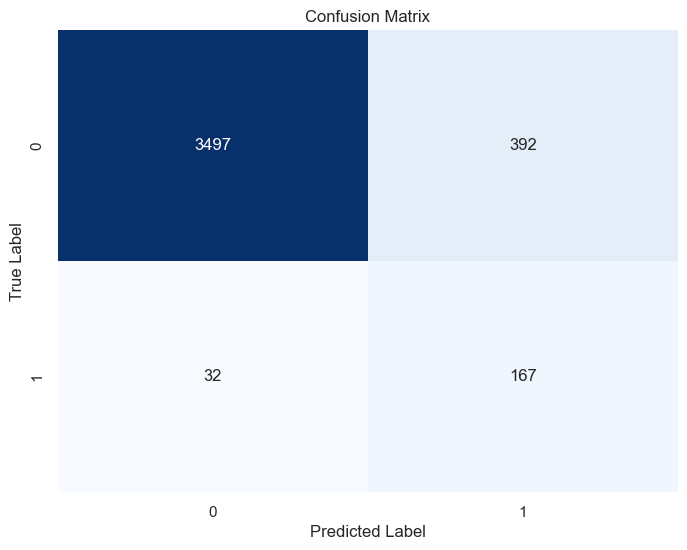

In [59]:
get_study_reports(study_xbg_2, lgb_xgb_prep,
                  XGBClassifier, get_best_params_xgb(study_xbg),
                  feature_engineering=MoreThanTwoFeature())

- Slightly worse performance.

Let's see how this feature works on LightGBM:

In [60]:
study_lgb_3 = optimize_lgb_with_preprocessor_v2(lgb_xgb_prep, X_train,
                                                y_train, n_trials=300,
                                                feature_engineering=MoreThanTwoFeature())

[I 2024-10-06 19:41:26,941] A new study created in memory with name: no-name-35033571-9fd1-40ef-8ba1-d0216173311a
[I 2024-10-06 19:41:29,391] Trial 0 finished with value: 0.12471156176139644 and parameters: {'boosting_type': 'goss', 'n_estimators': 158, 'learning_rate': 0.04185981212555683, 'max_depth': 13, 'num_leaves': 102, 'min_child_samples': 60, 'subsample': 0.22044627181545323, 'colsample_bytree': 0.4932477228051155, 'reg_alpha': 0.1927822919427123, 'reg_lambda': 0.1317568195741946}. Best is trial 0 with value: 0.12471156176139644.
[I 2024-10-06 19:41:29,479] Trial 2 finished with value: 0.08445450265244278 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 164, 'learning_rate': 0.2600261864552512, 'max_depth': 16, 'num_leaves': 14, 'min_child_samples': 68, 'subsample': 0.19045395517471908, 'colsample_bytree': 0.767419494156101, 'reg_alpha': 0.48433538390115105, 'reg_lambda': 0.3321563298347985}. Best is trial 0 with value: 0.12471156176139644.
[I 2024-10-06 19:41:30,094] 

Cross-validation scores: [0.10603267 0.14892162 0.1320599  0.16907703 0.16171187]
Mean PR AUC score: 0.14356061782299126
Standard deviation of PR AUC scores: 0.022582777065456795
The test accuracy score of the best model is 0.85
The test balanced accuracy score of the best model is 0.85


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.85      0.92      3889\n'
 '           1       0.23      0.84      0.36       199\n'
 '\n'
 '    accuracy                           0.85      4088\n'
 '   macro avg       0.61      0.85      0.64      4088\n'
 'weighted avg       0.95      0.85      0.89      4088\n')


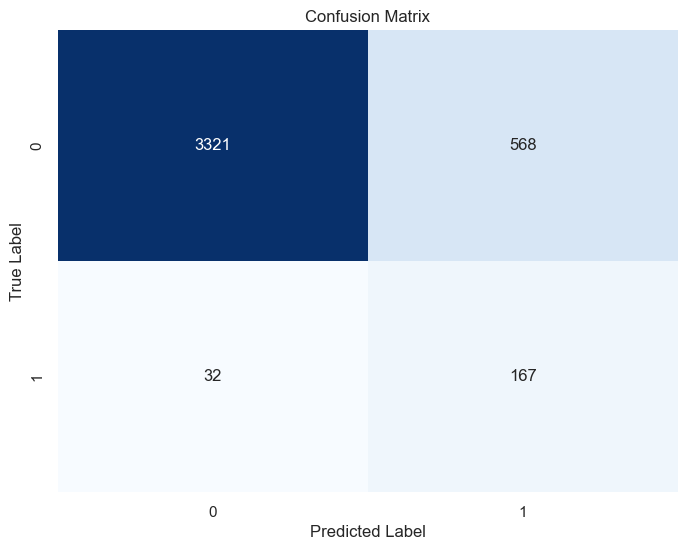

In [61]:
get_study_reports(study_lgb_3, lgb_xgb_prep, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_3),
                  feature_engineering=MoreThanTwoFeature())

- We seem to get a worse performance for both models.
- Since we are introducing new information into the model and since the variance in the cross validation is not so large it seems that a logical explanation would be that the new feature is introducing multicollinearity.

Let's go back to the best-performing model so far. In we would like to somehow reduce the amount of type I errors it makes. 

In [62]:
best_lgb = get_study_reports(study_lgb_2, lgb_xgb_prep,
                             LGBMClassifier, get_best_params_lgb_2(study_lgb_2),
                            return_pipeline=True)

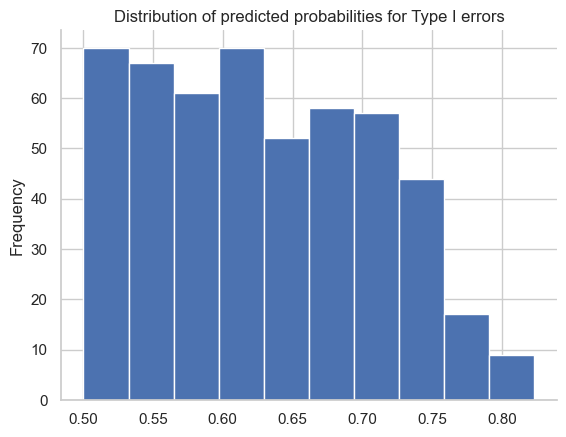

In [63]:
results = pd.DataFrame(dict(predicted_probability = best_lgb.predict_proba(X_train)[:, 1],
                  predicted_class = best_lgb.predict(X_train),
                  true_class = y_train))
(results[(results['predicted_class'] == 1) & (results['true_class'] == 0)]
 ['predicted_probability']
 .plot(kind='hist',
       title='Distribution of predicted probabilities for Type I errors'));

Perhaps we could take the approach of adjusting the classification threshold.

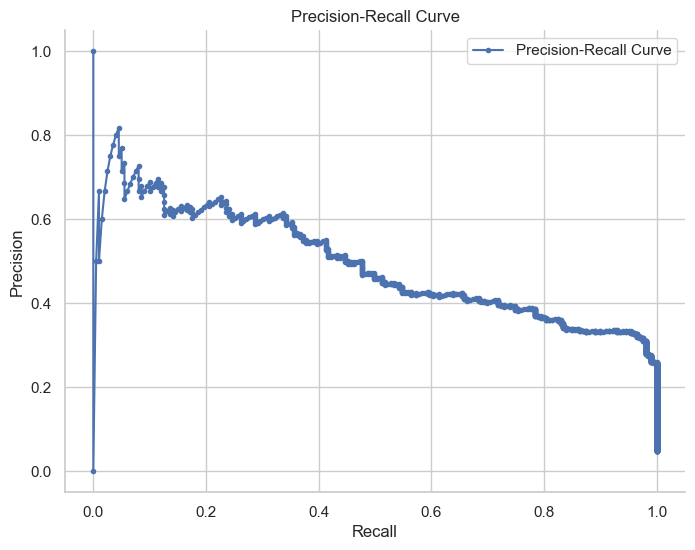

In [97]:
from sklearn.metrics import precision_recall_curve, auc

precision, recall, thresholds = precision_recall_curve(y_train,
                    best_lgb.predict_proba(X_train)[:, 1])

plt.figure(figsize=(8, 6))
plt.plot(recall, precision, marker='.', label='Precision-Recall Curve')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.legend()
plt.grid(True)
plt.show()

Doesn't seem like we can get a 'cheap' way to fix the FP rate.

Perhaps the model would benefit from simplifying the information. We will try to bin the values.

In [104]:
from sklearn.preprocessing import KBinsDiscretizer

preprocessor_binned = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        ('bin_age', KBinsDiscretizer(n_bins=8, encode='onehot', strategy='uniform'), ['age']),
        ('impute_bmi_then_bin', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='mean')),
            ('bin_bmi', KBinsDiscretizer(n_bins=4, encode='onehot', strategy='quantile'))
        ]), ['bmi']),
        ('bin_glucose', KBinsDiscretizer(n_bins=4, encode='onehot', strategy='quantile'), ['avg_glucose_level']),
    ],
    remainder='passthrough'
)

In [105]:
study_lgb_bin = optimize_lgb_with_preprocessor_v2(preprocessor_binned, X_train, y_train, n_trials=300)

[I 2024-10-06 21:33:24,672] A new study created in memory with name: no-name-64405fd0-eb3e-45e6-b060-4909f3ceb0f6
[I 2024-10-06 21:33:27,032] Trial 1 finished with value: 0.1025879760071211 and parameters: {'boosting_type': 'goss', 'n_estimators': 152, 'learning_rate': 0.2033085420600396, 'max_depth': 10, 'num_leaves': 93, 'min_child_samples': 77, 'subsample': 0.3232003503369415, 'colsample_bytree': 0.55976561102168, 'reg_alpha': 0.4667326483013899, 'reg_lambda': 0.40488013096112974}. Best is trial 1 with value: 0.1025879760071211.
[I 2024-10-06 21:33:27,130] Trial 2 finished with value: 0.10766217773716433 and parameters: {'boosting_type': 'dart', 'n_estimators': 84, 'learning_rate': 0.05853066983444577, 'max_depth': 7, 'num_leaves': 91, 'min_child_samples': 71, 'subsample': 0.6068362888707806, 'colsample_bytree': 0.43749889875785153, 'reg_alpha': 0.32753528648014335, 'reg_lambda': 0.10202472111095134}. Best is trial 2 with value: 0.10766217773716433.
[I 2024-10-06 21:33:27,143] Trial

Cross-validation scores: [0.10186637 0.11384499 0.12529415 0.14631095 0.10677772]
Mean PR AUC score: 0.11881883542880152
Standard deviation of PR AUC scores: 0.01584209293600265
The test accuracy score of the best model is 0.71
The test balanced accuracy score of the best model is 0.77


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.71      0.82      3889\n'
 '           1       0.13      0.84      0.22       199\n'
 '\n'
 '    accuracy                           0.71      4088\n'
 '   macro avg       0.56      0.77      0.52      4088\n'
 'weighted avg       0.95      0.71      0.80      4088\n')


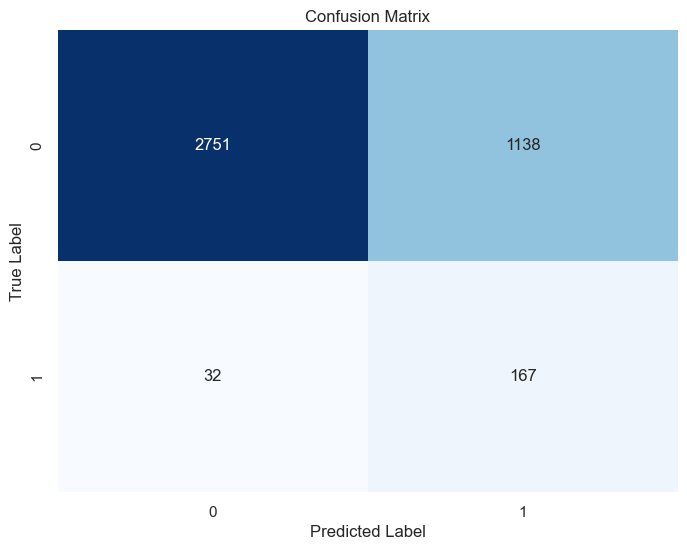

In [106]:
get_study_reports(study_lgb_bin, preprocessor_binned, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bin))

So binning seems to have been detrimental to the model. Let's try to analyze the best model with SHAP:

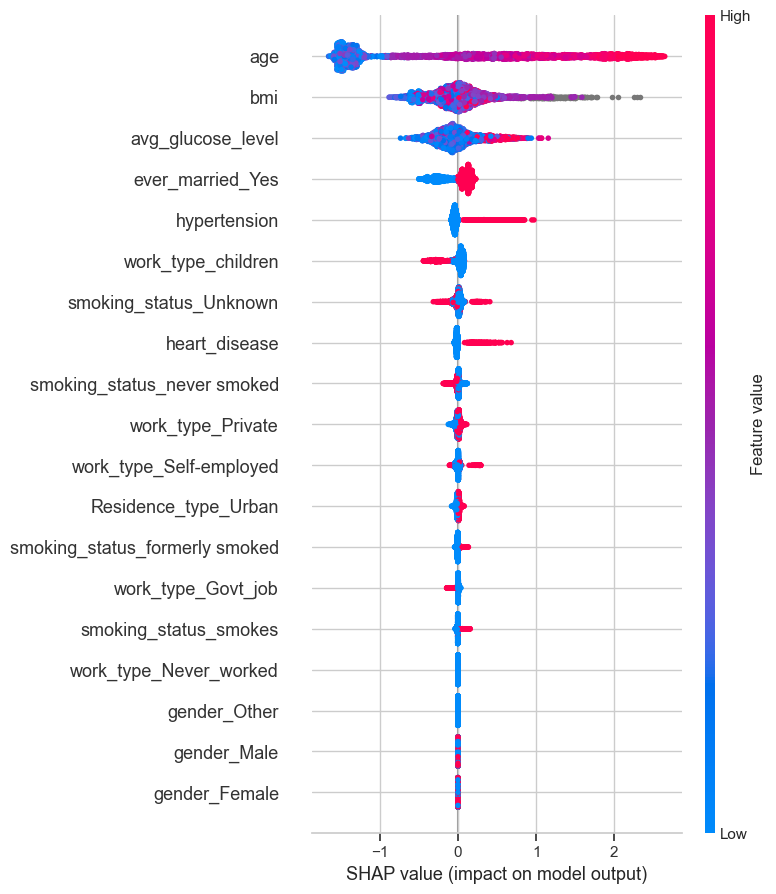

In [114]:
import shap

lgm_pipeline_best = get_study_reports(study_lgb_2, lgb_xgb_prep,
                                      LGBMClassifier, get_best_params_lgb_2(study_lgb_2),
                                      return_pipeline=True)

lgb_model_best = lgm_pipeline_best.named_steps['clf']

X_train_transformed = lgm_pipeline_best.named_steps['preprocessor'].transform(X_train)

ohe = lgm_pipeline_best.named_steps['preprocessor'].named_transformers_['cat']
ohe_feature_names = ohe.get_feature_names_out(['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status'])

passthrough_features = ['age', 'hypertension', 'heart_disease', 'avg_glucose_level', 'bmi']

feature_names = np.concatenate([ohe_feature_names, passthrough_features])

explainer = shap.Explainer(lgb_model_best)

shap_values = explainer(X_train_transformed)

shap.summary_plot(shap_values, X_train_transformed, feature_names=feature_names)

- We see quite an erratic behaviour for bmi.\
- We can try to bin bmi.
- We can try to include polynomial features.

In [115]:
preprocessor_bmi_bin = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        
        ('impute_bmi_then_bin', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='mean')),
            ('bin_bmi', KBinsDiscretizer(n_bins=4, encode='onehot', strategy='quantile'))
        ]), ['bmi']),
    ],
    remainder='passthrough'
)

In [116]:
study_lgb_bmi_bin = optimize_lgb_with_preprocessor_v2(preprocessor_bmi_bin, X_train, y_train, n_trials=300)

[I 2024-10-06 22:11:00,722] A new study created in memory with name: no-name-92ad1750-412a-4275-9a21-86a358fc576b
[I 2024-10-06 22:11:02,775] Trial 3 finished with value: 0.09873293358262072 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 73, 'learning_rate': 0.016316077754081535, 'max_depth': 13, 'num_leaves': 85, 'min_child_samples': 49, 'subsample': 0.9740037809245741, 'colsample_bytree': 0.3801568295098542, 'reg_alpha': 0.10182730156899272, 'reg_lambda': 0.2579954867558431}. Best is trial 3 with value: 0.09873293358262072.
[I 2024-10-06 22:11:03,405] Trial 2 finished with value: 0.0837190601962002 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 133, 'learning_rate': 0.28041659826890386, 'max_depth': 7, 'num_leaves': 117, 'min_child_samples': 26, 'subsample': 0.4885203576119582, 'colsample_bytree': 0.2144069772399093, 'reg_alpha': 0.33922673479287324, 'reg_lambda': 0.3265746776951878}. Best is trial 3 with value: 0.09873293358262072.
[I 2024-10-06 22:11:04,117] T

Cross-validation scores: [0.13051506 0.16256091 0.11453997 0.11322289 0.14266077]
Mean PR AUC score: 0.13269991899545575
Standard deviation of PR AUC scores: 0.018465152029002403
The test accuracy score of the best model is 0.88
The test balanced accuracy score of the best model is 0.87


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.88      0.93      3889\n'
 '           1       0.26      0.86      0.40       199\n'
 '\n'
 '    accuracy                           0.88      4088\n'
 '   macro avg       0.63      0.87      0.67      4088\n'
 'weighted avg       0.96      0.88      0.90      4088\n')


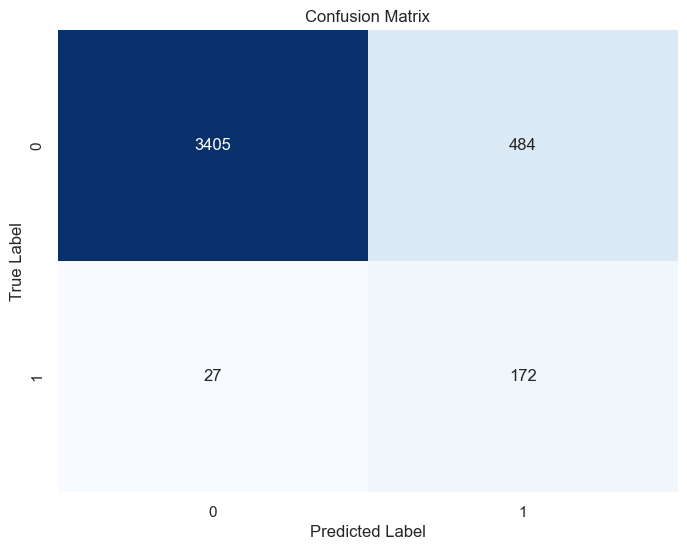

In [117]:
get_study_reports(study_lgb_bmi_bin, preprocessor_bmi_bin, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_bin))

- Binning doesn't work out so well. At least with this strategy.\
Let's try to include a 2nd degree polynomial:

In [118]:
preprocessor_bmi_poly = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        ('impute_bmi_then_poly', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='mean')),
            ('poly_bmi', PolynomialFeatures(degree=2, include_bias=False))
        ]), ['bmi']),
    ],
    remainder='passthrough'
)

In [119]:
study_lgb_bmi_poly = optimize_lgb_with_preprocessor_v2(preprocessor_bmi_poly, X_train, y_train, n_trials=300)

[I 2024-10-06 22:21:09,071] A new study created in memory with name: no-name-21919999-5d3a-4033-9365-d9f56d3467a8
[I 2024-10-06 22:21:10,237] Trial 3 finished with value: 0.11965726487201638 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 42, 'learning_rate': 0.04746588259585256, 'max_depth': 20, 'num_leaves': 20, 'min_child_samples': 97, 'subsample': 0.21718836007104622, 'colsample_bytree': 0.6941803285752692, 'reg_alpha': 0.38379730879527896, 'reg_lambda': 0.005024114353185782}. Best is trial 3 with value: 0.11965726487201638.
[I 2024-10-06 22:21:10,836] Trial 0 finished with value: 0.11533307682658434 and parameters: {'boosting_type': 'dart', 'n_estimators': 158, 'learning_rate': 0.015803077207198424, 'max_depth': 2, 'num_leaves': 83, 'min_child_samples': 22, 'subsample': 0.2059744204125488, 'colsample_bytree': 0.8595851419493983, 'reg_alpha': 0.25822493255902573, 'reg_lambda': 0.234129491802621}. Best is trial 3 with value: 0.11965726487201638.
[I 2024-10-06 22:21:12,063]

Cross-validation scores: [0.11134388 0.14311328 0.13319268 0.14252921 0.14268123]
Mean PR AUC score: 0.13457205741501552
Standard deviation of PR AUC scores: 0.012194083414669545
The test accuracy score of the best model is 0.80
The test balanced accuracy score of the best model is 0.83


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.80      0.88      3889\n'
 '           1       0.18      0.86      0.30       199\n'
 '\n'
 '    accuracy                           0.80      4088\n'
 '   macro avg       0.58      0.83      0.59      4088\n'
 'weighted avg       0.95      0.80      0.86      4088\n')


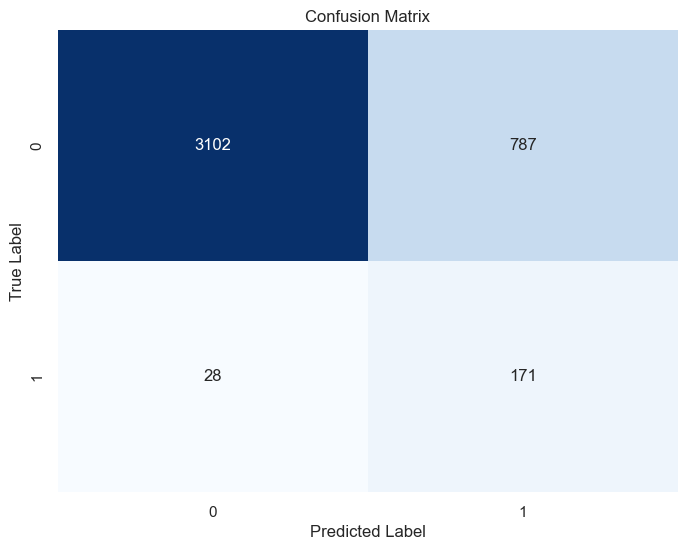

In [120]:
get_study_reports(study_lgb_bmi_poly, preprocessor_bmi_poly, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_poly))

Let's try to see the SHAP values once more, bust only for False Positives.

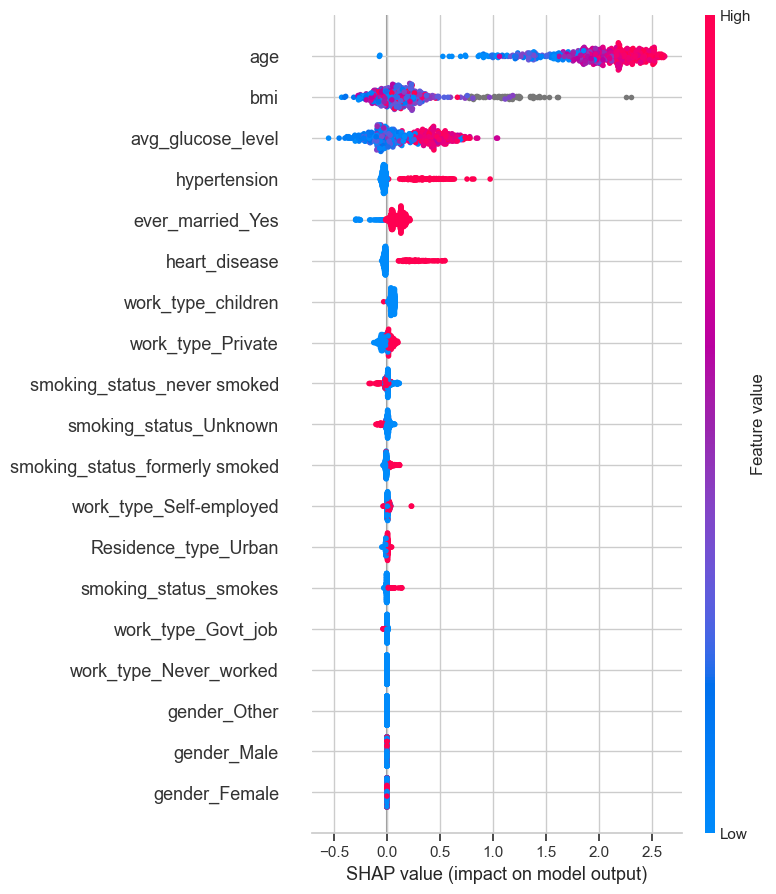

In [134]:
y_train_pred_fp_analysis = lgm_pipeline_best.predict(X_train)
false_positives_indices = np.where((y_train_pred_fp_analysis == 1) & (y_train == 0))[0]
shap_values_false_positives = shap_values[false_positives_indices]
X_train_transformed_false_positives = X_train_transformed[false_positives_indices]
shap.summary_plot(shap_values_false_positives, X_train_transformed_false_positives, feature_names=feature_names)

- bmi is pushed heavily by missing values.

Imputing bmi with the mean:

In [136]:
preprocessor_bmi_imputation = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        ('impute_bmi', SimpleImputer(strategy='mean'), ['bmi']),
    ],
    remainder='passthrough'
)

In [137]:
study_lgb_bmi_imp = optimize_lgb_with_preprocessor_v2(preprocessor_bmi_imputation, X_train, y_train, n_trials=300)

[I 2024-10-06 22:46:40,673] A new study created in memory with name: no-name-c558538f-5564-45a9-a425-285888233624
[I 2024-10-06 22:46:43,226] Trial 3 finished with value: 0.12049469288965904 and parameters: {'boosting_type': 'goss', 'n_estimators': 107, 'learning_rate': 0.08485361225947807, 'max_depth': 16, 'num_leaves': 70, 'min_child_samples': 79, 'subsample': 0.39099687741206457, 'colsample_bytree': 0.647726471415163, 'reg_alpha': 0.2674705259897906, 'reg_lambda': 0.13544741757931011}. Best is trial 3 with value: 0.12049469288965904.
[I 2024-10-06 22:46:47,179] Trial 1 finished with value: 0.10905044503498385 and parameters: {'boosting_type': 'gbdt', 'n_estimators': 192, 'learning_rate': 0.04737207224055907, 'max_depth': 7, 'num_leaves': 98, 'min_child_samples': 45, 'subsample': 0.7034767714880755, 'colsample_bytree': 0.38743660502596544, 'reg_alpha': 0.051979602352187015, 'reg_lambda': 0.03983355475342154}. Best is trial 3 with value: 0.12049469288965904.
[I 2024-10-06 22:46:49,868

Cross-validation scores: [0.09466508 0.14750813 0.1320809  0.14979775 0.1456966 ]
Mean PR AUC score: 0.1339496902280079
Standard deviation of PR AUC scores: 0.02059007112769839
The test accuracy score of the best model is 0.84
The test balanced accuracy score of the best model is 0.91


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       1.00      0.83      0.91      3889\n'
 '           1       0.23      0.99      0.38       199\n'
 '\n'
 '    accuracy                           0.84      4088\n'
 '   macro avg       0.62      0.91      0.64      4088\n'
 'weighted avg       0.96      0.84      0.88      4088\n')


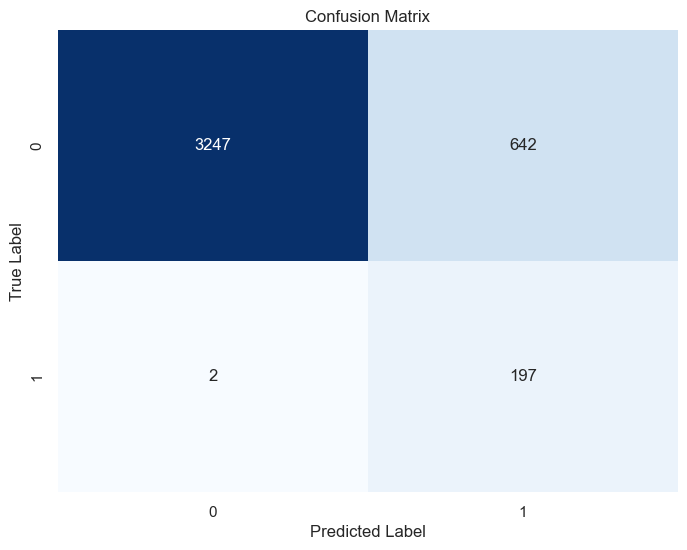

In [138]:
get_study_reports(study_lgb_bmi_imp, preprocessor_bmi_imputation, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_imp))

- Slightly worse performance than the best model.

In [139]:
preprocessor_bmi_knn_imputation = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        ('impute_bmi', KNNImputer(n_neighbors=5), ['bmi']),
    ],
    remainder='passthrough'
)

In [140]:
study_lgb_bmi_imp_knn = optimize_lgb_with_preprocessor_v2(preprocessor_bmi_knn_imputation, X_train, y_train, n_trials=300)

[I 2024-10-06 23:01:16,000] A new study created in memory with name: no-name-dd6cb8cd-4f9a-44be-871b-8a4e5d0c16f4
[I 2024-10-06 23:01:19,959] Trial 3 finished with value: 0.11155470494894067 and parameters: {'boosting_type': 'dart', 'n_estimators': 97, 'learning_rate': 0.15351784011734457, 'max_depth': 7, 'num_leaves': 101, 'min_child_samples': 37, 'subsample': 0.4556086542523451, 'colsample_bytree': 0.46240852673810684, 'reg_alpha': 0.34230922828880994, 'reg_lambda': 0.41904027484391354}. Best is trial 3 with value: 0.11155470494894067.
[I 2024-10-06 23:01:20,267] Trial 0 finished with value: 0.11463067221159036 and parameters: {'boosting_type': 'dart', 'n_estimators': 129, 'learning_rate': 0.0677716072045512, 'max_depth': 5, 'num_leaves': 88, 'min_child_samples': 27, 'subsample': 0.19833384812020838, 'colsample_bytree': 0.7314367908879567, 'reg_alpha': 0.3514495207079697, 'reg_lambda': 0.0682253499354224}. Best is trial 0 with value: 0.11463067221159036.
[I 2024-10-06 23:01:21,849] T

Cross-validation scores: [0.12650725 0.14597436 0.13450755 0.13419669 0.14008081]
Mean PR AUC score: 0.1362533310374241
Standard deviation of PR AUC scores: 0.006502484050212865
The test accuracy score of the best model is 0.81
The test balanced accuracy score of the best model is 0.84


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.81      0.89      3889\n'
 '           1       0.19      0.87      0.31       199\n'
 '\n'
 '    accuracy                           0.81      4088\n'
 '   macro avg       0.59      0.84      0.60      4088\n'
 'weighted avg       0.95      0.81      0.86      4088\n')


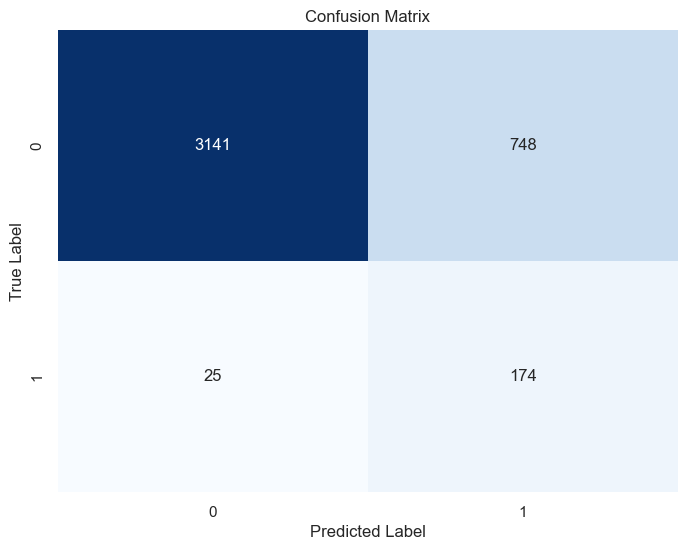

In [141]:
get_study_reports(study_lgb_bmi_imp_knn, preprocessor_bmi_knn_imputation, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_imp_knn))

In [143]:
from sklearn.preprocessing import FunctionTransformer

log_transformer = FunctionTransformer(func=np.log1p, feature_names_out='one-to-one')

preprocessor_bmi_log_imputation = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        ('impute_bmi_then_log', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='mean')),
            ('log_bmi', log_transformer)
        ]), ['bmi']),
    ],
    remainder='passthrough'
)

In [144]:
study_lgb_bmi_log = optimize_lgb_with_preprocessor_v2(preprocessor_bmi_log_imputation, X_train, y_train, n_trials=300)

[I 2024-10-06 23:11:57,337] A new study created in memory with name: no-name-35903229-de20-4b4e-950b-0ea8fff782be
[I 2024-10-06 23:11:58,375] Trial 3 finished with value: 0.11614678781964023 and parameters: {'boosting_type': 'dart', 'n_estimators': 60, 'learning_rate': 0.1829063320511396, 'max_depth': 3, 'num_leaves': 16, 'min_child_samples': 62, 'subsample': 0.5767827214921076, 'colsample_bytree': 0.5312100040664884, 'reg_alpha': 0.3854403572052592, 'reg_lambda': 0.21792034467222798}. Best is trial 3 with value: 0.11614678781964023.
[I 2024-10-06 23:11:58,654] Trial 0 finished with value: 0.11904329306083813 and parameters: {'boosting_type': 'goss', 'n_estimators': 52, 'learning_rate': 0.05694259034770562, 'max_depth': 7, 'num_leaves': 51, 'min_child_samples': 69, 'subsample': 0.7668462764496747, 'colsample_bytree': 0.31357842165843464, 'reg_alpha': 0.06863502670950777, 'reg_lambda': 0.03277415970582237}. Best is trial 0 with value: 0.11904329306083813.
[I 2024-10-06 23:11:59,650] Tri

Cross-validation scores: [0.10562791 0.1552345  0.12757243 0.14518407 0.14324784]
Mean PR AUC score: 0.13537335012583274
Standard deviation of PR AUC scores: 0.017311085870076806
The test accuracy score of the best model is 0.85
The test balanced accuracy score of the best model is 0.92


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       1.00      0.84      0.91      3889\n'
 '           1       0.25      1.00      0.39       199\n'
 '\n'
 '    accuracy                           0.85      4088\n'
 '   macro avg       0.62      0.92      0.65      4088\n'
 'weighted avg       0.96      0.85      0.89      4088\n')


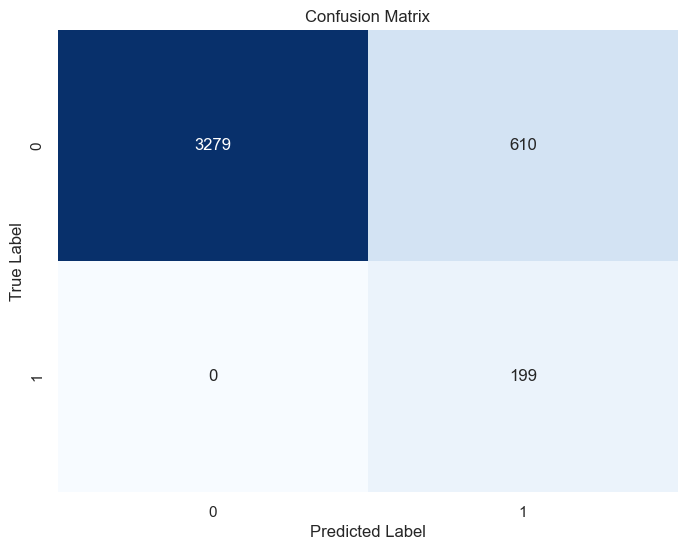

In [145]:
get_study_reports(study_lgb_bmi_log, preprocessor_bmi_log_imputation, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_log))

- We seem to get some little improvement by loging BMI.\
Let's try to apply some transforms to avg_glucose_level.

In [146]:
preprocessor_bmi_glucose_log = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        
        ('impute_bmi_then_log', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='mean')),
            ('log_bmi', log_transformer)
        ]), ['bmi']),
        
        ('log_glucose', log_transformer, ['avg_glucose_level']),
    ],
    remainder='passthrough'
)

In [147]:
study_lgb_bmi_glucose_log = optimize_lgb_with_preprocessor_v2(
    preprocessor_bmi_glucose_log, X_train, y_train, n_trials=300)

[I 2024-10-06 23:24:59,431] A new study created in memory with name: no-name-63cce6e7-e946-4be7-a948-4a635f0c696f
[I 2024-10-06 23:25:02,766] Trial 0 finished with value: 0.11012531987258542 and parameters: {'boosting_type': 'goss', 'n_estimators': 266, 'learning_rate': 0.09138984641952162, 'max_depth': 3, 'num_leaves': 22, 'min_child_samples': 12, 'subsample': 0.6412332205590558, 'colsample_bytree': 0.6828689399959789, 'reg_alpha': 0.0672619955811199, 'reg_lambda': 0.03360652476053039}. Best is trial 0 with value: 0.11012531987258542.
[I 2024-10-06 23:25:02,988] Trial 2 finished with value: 0.11694142518273125 and parameters: {'boosting_type': 'goss', 'n_estimators': 138, 'learning_rate': 0.020028841620617847, 'max_depth': 7, 'num_leaves': 89, 'min_child_samples': 51, 'subsample': 0.48699227098258724, 'colsample_bytree': 0.4219473679439091, 'reg_alpha': 0.3864613535111989, 'reg_lambda': 0.17717240023166203}. Best is trial 2 with value: 0.11694142518273125.
[I 2024-10-06 23:25:03,174] 

Cross-validation scores: [0.10036615 0.14006585 0.12373266 0.13617153 0.15607764]
Mean PR AUC score: 0.13128276262115446
Standard deviation of PR AUC scores: 0.018593921677922922
The test accuracy score of the best model is 0.82
The test balanced accuracy score of the best model is 0.85


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       0.99      0.82      0.90      3889\n'
 '           1       0.20      0.89      0.33       199\n'
 '\n'
 '    accuracy                           0.82      4088\n'
 '   macro avg       0.60      0.85      0.61      4088\n'
 'weighted avg       0.95      0.82      0.87      4088\n')


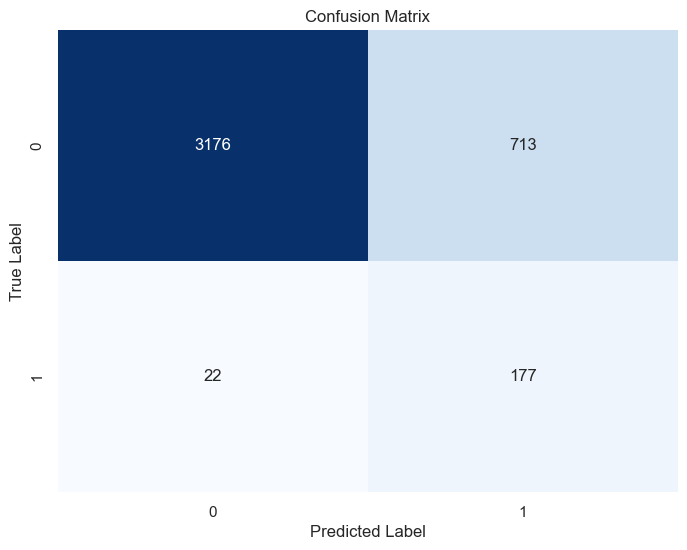

In [149]:
get_study_reports(study_lgb_bmi_glucose_log, preprocessor_bmi_glucose_log, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_glucose_log))

- Transforming avg_glucose level didn't seem to help much.

In [150]:
preprocessor_bmi_glucose_interaction = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(handle_unknown='ignore'),
        ['gender', 'ever_married', 'work_type', 'Residence_type', 'smoking_status']),
        
        ('impute_bmi_then_log', Pipeline(steps=[
            ('imputer', SimpleImputer(strategy='mean')),
            ('log_bmi', log_transformer)
        ]), ['bmi']),
        
        ('passthrough_age_glucose', 'passthrough', ['age', 'avg_glucose_level']),
        
        ('age_glucose_interaction', PolynomialFeatures(degree=2, interaction_only=True, include_bias=False)
         , ['age', 'avg_glucose_level']),
    ],
    remainder='passthrough'
)

In [151]:
study_lgb_bmi_glucose_interact = optimize_lgb_with_preprocessor_v2(
    preprocessor_bmi_glucose_interaction, X_train, y_train, n_trials=300)

[I 2024-10-06 23:38:33,142] A new study created in memory with name: no-name-29ada759-ab0f-4a67-8d54-d17de9b56519
[I 2024-10-06 23:38:37,122] Trial 0 finished with value: 0.08827214244299934 and parameters: {'boosting_type': 'goss', 'n_estimators': 113, 'learning_rate': 0.29456706369155056, 'max_depth': 17, 'num_leaves': 141, 'min_child_samples': 66, 'subsample': 0.4362865961033746, 'colsample_bytree': 0.7338509239296451, 'reg_alpha': 0.206855812111419, 'reg_lambda': 0.1945634409117737}. Best is trial 0 with value: 0.08827214244299934.
[I 2024-10-06 23:38:38,794] Trial 1 finished with value: 0.10992224914300561 and parameters: {'boosting_type': 'dart', 'n_estimators': 202, 'learning_rate': 0.2618503118930432, 'max_depth': 3, 'num_leaves': 136, 'min_child_samples': 65, 'subsample': 0.3602566043209976, 'colsample_bytree': 0.21710908481688113, 'reg_alpha': 0.4207337091392882, 'reg_lambda': 0.3639144325525942}. Best is trial 1 with value: 0.10992224914300561.
[I 2024-10-06 23:38:42,079] Tr

Cross-validation scores: [0.10108986 0.15928376 0.13032913 0.14069531 0.14623151]
Mean PR AUC score: 0.13552591399755662
Standard deviation of PR AUC scores: 0.0195888553581626
The test accuracy score of the best model is 0.88
The test balanced accuracy score of the best model is 0.93


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       1.00      0.87      0.93      3889\n'
 '           1       0.28      1.00      0.44       199\n'
 '\n'
 '    accuracy                           0.88      4088\n'
 '   macro avg       0.64      0.93      0.68      4088\n'
 'weighted avg       0.96      0.88      0.91      4088\n')


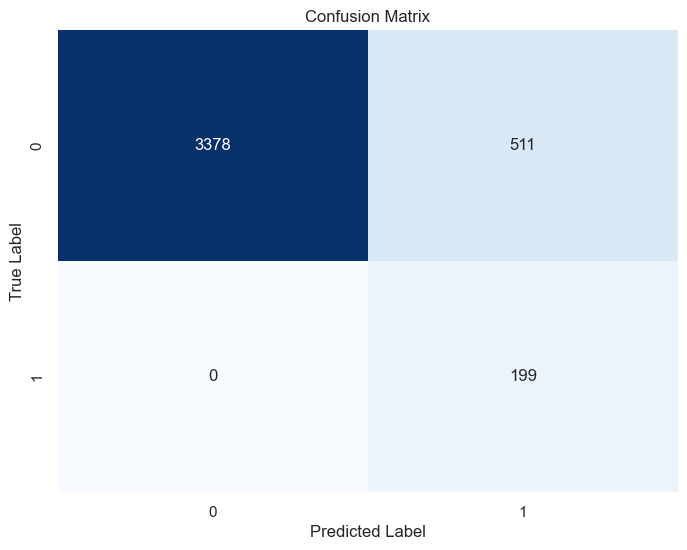

In [152]:
get_study_reports(study_lgb_bmi_glucose_interact, preprocessor_bmi_glucose_interaction, LGBMClassifier,
                  get_best_params_lgb_2(study_lgb_bmi_glucose_interact))

Okay, this seems to be the best setting so far. We will settle with this model. Now, lets tune it with many trials.

In [153]:
final_lgbm_study = optimize_lgb_with_preprocessor_v2(
    preprocessor_bmi_glucose_interaction, X_train, y_train, n_trials=3000)

[I 2024-10-06 23:49:24,976] A new study created in memory with name: no-name-efaf2241-8d49-4ca5-b47c-ae3623e25dca
[I 2024-10-06 23:49:27,898] Trial 1 finished with value: 0.12657590749282546 and parameters: {'boosting_type': 'dart', 'n_estimators': 80, 'learning_rate': 0.14756716154223448, 'max_depth': 8, 'num_leaves': 105, 'min_child_samples': 53, 'subsample': 0.903005011207969, 'colsample_bytree': 0.4810251168609221, 'reg_alpha': 0.2687507796446105, 'reg_lambda': 0.3832355601727651}. Best is trial 1 with value: 0.12657590749282546.
[I 2024-10-06 23:49:28,284] Trial 2 finished with value: 0.10864102610151387 and parameters: {'boosting_type': 'dart', 'n_estimators': 244, 'learning_rate': 0.04720862587310289, 'max_depth': 2, 'num_leaves': 41, 'min_child_samples': 37, 'subsample': 0.24767280892032004, 'colsample_bytree': 0.4645833182649119, 'reg_alpha': 0.23143479587170956, 'reg_lambda': 0.3296740019072513}. Best is trial 1 with value: 0.12657590749282546.
[I 2024-10-06 23:49:36,885] Tri

Cross-validation scores: [0.1153871  0.15197649 0.12915301 0.14315785 0.14712031]
Mean PR AUC score: 0.13735895394887748
Standard deviation of PR AUC scores: 0.013361764731487225
The test accuracy score of the best model is 0.86
The test balanced accuracy score of the best model is 0.93


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       1.00      0.85      0.92      3889\n'
 '           1       0.26      1.00      0.41       199\n'
 '\n'
 '    accuracy                           0.86      4088\n'
 '   macro avg       0.63      0.93      0.67      4088\n'
 'weighted avg       0.96      0.86      0.90      4088\n')


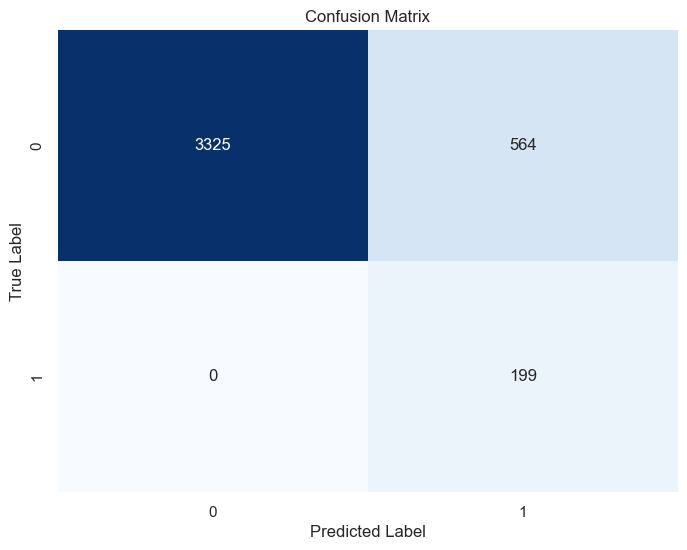

In [162]:
get_study_reports(final_lgbm_study, preprocessor_bmi_glucose_interaction, LGBMClassifier,
                  get_best_params_lgb_2(final_lgbm_study))

Hyperparameters:

In [165]:
final_lgbm_study.best_params

{'boosting_type': 'dart',
 'n_estimators': 211,
 'learning_rate': 0.12069620923968828,
 'max_depth': 9,
 'num_leaves': 61,
 'min_child_samples': 95,
 'subsample': 0.22400803435074426,
 'colsample_bytree': 0.6430616569091118,
 'reg_alpha': 0.1204662169594321,
 'reg_lambda': 0.27645458510111576}

# Testing the final model

We will test the final model on the test set for the first and final time.\
🥁🥁🥁 Drumroll...

In [163]:
model = get_study_reports(final_lgbm_study, preprocessor_bmi_glucose_interaction, LGBMClassifier,
                  get_best_params_lgb_2(final_lgbm_study), return_pipeline=True)

The test accuracy score of the best model is 0.88
The test balanced accuracy score of the best model is 0.94


('              precision    recall  f1-score   support\n'
 '\n'
 '           0       1.00      0.88      0.93       972\n'
 '           1       0.29      1.00      0.45        50\n'
 '\n'
 '    accuracy                           0.88      1022\n'
 '   macro avg       0.65      0.94      0.69      1022\n'
 'weighted avg       0.97      0.88      0.91      1022\n')


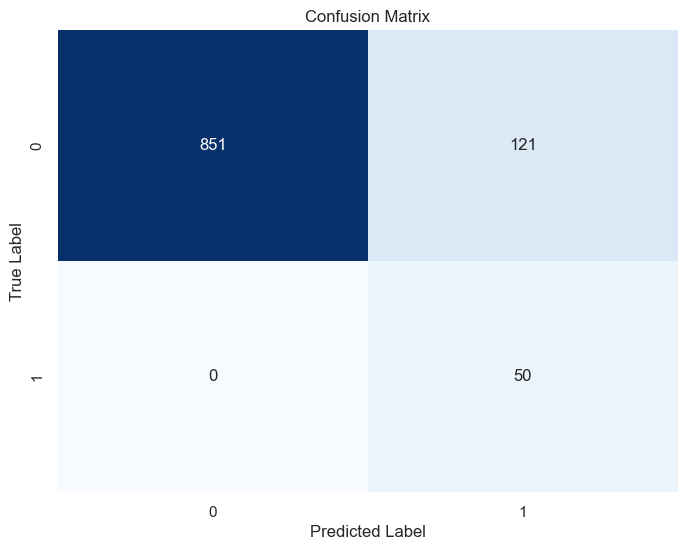

In [164]:
report(model, X_test, y_test)
confusion(model, X_test, y_test, grid=False)

- Very similar (slightly better) results on the test set! The model seems to generalize well.

Let's save it:

In [166]:
with open('model.pkl', 'wb') as f:
    pickle.dump(model, f)

# Suggestions

- Tune the scale pos_weight_parameter
- Implement custom loss function such as focal loss.
- Try to engineer more various interaction features.